In [84]:
import torch
import torchvision
from torch import nn
from tqdm.auto import tqdm # PROGRESS BAR FOR VISUALIZATION
from torchvision import transforms # FOR IMAGE TRANSFORMATIONS AND COMPUTATIONS
from torchvision.datasets import MNIST # DATASET
from torchvision.utils import make_grid # MAKE GRID OF THE IMAGE FOR VISUALIZATION
from torch.utils.data import DataLoader # LOADING DATA AND MANAGING BATCHES
import matplotlib.pyplot as plt # FOR PLOTTING
torch.manual_seed(0) # SET SEED FOR REPRODUCIBILITY TESTING PURPOSE



In [104]:
def show_tensor_images(image_tensor, num_images=25, size=(1,28,28)):  # OIMAGE TENSOR - TO INPUT TENSOR 
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    # DETACH USED WHEN GREADIENT DESCENT IS NO NEEDED AND CPU USED TO MOVE TO CPU - MATPLOT LIB NEED THE TENSOR TO BE IN CPU
    # image_grid = make_grid(image_unflat[:num_images], ncol=5) # MAKE GRID OF THE IMAGE
    # plt.imshow(image_grid.permute(1,2,0).squeeze()) # PERMUTE TO CHANGE THE DIMENSION AND SQUEEZE TO REMOVE THE UNNECESSARY DIMENSION
    # plt.show() # SHOW THE IMAGE

    image_grid = make_grid(image_unflat[:num_images])
    plt.imshow(image_grid.permute(1,2,0).squeeze())
    plt.show()

### GENERATOR

In [105]:
def get_generator_block(input_dim,output_dim):
    return nn.Sequential(
        nn.Linear(input_dim,output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True) # TO INDRODUCE NON LINEAERITY AND TO LEARN MORE COMPLEX FUNCTIONS
    )

In [106]:
def test_gen_block(in_features,out_features,num_test=10000):
    block = get_generator_block(in_features,out_features)

    assert len(block)==3 # CHECK THE BLOCK CONTAINS EXACTLY 3 LAYERS
    assert type(block[0])==nn.Linear 
    assert type(block[1])==nn.BatchNorm1d
    assert type(block[2])==nn.ReLU

    test_input = torch.randn(num_test, in_features) # RANDOM INPUT
    test_output = block(test_input)   # OUTPUT OF THE BLOCK
    assert tuple(test_output.shape) == (num_test, out_features) # CHECK THE OUTPUT SHAPE
    assert test_output.std() > 0.55 # CHECK THE STANDARD DEVIATION
    assert test_output.std() < 0.65 # CHECK THE STANDARD DEVIATION

test_gen_block(25,12)
test_gen_block(15,28)
print("Success")

Success


In [107]:
# GENERATOR BLOCK
class Generator(nn.Module): # GENERATOR CLASS FROM NN MODULE
    def __init__(self,z_dim=10,im_dim=784,hidden_dim=128): # INITIALIZATION OF THE CLASS , Z_DIM - LATENT SPACE DIMENSION, IM_DIM - IMAGE DIMENSION (28*28), HIDDEN_DIM - HIDDEN LAYER DIMENSION
        super(Generator,self).__init__() # INHERITING THE PARENT CLASS
        self.gen = nn.Sequential(        
            get_generator_block(z_dim, hidden_dim), # GENERATOR BLOCK - CREATE A SET OF LAYERS
            get_generator_block(hidden_dim, hidden_dim * 2), 
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),
            nn.Linear(hidden_dim * 8, im_dim),  # FINAL LAYER - OUTPUT LAYER
            nn.Sigmoid() # TO GET THE OUTPUT BETWEEN 0 AND 1
        )

    # def forward(self): # FORWARD FUNCTION TO PASS THE INPUT THROUGH THE LAYERS
    #     return self.gen

    def forward(self, input):
        return self.gen(input)
    
    def get_gen(self): # FUNCTION TO RETURN THE GENERATOR
        return self.gen


In [108]:
# VERIFY GENERATOR CLASS
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen() 
   
    assert len(gen) == 6
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.min() < 0.5, "Don't use a block in your solution"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


In [109]:
# RETURN RANDOM NOISE
# def get_noise(n_samples, z_dim, device='cpu'):
#     return torch.randn(n_samples, z_dim, device=device)

def get_noise(num_images, z_dim, device='cpu'):
    return torch.randn(num_images, z_dim).to(device)

In [110]:
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)
    
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
print("Success!")

Success!


### DISCRIMINATOR

In [111]:
def get_discriminator_block(input_dim, output_dim):
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2, inplace=True)
    )


In [112]:
# VERIFY DISCRIMINATOR
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)
    
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    assert tuple(test_output.shape) == (num_test, out_features)
    
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5

test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


In [113]:
class Discriminator(nn.Module):
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()

        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            nn.Linear(hidden_dim, 1)
        )

    def forward(self, image):
        return self.disc(image)
    
    def get_disc(self):
        return self.disc

In [114]:
def test_discriminator(z_dim, hidden_dim, num_test=100):
    
    disc = Discriminator(z_dim, hidden_dim).get_disc()

    assert len(disc) == 4

    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)
    
    assert not isinstance(disc[-1], nn.Sequential)

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


### TRAINING

- criterion: the loss function <br>
- n_epochs: the number of times you iterate through the entire dataset when training  <br>
- z_dim: the dimension of the noise vector <br>
- display_step: how often to display/visualize the images <br>
- batch_size: the number of images per forward/backward pass <br>
- lr: the learning rate <br>
- device: the device type, here using a GPU (which runs CUDA), not CPU <br>

In [115]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.00001

dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

device = 'cpu'

In [116]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [117]:
# GRADED FUNCTION:
# def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device): # FUNCTION TO CALCULATE THE DISCRIMINATOR LOSS

#     noise = get_noise(num_images, z_dim, device=device) # GENERATE RANDOM NOISE TO FEED INTO THE GENERATOR
#     fake_images = gen(noise) # GENERATE FAKE IMAGES USING THE GENERATOR WITH THE NOISE
#     disc_fake_pred = disc(fake_images.detach()) # PREDICT IF THE FAKE IMAGES ARE REAL OR FAKE USING THE DISCRIMINATOR
#     ground_truth_fake = torch.zeros_like(disc_fake_pred) # CREATE LABELS OF ZEROS (FAKE) FOR THE PREDICTIONS  
#     disc_fake_loss = criterion(disc_fake_pred, ground_truth_fake) # CALCULATE THE LOSS FOR THE FAKE IMAGE PREDICTIONS
#     disc_real_pred = disc(real) # PREDICT IF THE REAL IMAGES ARE REAL OR FAKE USING THE DISCRIMINATOR
#     ground_truth_real = torch.ones_like(disc_real_pred) # CREATE LABELS OF ONES (REAL) FOR THE PREDICTIONS
#     disc_real_loss = criterion(disc_real_pred, ground_truth_real) # CALCULATE THE LOSS FOR THE REAL IMAGE PREDICTIONS
#     disc_loss = (disc_fake_loss + disc_real_loss) / 2  # AVERAGE THE LOSSES FROM THE REAL AND FAKE IMAGE PREDICTIONS
#     return disc_loss # RETURN THE AVERAGED LOSS

def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    
    # GENERATE RANDOM NOISE TO FEED INTO THE GENERATOR
    noise = get_noise(num_images, z_dim, device=device)
    
    # GENERATE FAKE IMAGES USING THE GENERATOR WITH THE NOISE
    fake_images = gen(noise)
    
    # PREDICT IF THE FAKE IMAGES ARE REAL OR FAKE USING THE DISCRIMINATOR
    disc_fake_pred = disc(fake_images.detach())
    
    # CREATE LABELS OF ZEROS (FAKE) FOR THE PREDICTIONS
    ground_truth_fake = torch.zeros_like(disc_fake_pred)
    
    # CALCULATE THE LOSS FOR THE FAKE IMAGE PREDICTIONS
    disc_fake_loss = criterion(disc_fake_pred, ground_truth_fake)
    
    # PREDICT IF THE REAL IMAGES ARE REAL OR FAKE USING THE DISCRIMINATOR
    disc_real_pred = disc(real)
    
    # CREATE LABELS OF ONES (REAL) FOR THE PREDICTIONS
    ground_truth_real = torch.ones_like(disc_real_pred)
    
    # CALCULATE THE LOSS FOR THE REAL IMAGE PREDICTIONS
    disc_real_loss = criterion(disc_real_pred, ground_truth_real)
    
    # AVERAGE THE LOSSES FROM THE REAL AND FAKE IMAGE PREDICTIONS
    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    
    # RETURN THE AVERAGED LOSS
    return disc_loss



In [118]:
def test_disc_reasonable(num_images=10):
    import inspect, re
    lines = inspect.getsource(get_disc_loss)
    assert (re.search(r"to\(.cuda.\)", lines)) is None
    assert (re.search(r"\.cuda\(\)", lines)) is None
    
    z_dim = 64
    gen = torch.zeros_like
    disc = lambda x: x.mean(1)[:, None]
    criterion = torch.mul # Multiply
    real = torch.ones(num_images, z_dim)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(disc_loss.mean() - 0.5) < 1e-5)
    
    gen = torch.ones_like
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, z_dim)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu')) < 1e-5)
    
    gen = lambda x: torch.ones(num_images, 10)
    disc = lambda x: x.mean(1)[:, None] + 10
    criterion = torch.mul # Multiply
    real = torch.zeros(num_images, 10)
    assert torch.all(torch.abs(get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu').mean() - 5) < 1e-5)

    gen = torch.ones_like
    disc = nn.Linear(64, 1, bias=False)
    real = torch.ones(num_images, 64) * 0.5
    disc.weight.data = torch.ones_like(disc.weight.data) * 0.5
    disc_opt = torch.optim.Adam(disc.parameters(), lr=0.01)
    criterion = lambda x, y: torch.sum(x) + torch.sum(y)
    disc_loss = get_disc_loss(gen, disc, criterion, real, num_images, z_dim, 'cpu').mean()
    disc_loss.backward()
    assert torch.isclose(torch.abs(disc.weight.grad.mean() - 11.25), torch.tensor(3.75))


def test_disc_loss(max_tests=10):
    z_dim = 64
    device = 'cpu'
    lr = 0.01
    dataloader = [(torch.randn(32, 1, 28, 28), None) for _ in range(100)]
    criterion = nn.BCELoss()

    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device)
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    num_steps = 0
    for real, _ in dataloader:
        cur_batch_size = len(real)
        real = real.view(cur_batch_size, -1).to(device)

        disc_opt.zero_grad()

        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)
        print(f"Discriminator loss: {disc_loss.item()}")  # Debug print
        assert (disc_loss - 0.68).abs() < 0.05

        disc_loss.backward(retain_graph=True)

        # Check if any generator's parameter has gradients
        gen_params_have_grads = all(p.grad is None for p in gen.parameters())
        assert gen_params_have_grads

        old_weight = disc.disc[0].weight.data.clone()
        disc_opt.step()
        new_weight = disc.disc[0].weight.data
        
        assert not torch.all(torch.eq(old_weight, new_weight))
        num_steps += 1
        if num_steps >= max_tests:
            break



test_disc_reasonable()
# test_disc_loss()
print("Success!")    
    

Success!


In [119]:
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    
    noise = get_noise(num_images, z_dim, device=device)
    fake_images = gen(noise)
    disc_fake_pred = disc(fake_images)
    ground_truth = torch.ones_like(disc_fake_pred)
    gen_loss = criterion(disc_fake_pred, ground_truth)
    
    return gen_loss

In [120]:
def test_gen_reasonable(num_images=10):
    import inspect, re
    lines = inspect.getsource(get_gen_loss)
    assert (re.search(r"to\(.cuda.\)", lines)) is None
    assert (re.search(r"\.cuda\(\)", lines)) is None
    
    z_dim = 64
    gen = torch.zeros_like
    disc = nn.Identity()
    criterion = torch.mul 
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor) < 1e-5)
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)

    gen = torch.ones_like
    disc = nn.Identity()
    criterion = torch.mul 
    gen_loss_tensor = get_gen_loss(gen, disc, criterion, num_images, z_dim, 'cpu')
    assert torch.all(torch.abs(gen_loss_tensor - 1) < 1e-5)
    assert tuple(gen_loss_tensor.shape) == (num_images, z_dim)
    

def test_gen_loss(num_images):
    z_dim = 64
    gen = Generator(z_dim).to(device)
    gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
    disc = Discriminator().to(device) 
    disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)
    
    gen_loss = get_gen_loss(gen, disc, criterion, num_images, z_dim, device)
    
    assert (gen_loss - 0.7).abs() < 0.1
    gen_loss.backward()
    old_weight = gen.gen[0][0].weight.clone()
    gen_opt.step()
    new_weight = gen.gen[0][0].weight
    assert not torch.all(torch.eq(old_weight, new_weight))


test_gen_reasonable(10)
# test_gen_loss(18)
print("Success!")

Success!


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 1.4266727836132043, discriminator loss: 0.4182015069723129


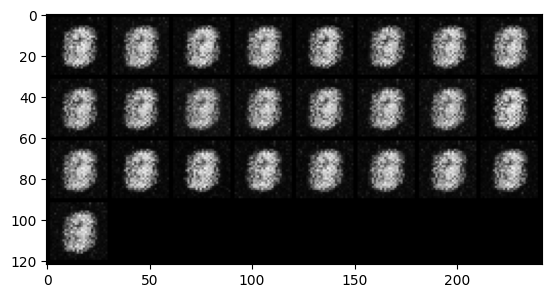

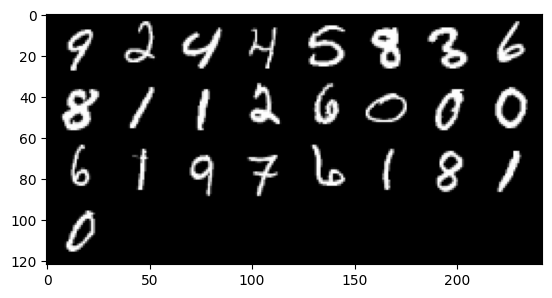

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 1.7759911472797385, discriminator loss: 0.27176582798361754


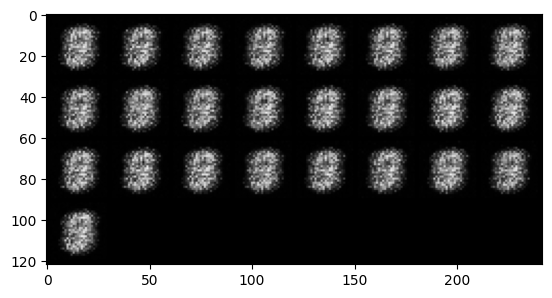

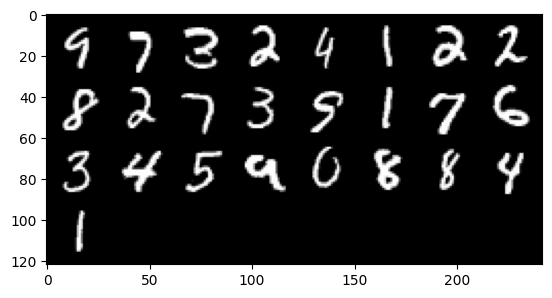

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 2.0728110961914052, discriminator loss: 0.15688359054923035


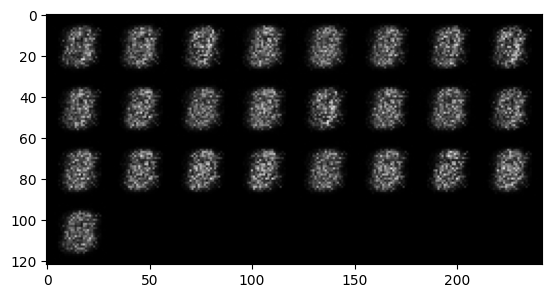

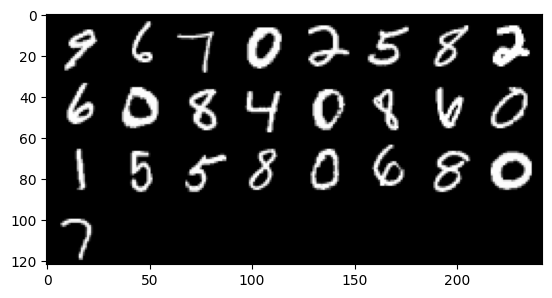

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 1.7694143824577324, discriminator loss: 0.20358103016018886


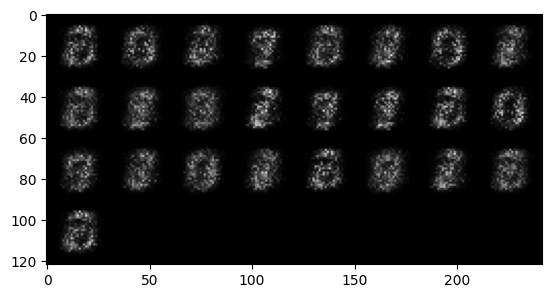

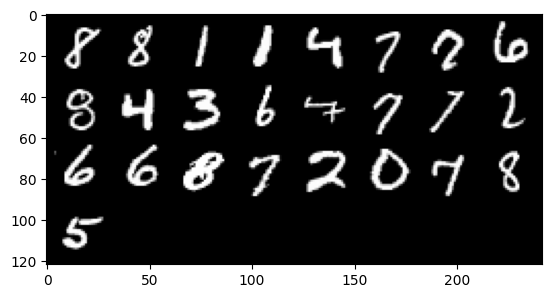

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 1.676219990730288, discriminator loss: 0.20987720596790344


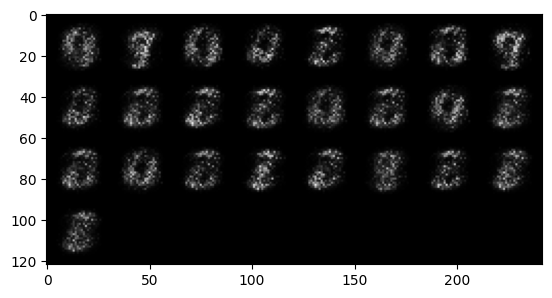

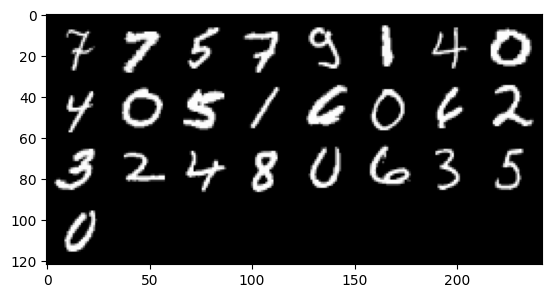

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 1.9163166949749, discriminator loss: 0.17378150735795503


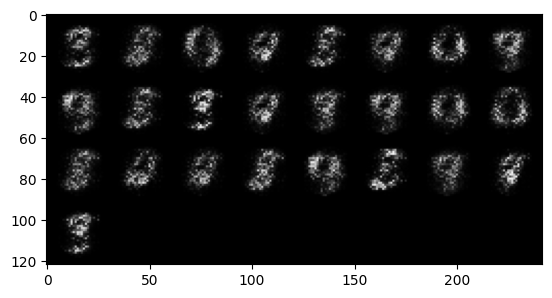

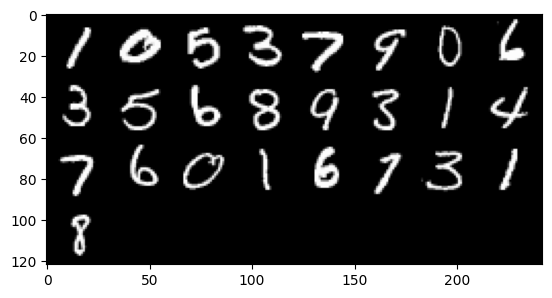

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 2.3430185656547544, discriminator loss: 0.13779506818950168


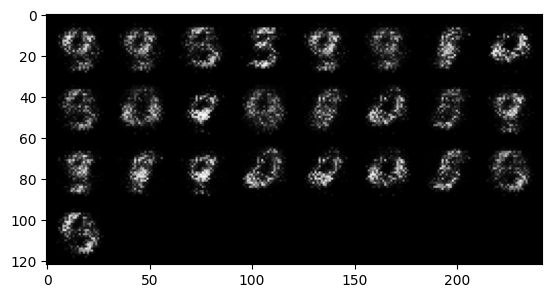

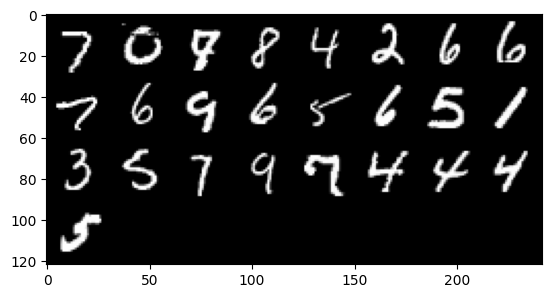

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.7528686366081208, discriminator loss: 0.10973210890591148


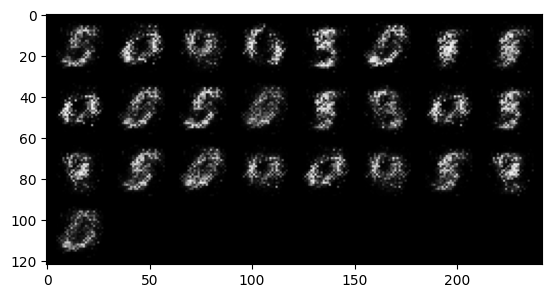

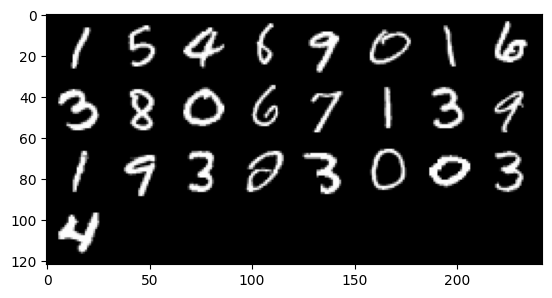

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 3.1540243821144136, discriminator loss: 0.09068873347342013


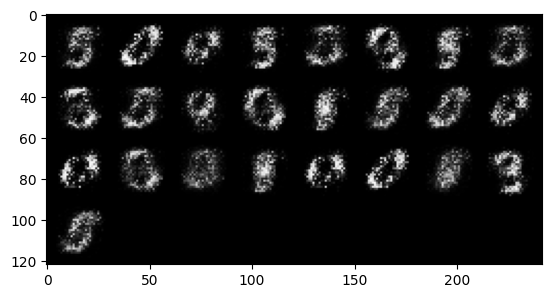

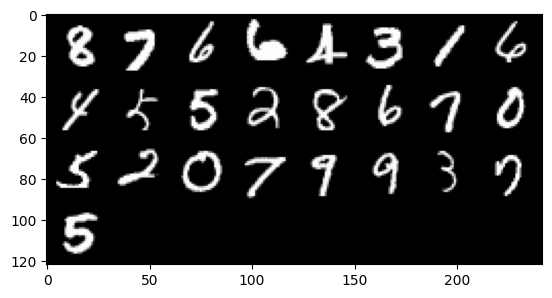

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 3.5724008798599267, discriminator loss: 0.07464161643385893


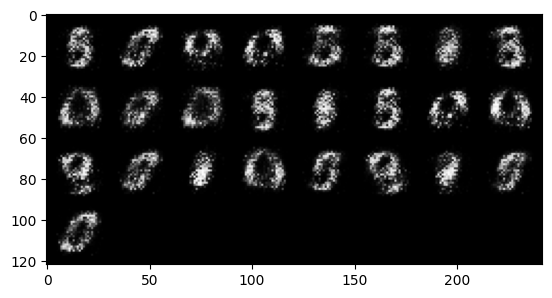

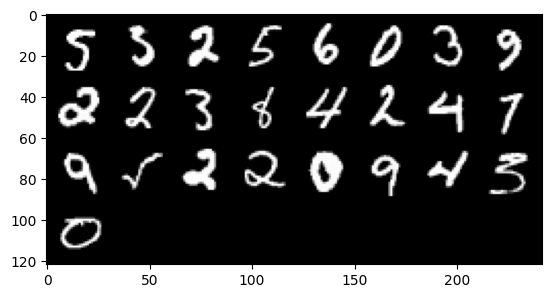

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 3.5830751800537146, discriminator loss: 0.06878013298660514


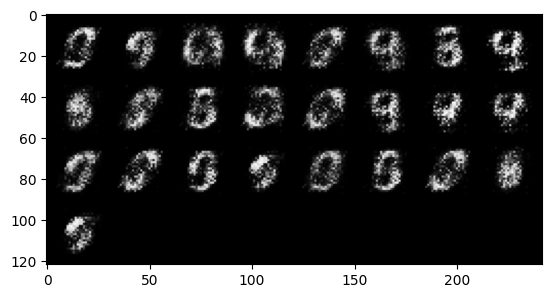

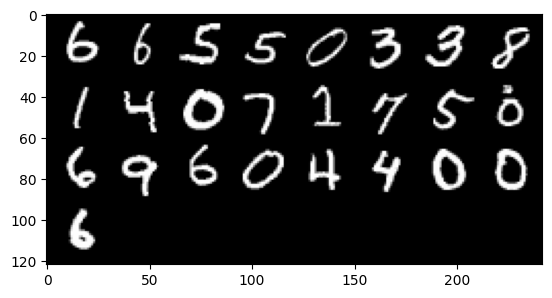

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 3.8648654503822346, discriminator loss: 0.06757193730026478


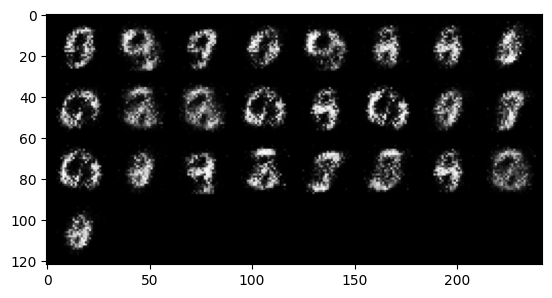

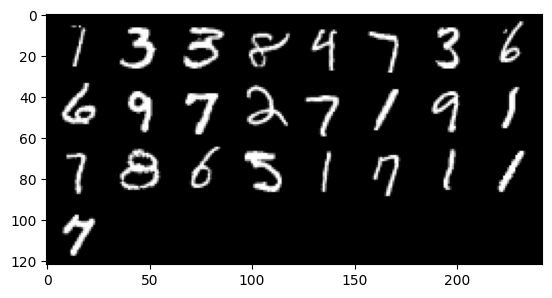

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 3.869098253726961, discriminator loss: 0.06262458154559132


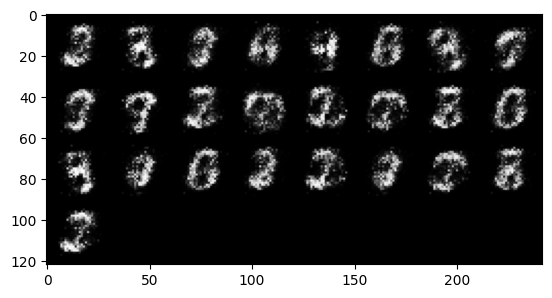

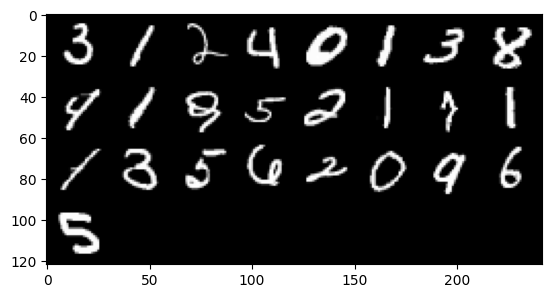

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 4.042609467506412, discriminator loss: 0.053866931576281814


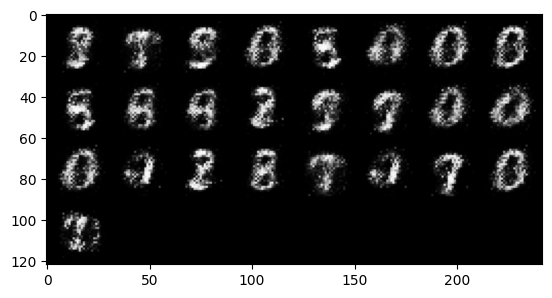

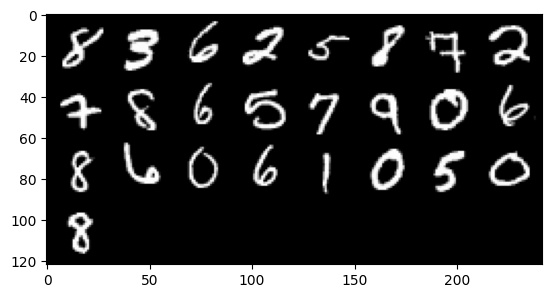

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 4.061417400360108, discriminator loss: 0.057991455506533396


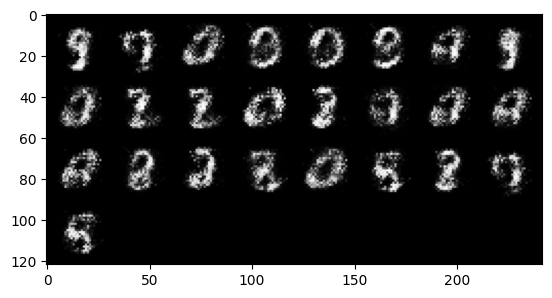

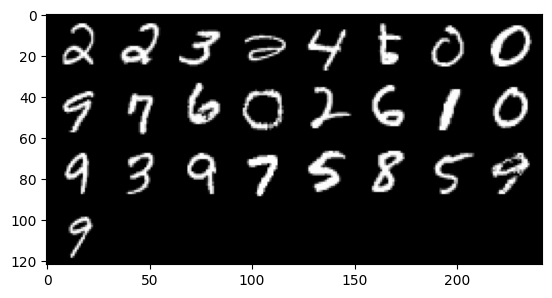

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 4.060324086189274, discriminator loss: 0.06194113380461929


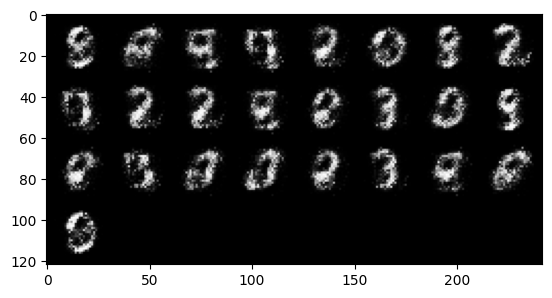

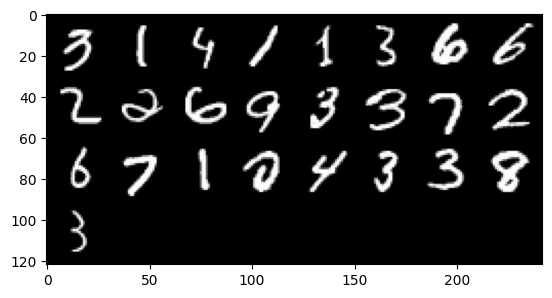

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 3.9238569836616506, discriminator loss: 0.061553887657821195


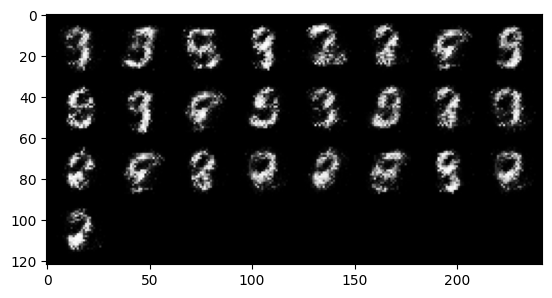

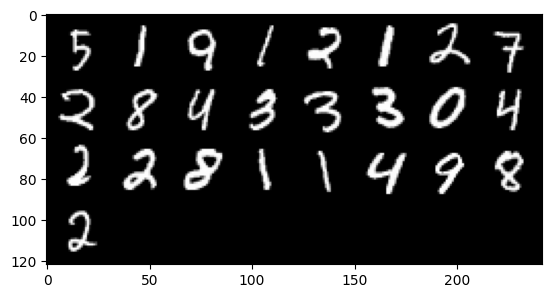

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 4.002448928356171, discriminator loss: 0.06125244309008124


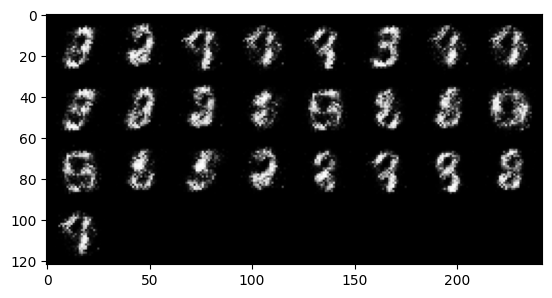

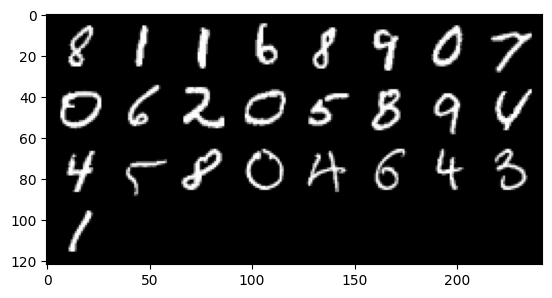

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 3.920912628650661, discriminator loss: 0.07059787874668838


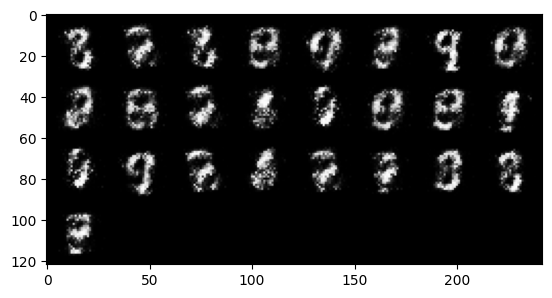

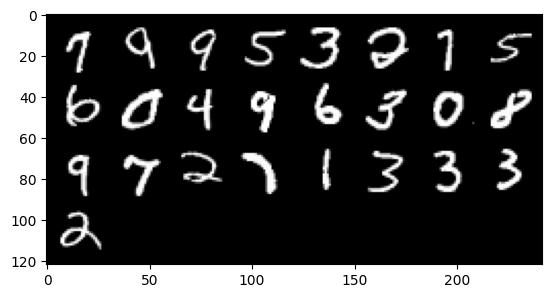

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 4.044896336078642, discriminator loss: 0.07033708633482455


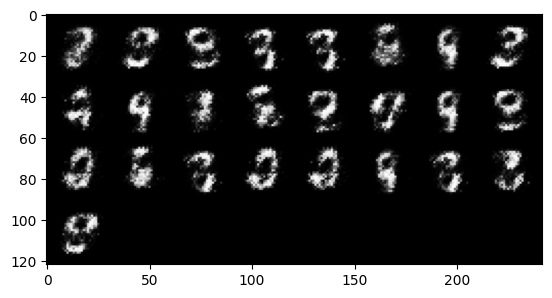

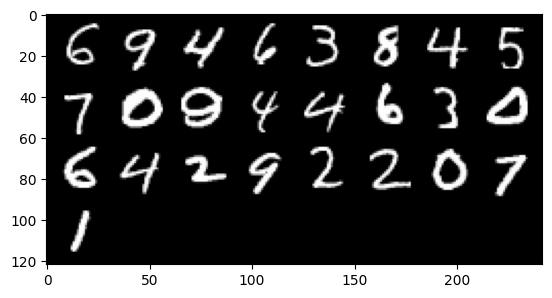

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 3.8436340570449805, discriminator loss: 0.07024733842164278


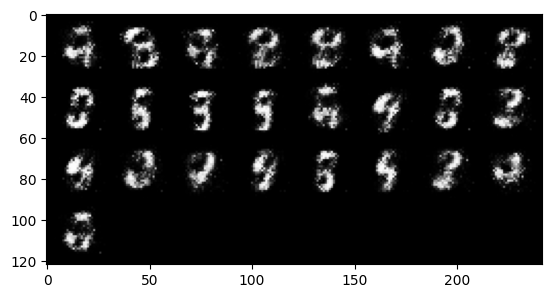

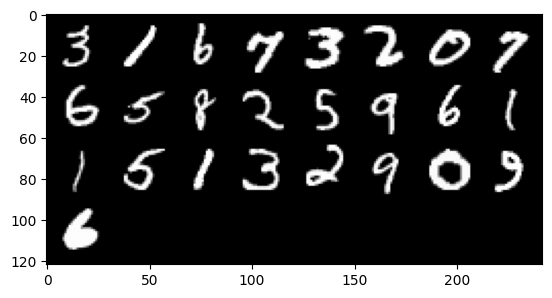

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 3.7752252449989316, discriminator loss: 0.07752085299044849


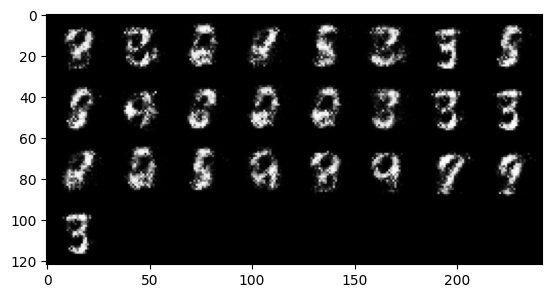

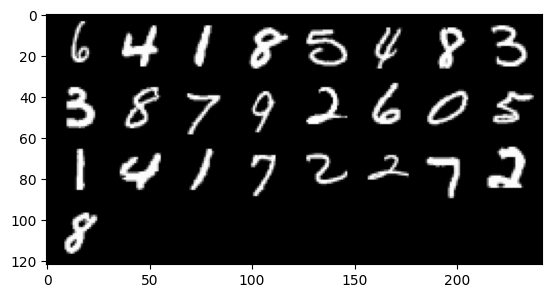

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 3.9166759138107294, discriminator loss: 0.07212884453684097


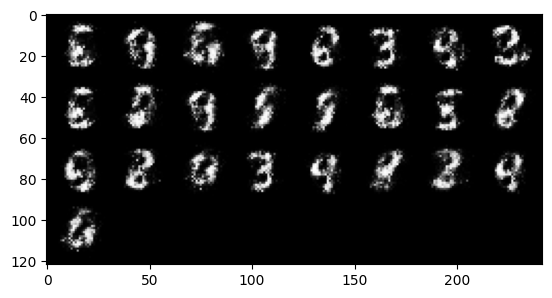

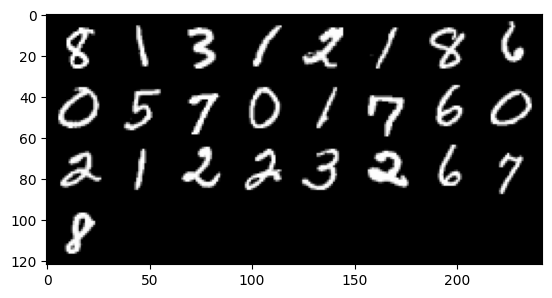

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 4.000420440196991, discriminator loss: 0.07358328369259841


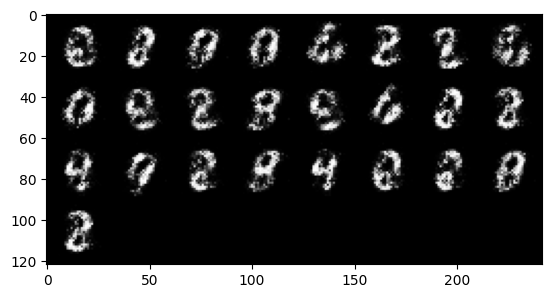

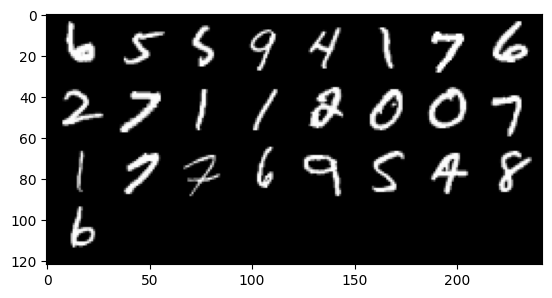

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 3.7876825318336462, discriminator loss: 0.07889546418190004


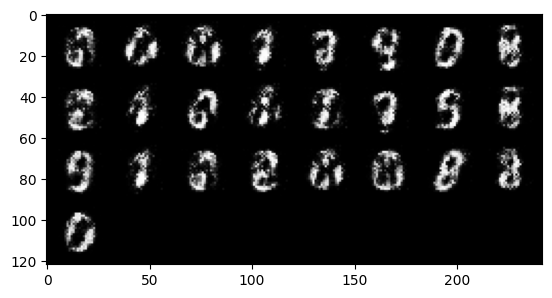

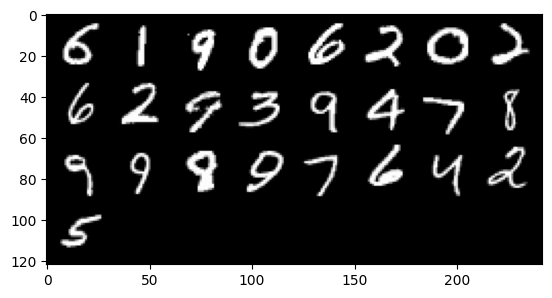

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 3.80792407226563, discriminator loss: 0.0828972190469503


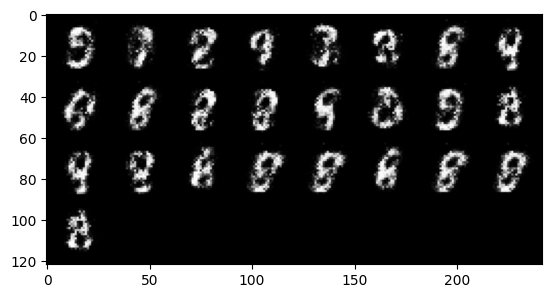

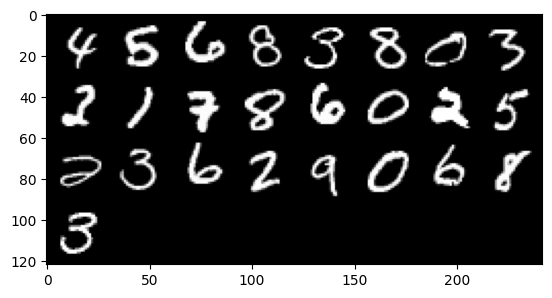

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 3.8191480827331565, discriminator loss: 0.08227453671395776


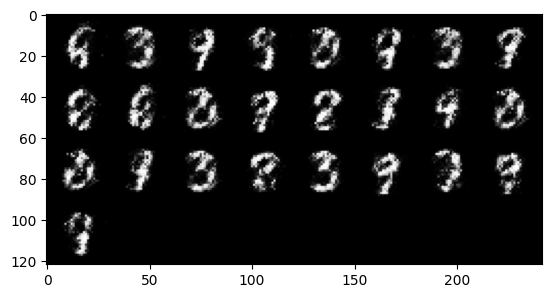

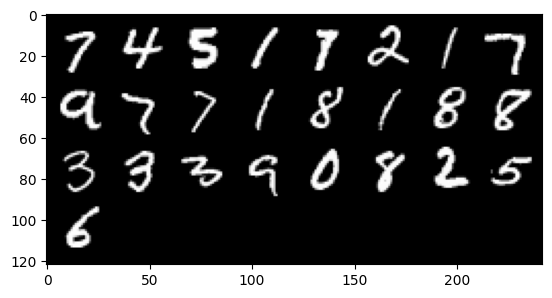

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 3.8259976487159766, discriminator loss: 0.08027684593945741


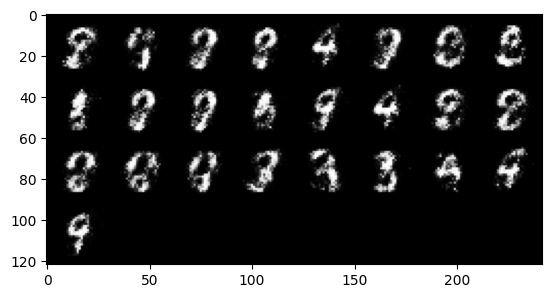

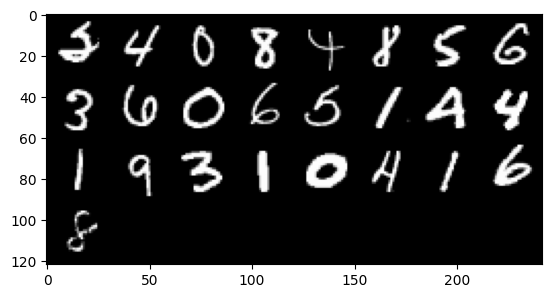

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 3.8329120125770526, discriminator loss: 0.09017025412619112


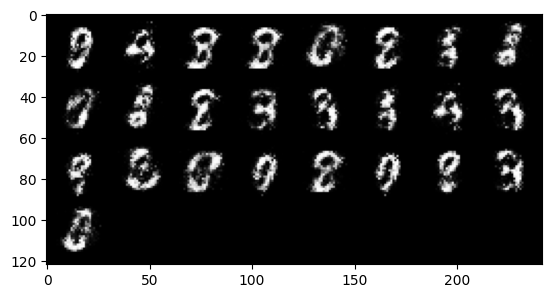

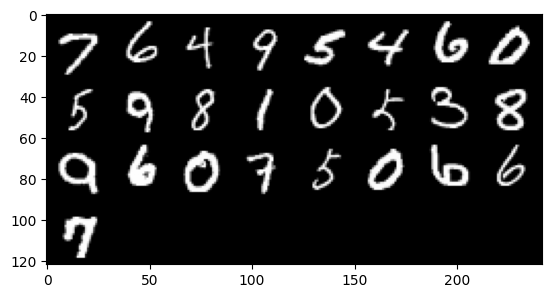

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 3.9071850762367237, discriminator loss: 0.0948271977379918


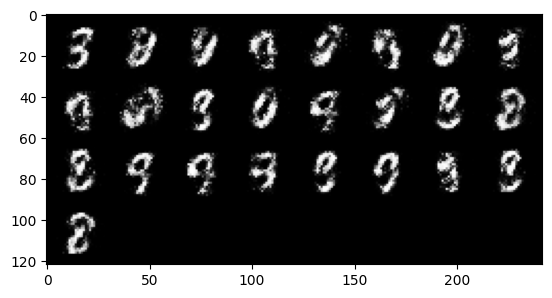

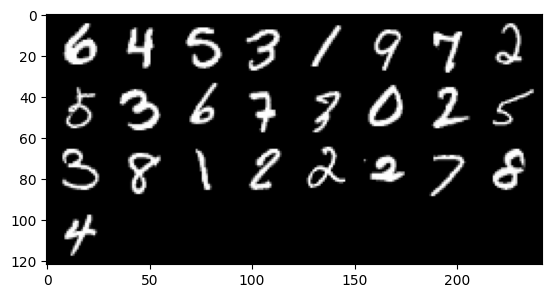

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 3.799897894382479, discriminator loss: 0.10593423427641392


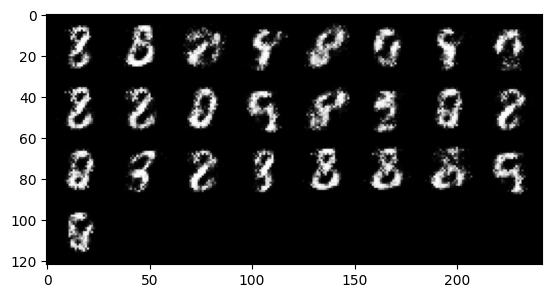

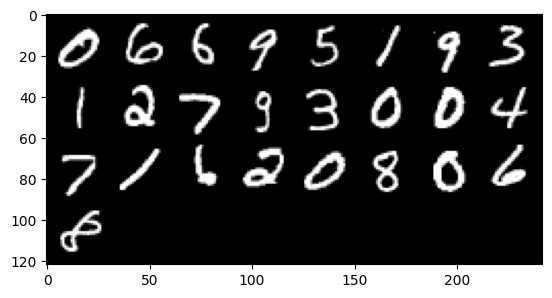

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 3.7113376131057763, discriminator loss: 0.10679039406776432


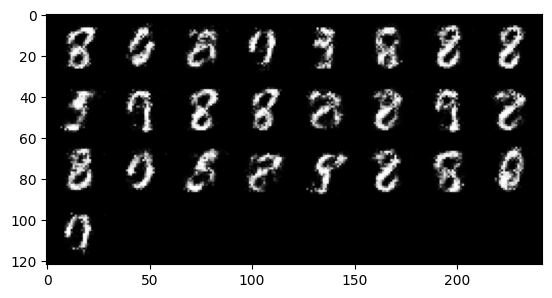

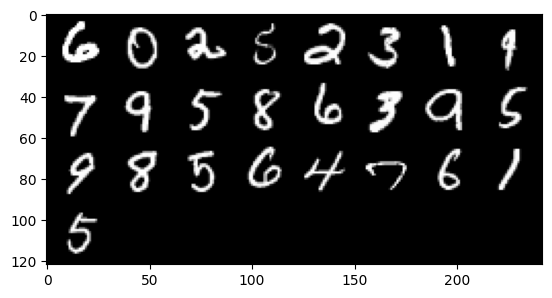

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 3.837062771320342, discriminator loss: 0.10862536101788292


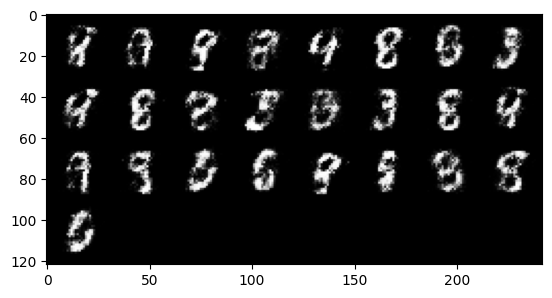

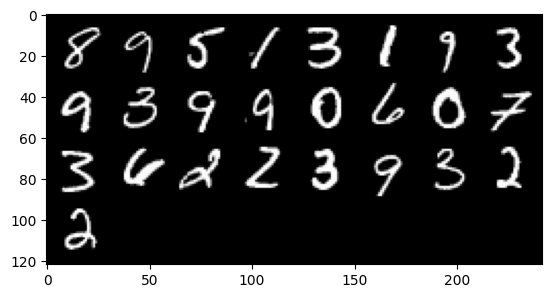

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 3.65696917152405, discriminator loss: 0.12175914574414493


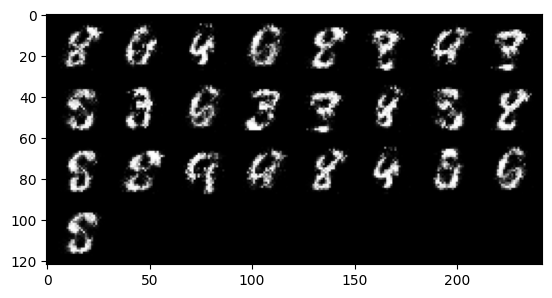

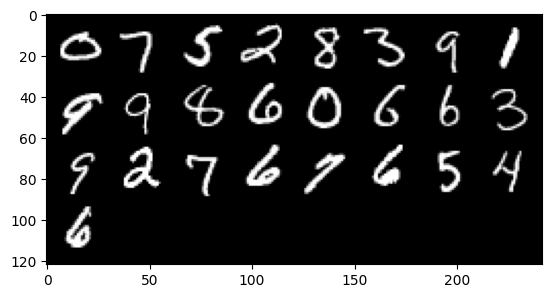

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 3.841774340629576, discriminator loss: 0.1103777335882188


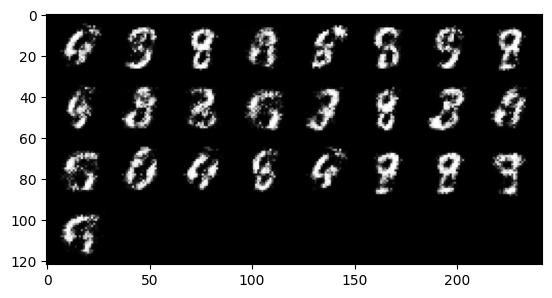

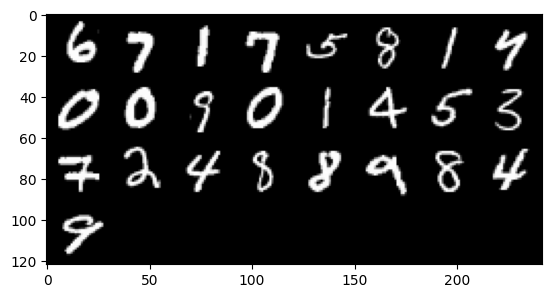

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 3.7362832040786738, discriminator loss: 0.11301540084928281


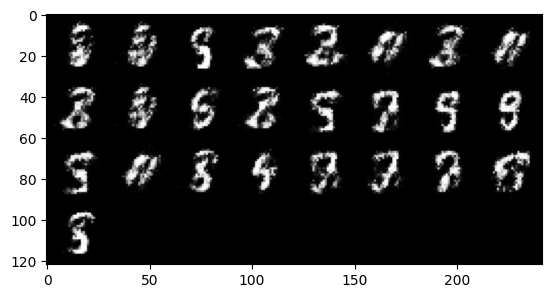

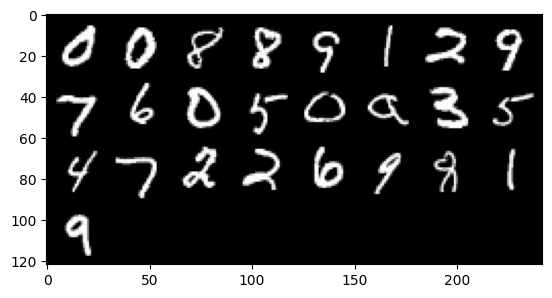

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 3.833907853603363, discriminator loss: 0.10212999218702314


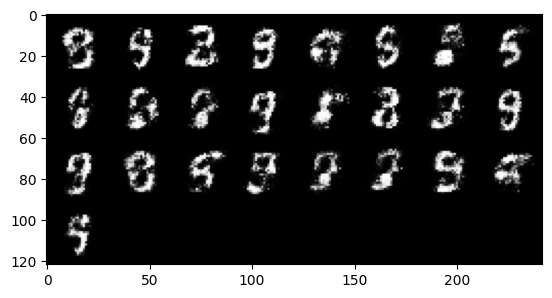

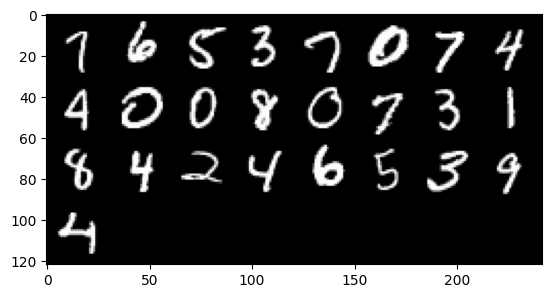

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 3.7487353835105863, discriminator loss: 0.10284876692295082


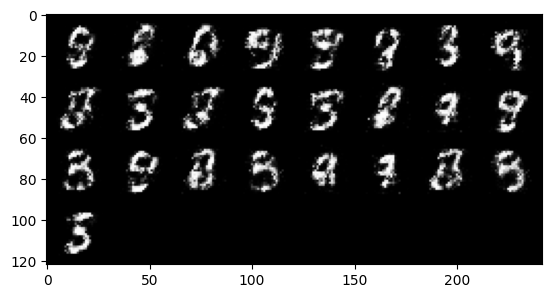

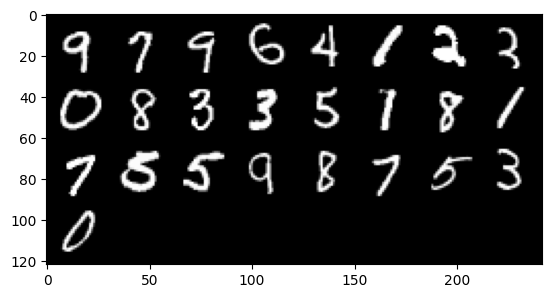

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 3.6275032110214256, discriminator loss: 0.12843632043153053


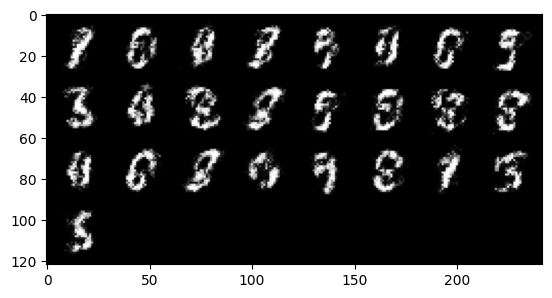

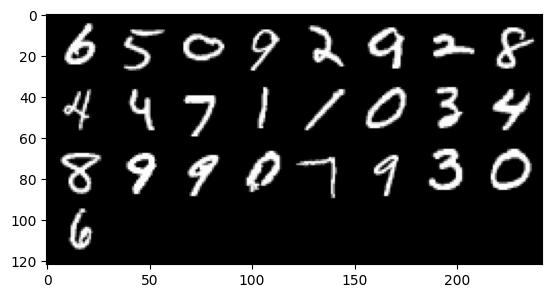

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 3.4534661102294932, discriminator loss: 0.1579760088622569


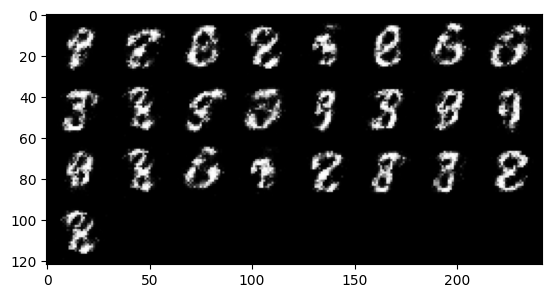

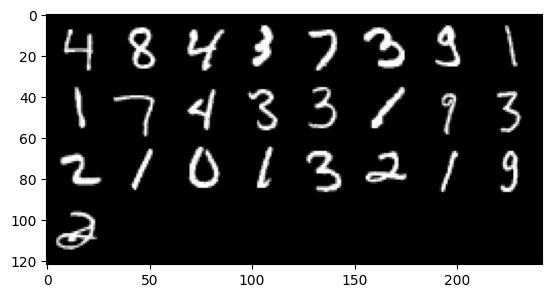

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 3.495905057907104, discriminator loss: 0.1450749409496782


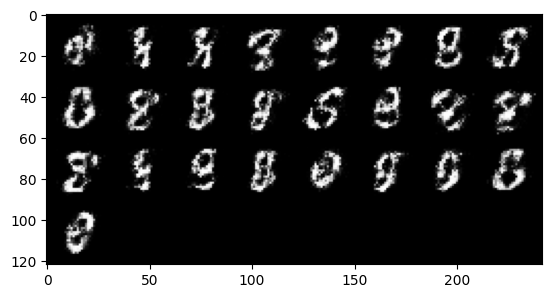

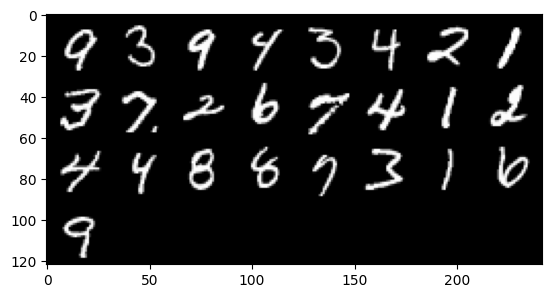

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 3.3541559553146354, discriminator loss: 0.17943908791244031


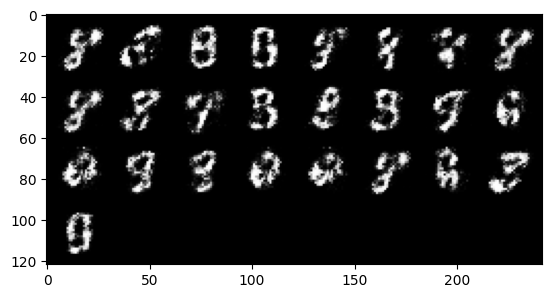

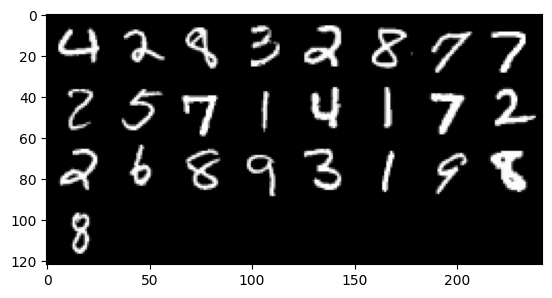

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 3.339883023738859, discriminator loss: 0.16943581727147086


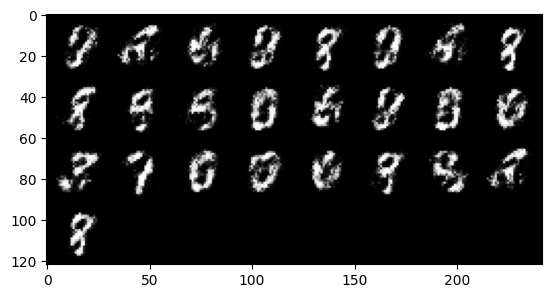

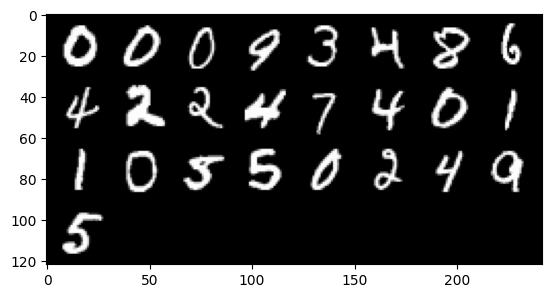

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 3.3962648944854754, discriminator loss: 0.15997235000133508


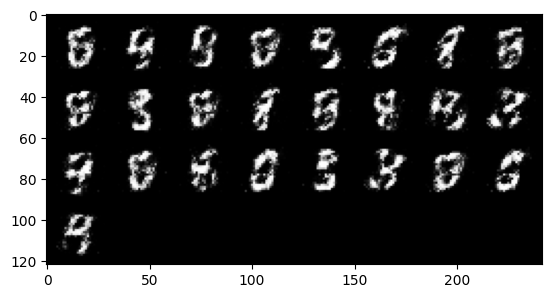

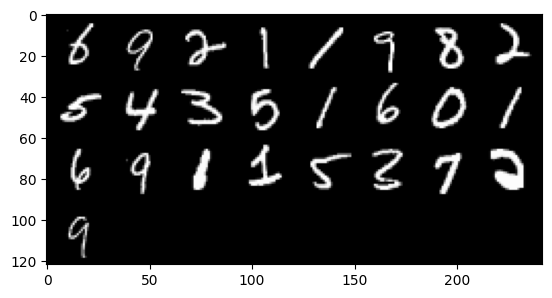

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 3.3379386916160607, discriminator loss: 0.14425067737698563


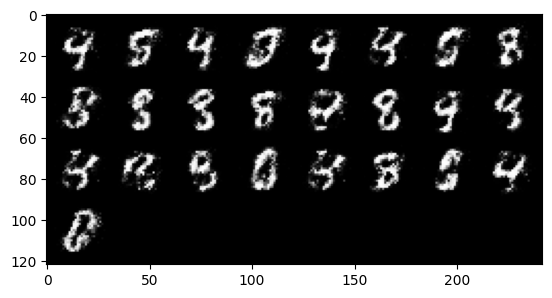

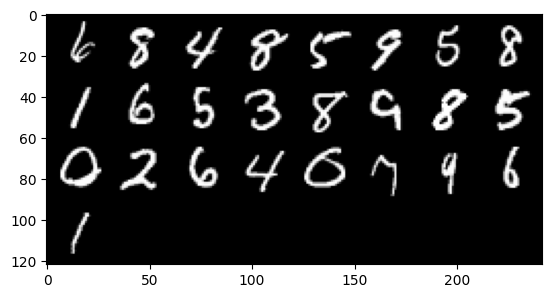

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 3.393319801807403, discriminator loss: 0.160129944384098


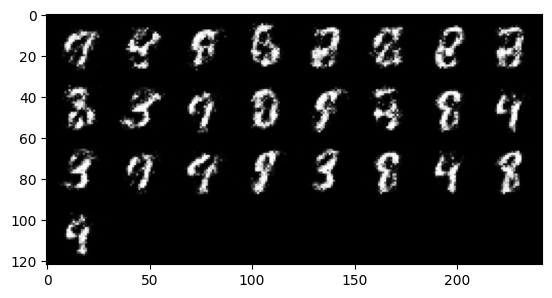

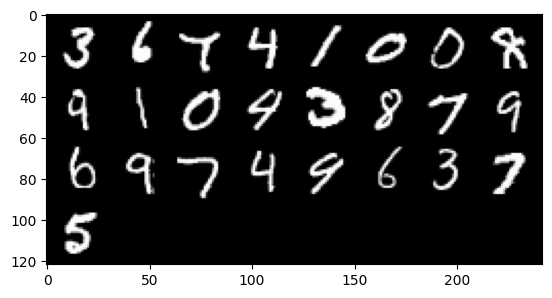

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 3.2403153285980237, discriminator loss: 0.17532726916670788


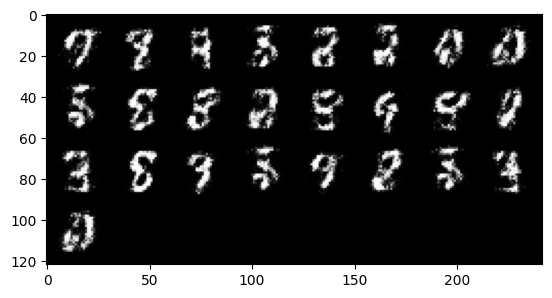

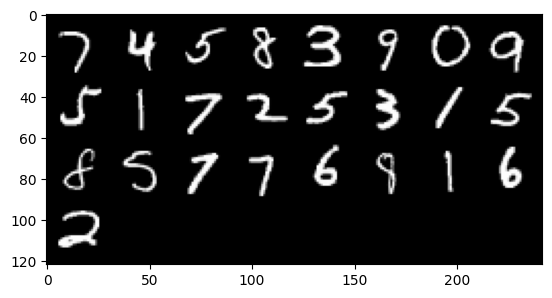

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 3.11811260032654, discriminator loss: 0.1693824398964644


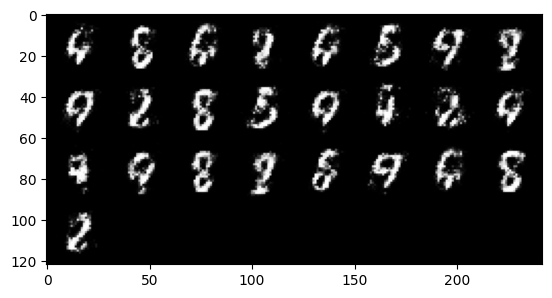

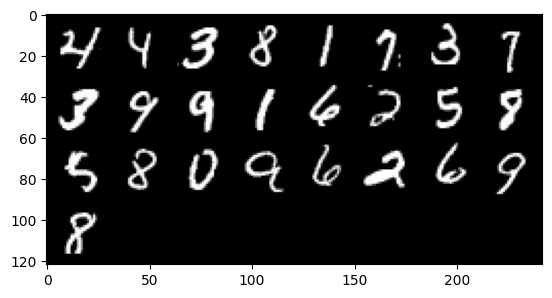

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 3.008419522285463, discriminator loss: 0.19513323900103566


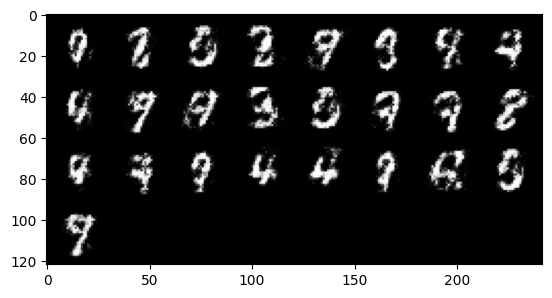

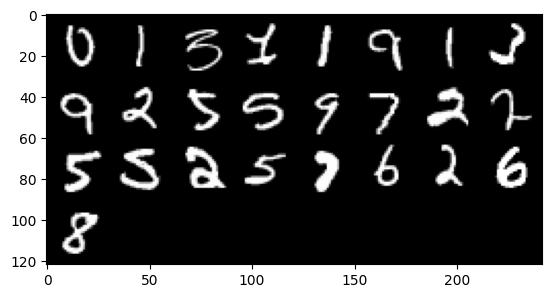

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 3.0403861103057874, discriminator loss: 0.18726147471368298


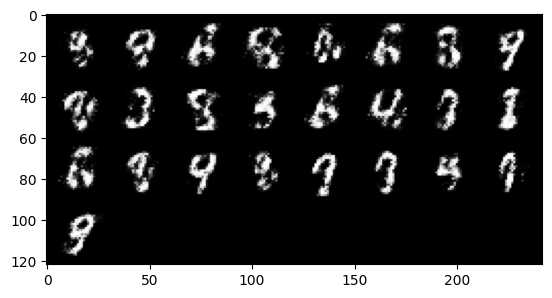

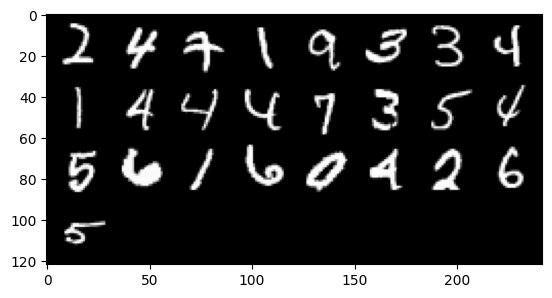

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 3.012900295257567, discriminator loss: 0.1848263300210238


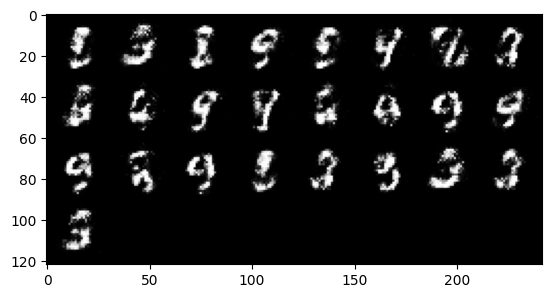

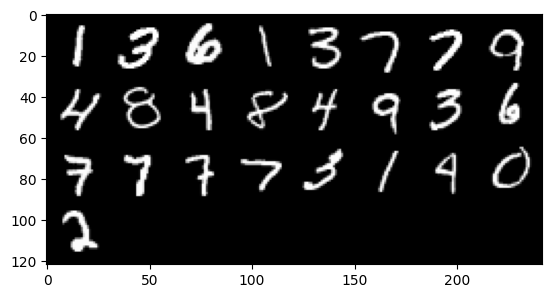

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 3.050635889530182, discriminator loss: 0.1958269707560539


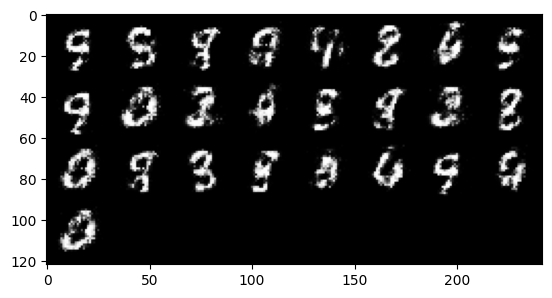

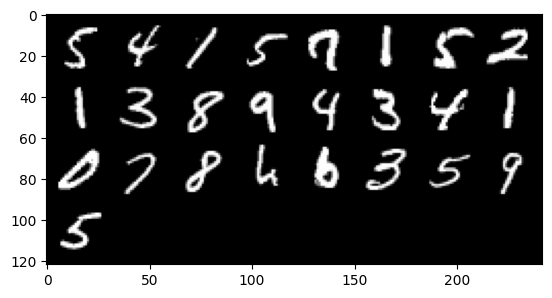

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 2.942780149936673, discriminator loss: 0.21346810500323773


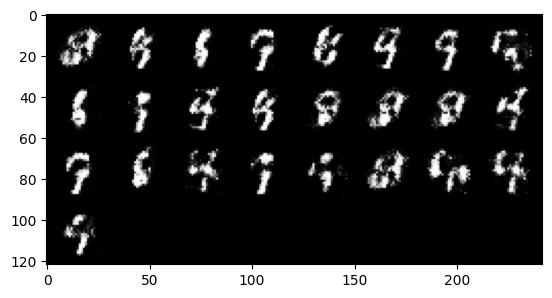

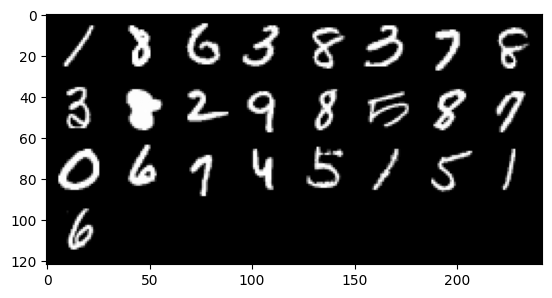

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 3.0644726524353003, discriminator loss: 0.1843901387304066


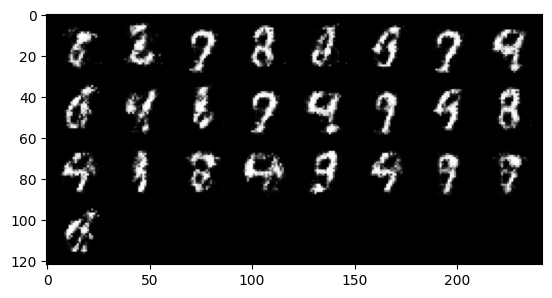

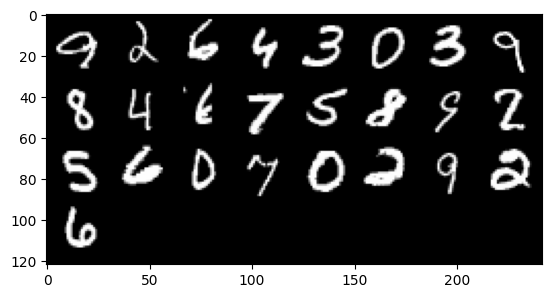

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 2.8942586174011233, discriminator loss: 0.2107806858718396


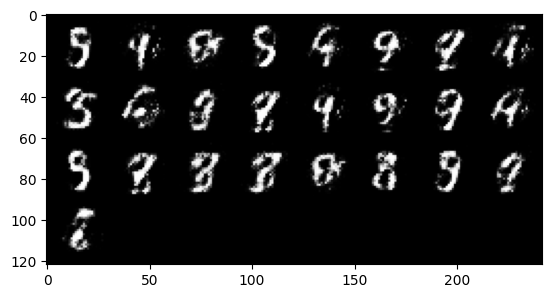

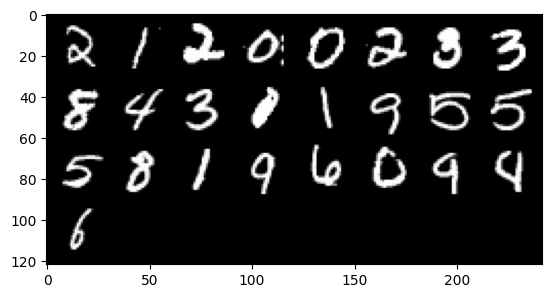

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 2.9419026861190787, discriminator loss: 0.19241300146281734


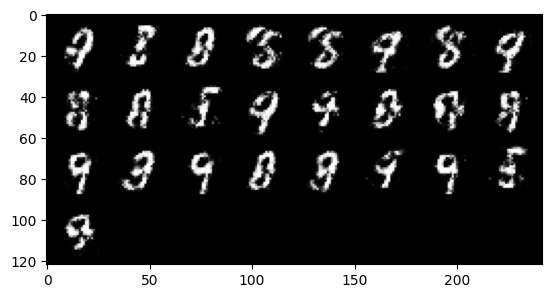

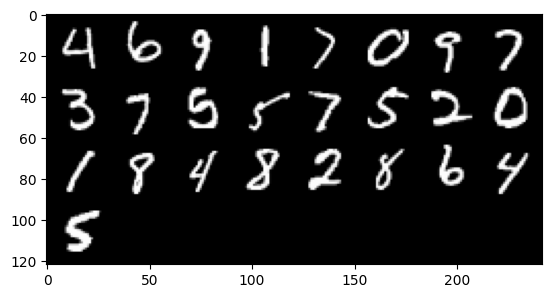

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 2.9343372879028324, discriminator loss: 0.20664795161783694


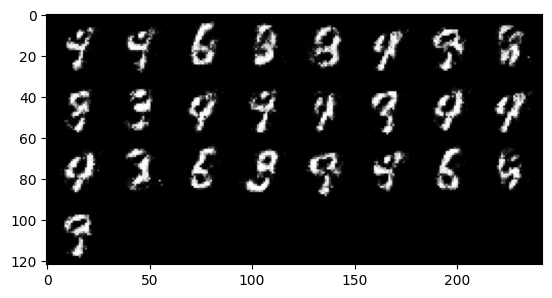

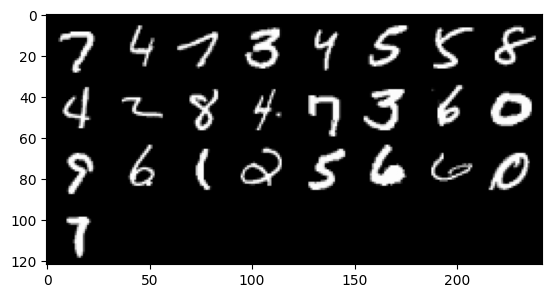

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 2.806406459331513, discriminator loss: 0.2140154833644628


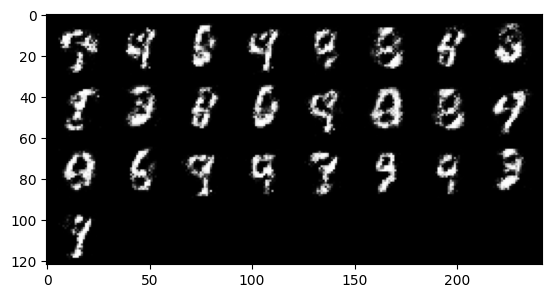

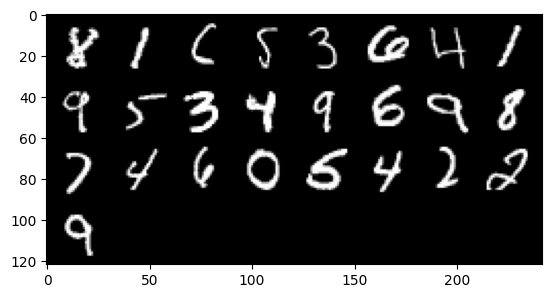

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 2.8372929167747456, discriminator loss: 0.21126792632043365


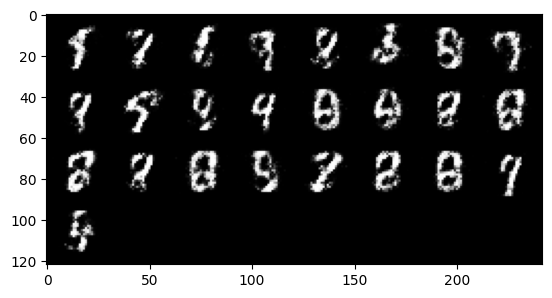

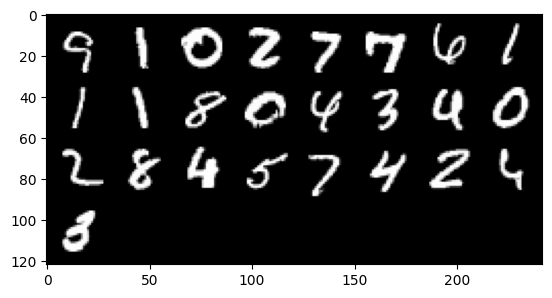

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 2.640154657840727, discriminator loss: 0.23819613170623766


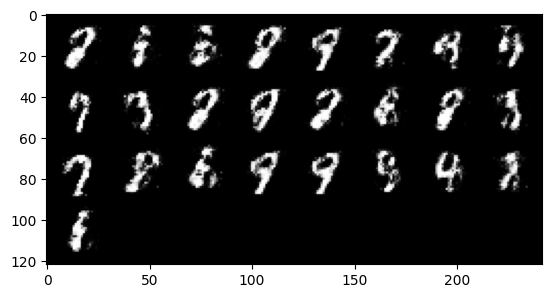

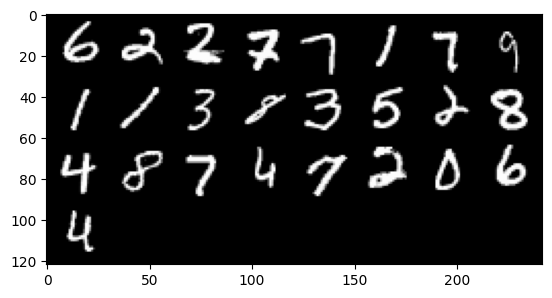

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 2.6859661598205555, discriminator loss: 0.2136127641499042


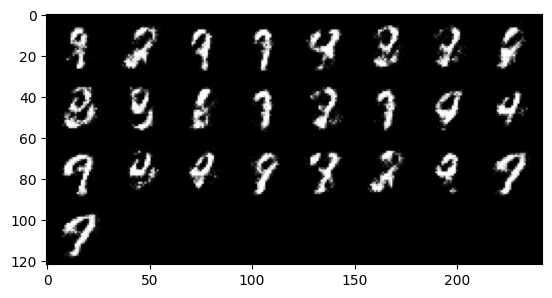

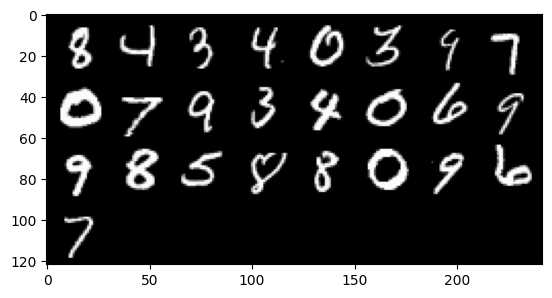

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 2.580130784511568, discriminator loss: 0.23763864696025858


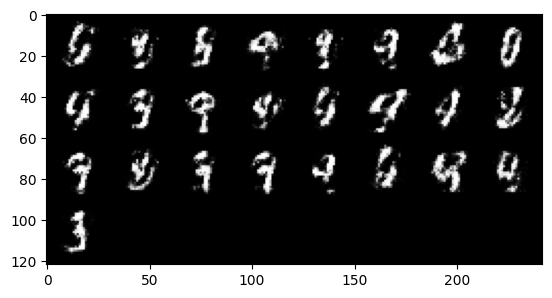

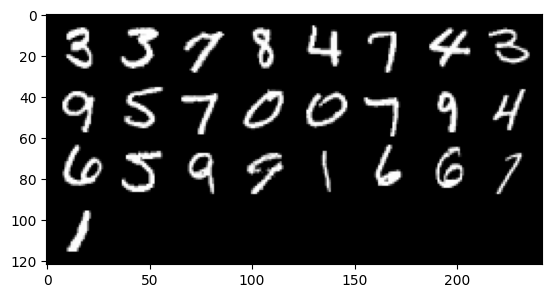

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 2.6353539881706234, discriminator loss: 0.2324846367537976


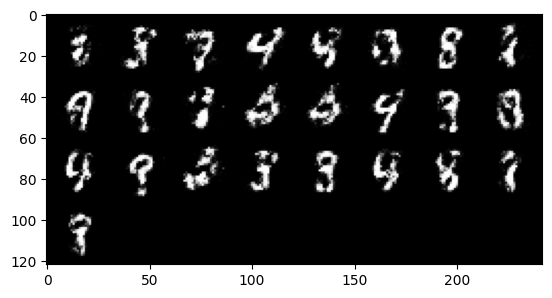

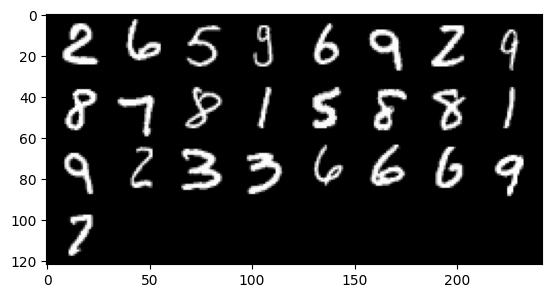

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 2.5762269372940074, discriminator loss: 0.23565855488181092


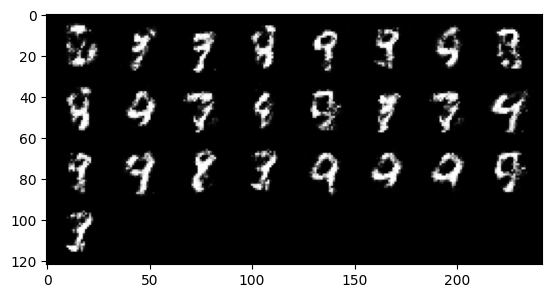

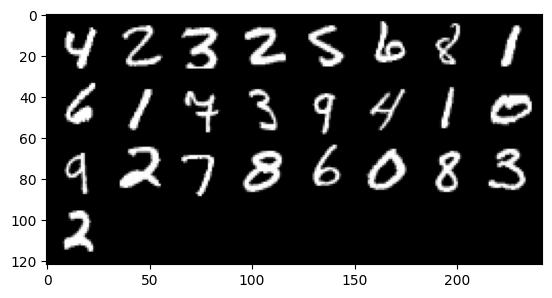

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 2.6705230650901806, discriminator loss: 0.23038400141894805


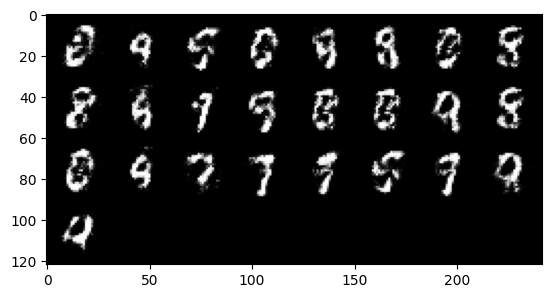

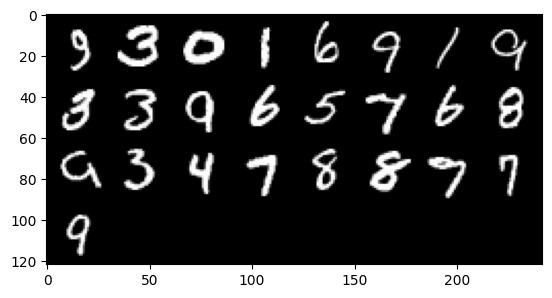

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 2.506644797801975, discriminator loss: 0.26066641879081726


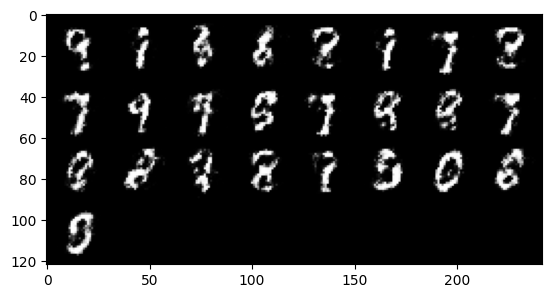

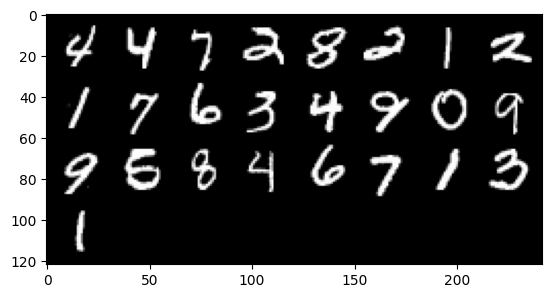

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 2.420315278768539, discriminator loss: 0.2652235095798969


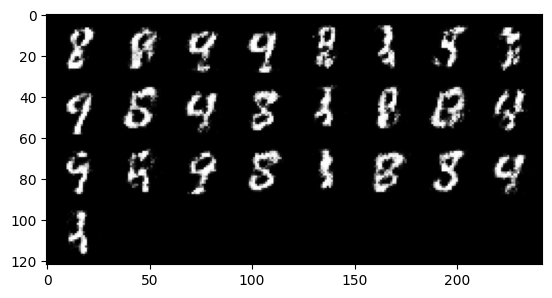

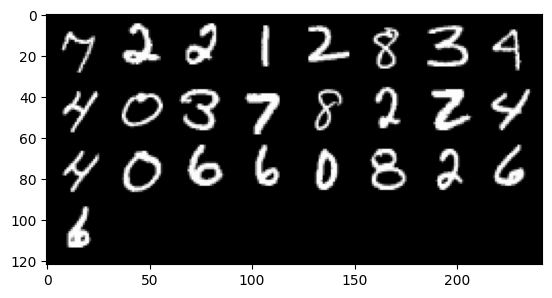

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 2.488569118261335, discriminator loss: 0.25654142567515353


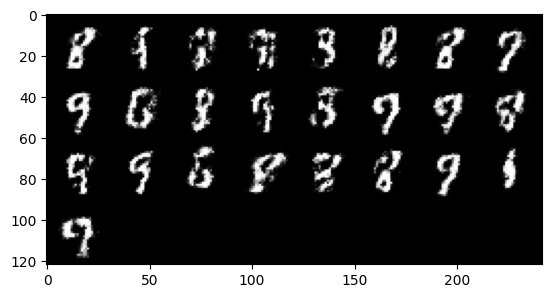

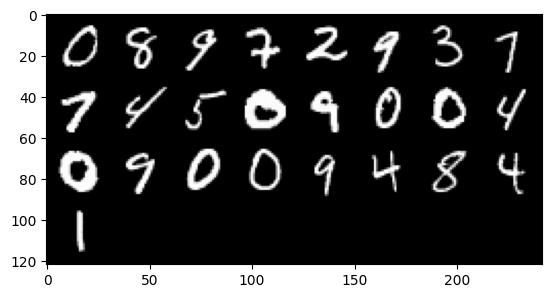

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 2.4558953313827487, discriminator loss: 0.2613876946866511


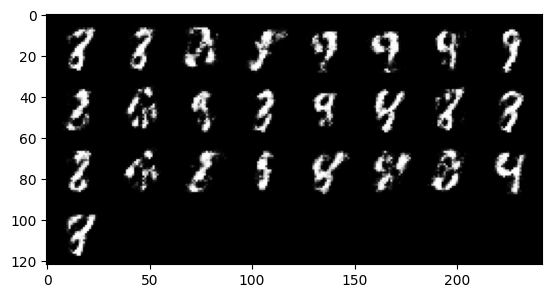

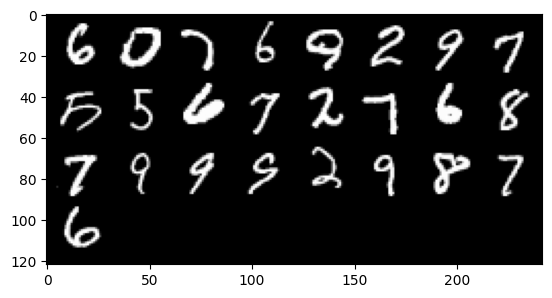

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 2.3455694341659554, discriminator loss: 0.2796322025060651


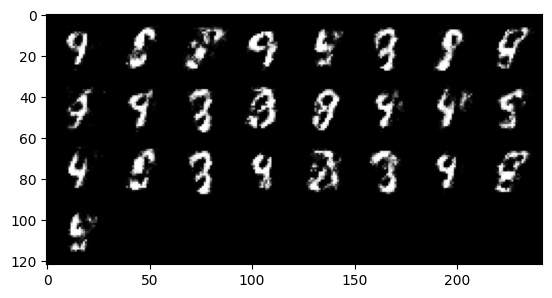

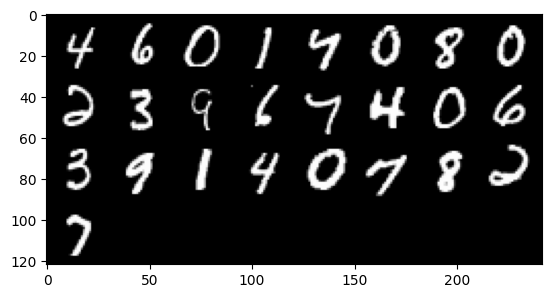

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 2.413173357725142, discriminator loss: 0.26454747712612164


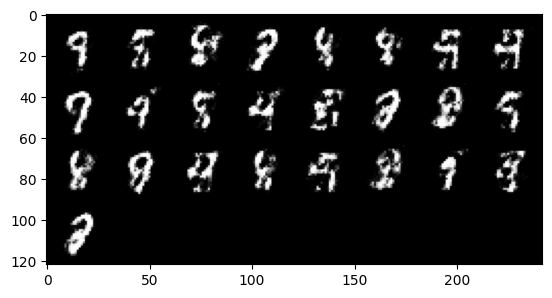

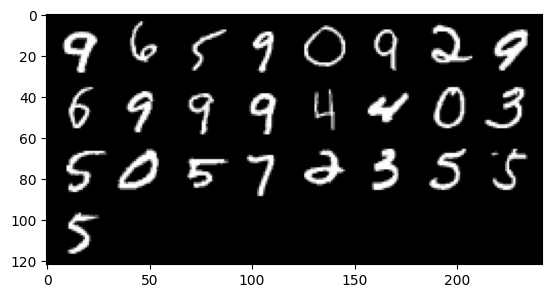

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 2.497072359085083, discriminator loss: 0.24194831800460817


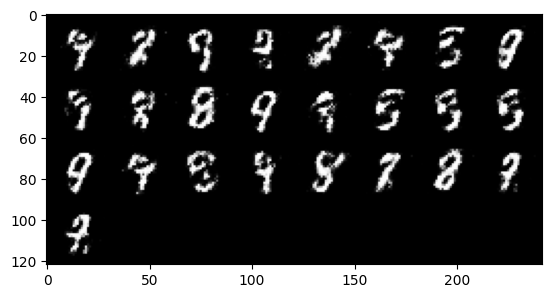

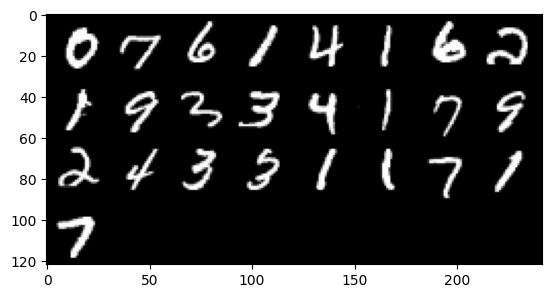

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 2.576822341918943, discriminator loss: 0.2356673308610915


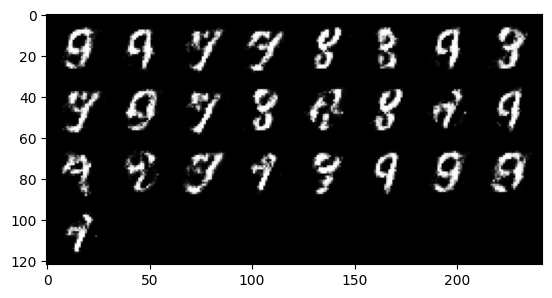

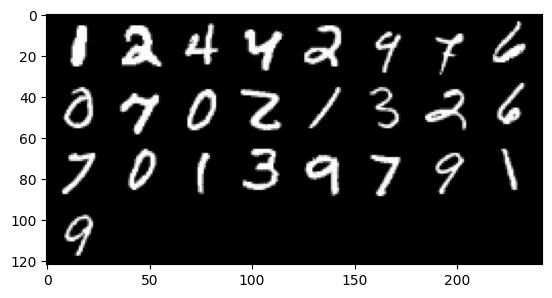

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 2.3570795049667344, discriminator loss: 0.2778042326271535


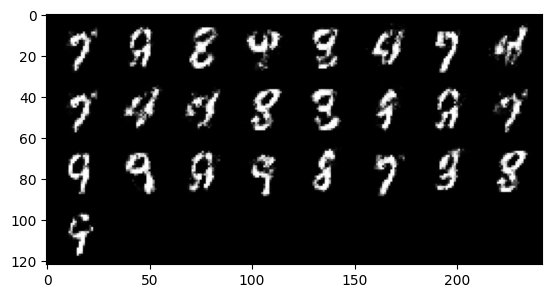

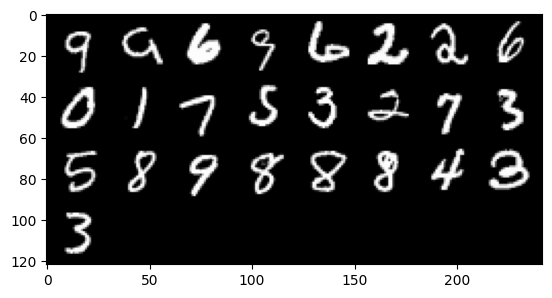

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 2.3110056931972505, discriminator loss: 0.2808776427805422


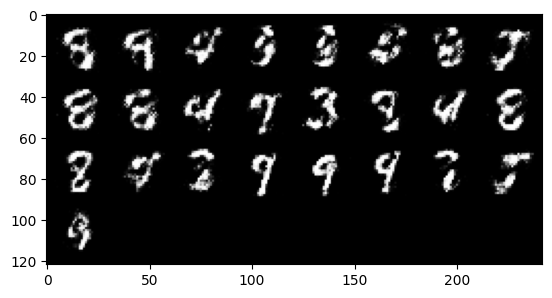

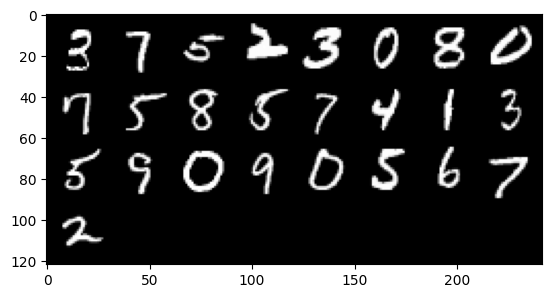

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 2.320791165113452, discriminator loss: 0.2665952669680117


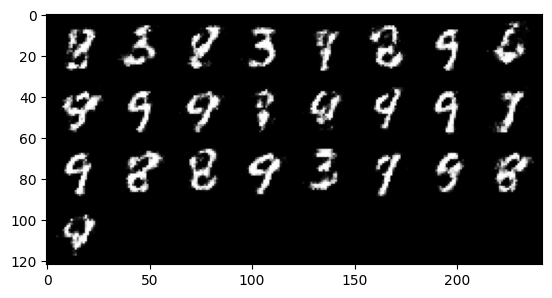

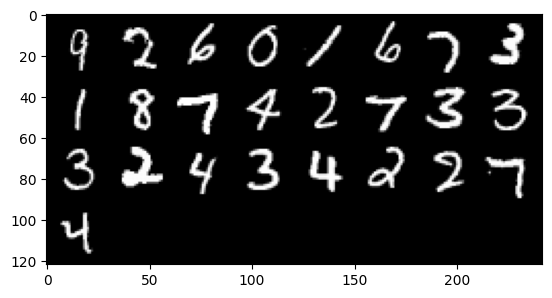

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 2.2556680221557626, discriminator loss: 0.2820430314838886


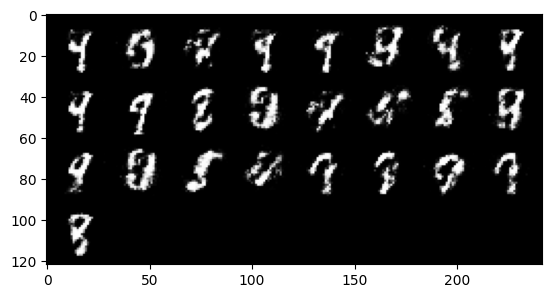

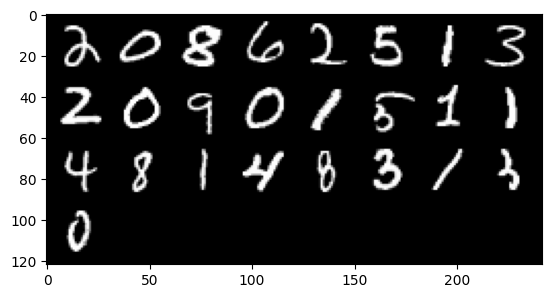

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 2.1638257205486306, discriminator loss: 0.29603712862730036


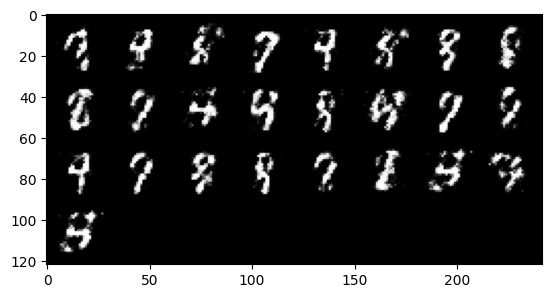

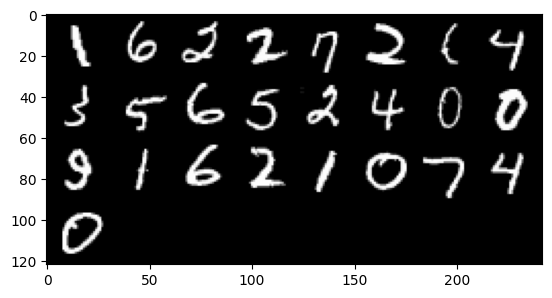

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 2.2875539717674274, discriminator loss: 0.2738786429166793


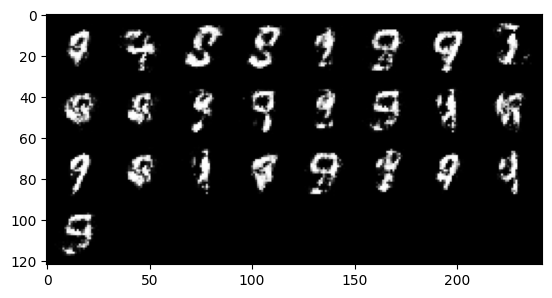

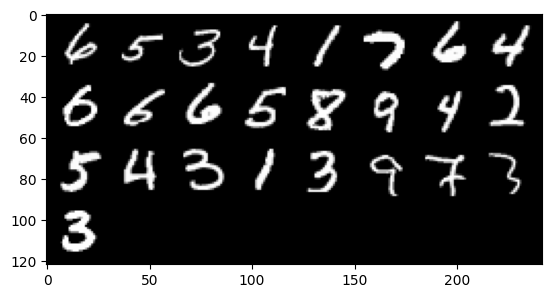

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 2.227935741424561, discriminator loss: 0.2986441765725615


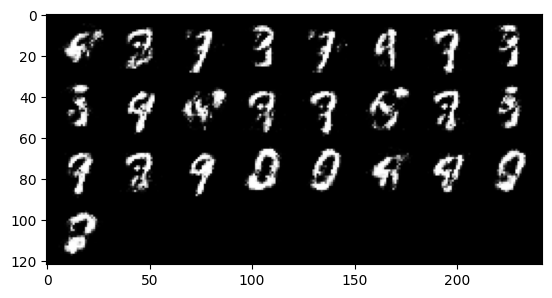

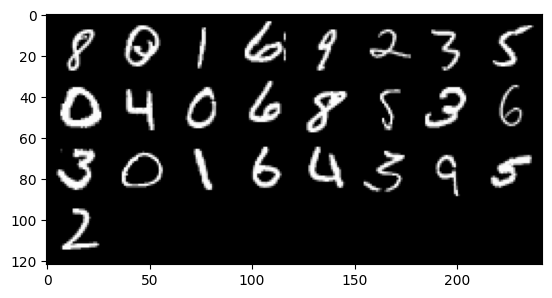

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 2.2351304419040687, discriminator loss: 0.2970995588600636


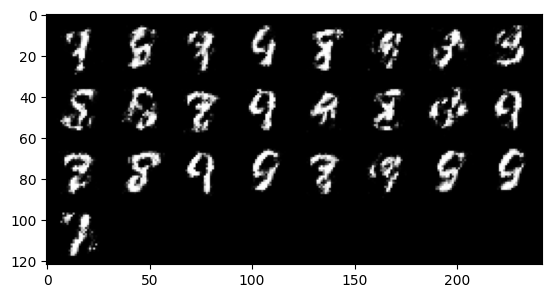

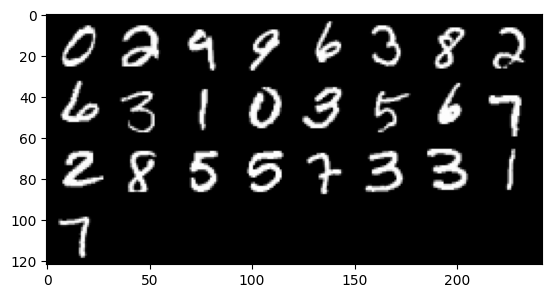

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 2.266442088365554, discriminator loss: 0.28423953077197067


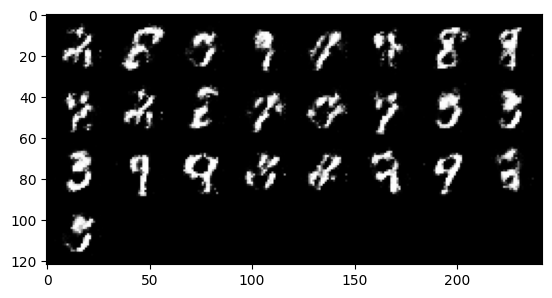

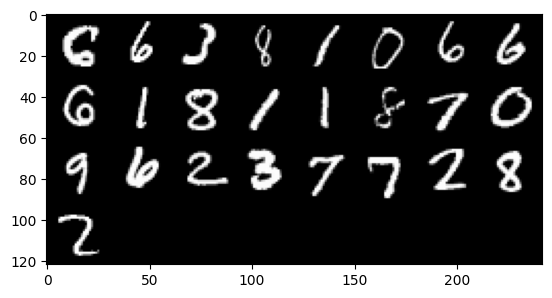

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 2.210200109481812, discriminator loss: 0.29398266863822947


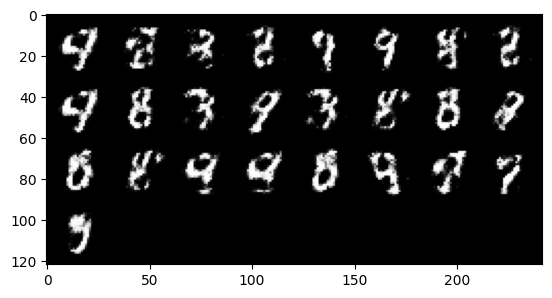

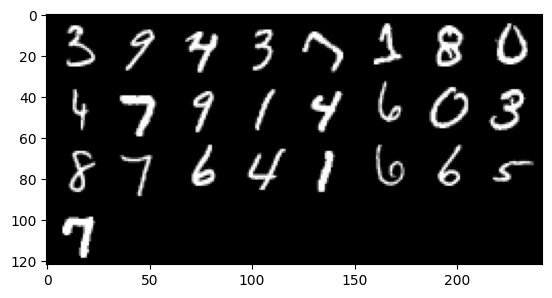

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 2.275922431230546, discriminator loss: 0.28306895008683186


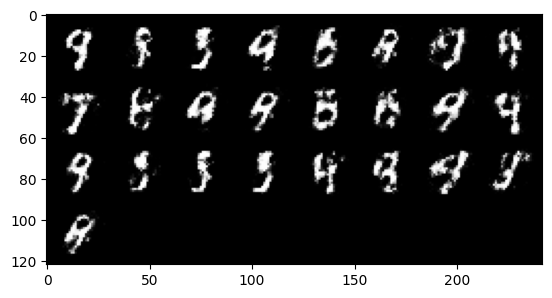

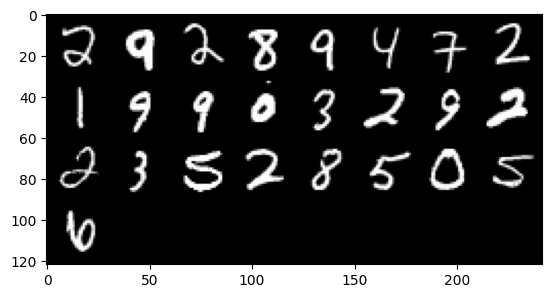

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 2.172632886886599, discriminator loss: 0.30565430822968487


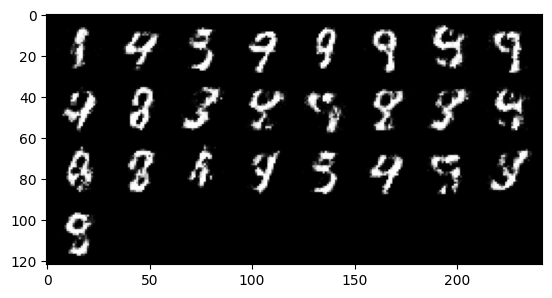

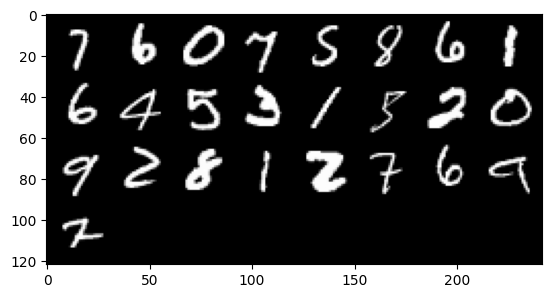

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 2.2876445062160484, discriminator loss: 0.26825409299135233


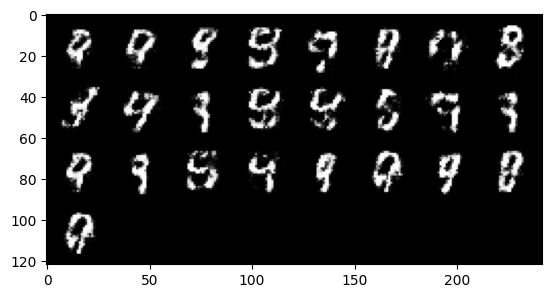

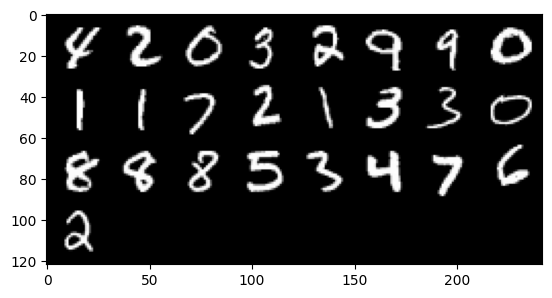

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 2.334366102218628, discriminator loss: 0.2687305254638195


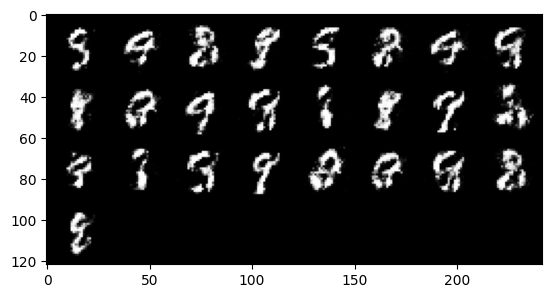

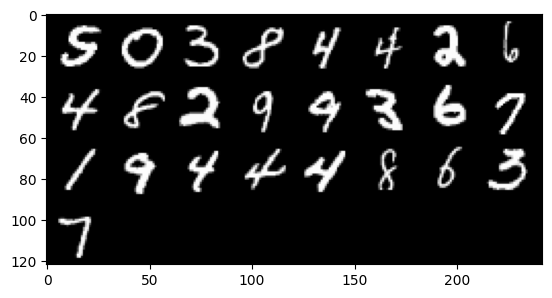

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 2.1044842960834518, discriminator loss: 0.30401956093311316


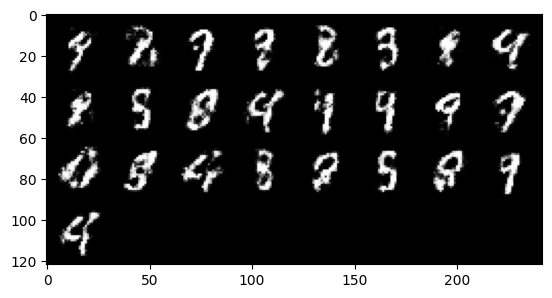

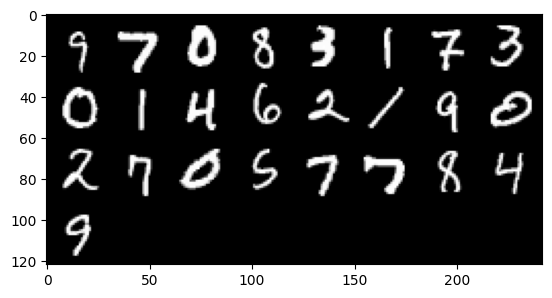

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 2.1558192629814146, discriminator loss: 0.2988912435770036


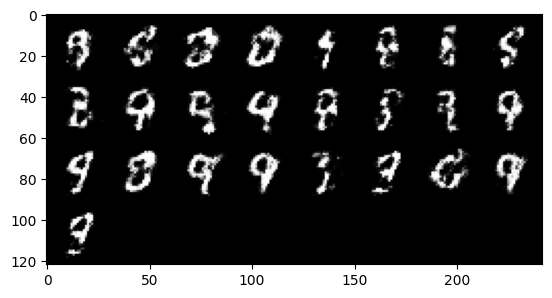

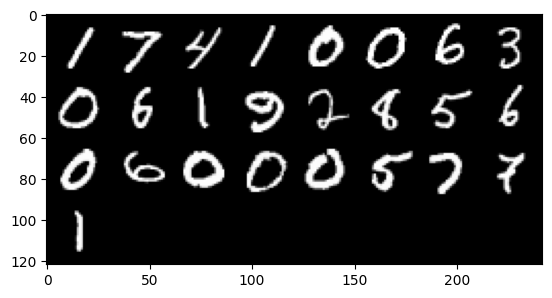

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 2.1103712120056164, discriminator loss: 0.29221733981370945


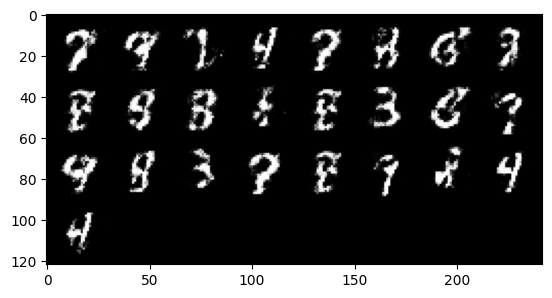

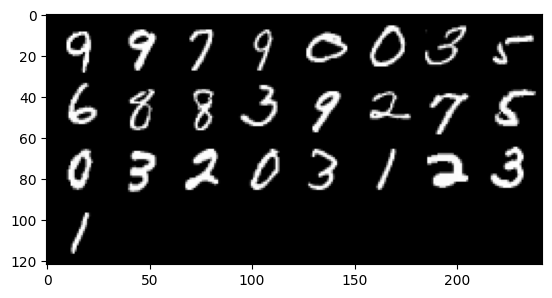

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 2.07879480934143, discriminator loss: 0.30800869861245117


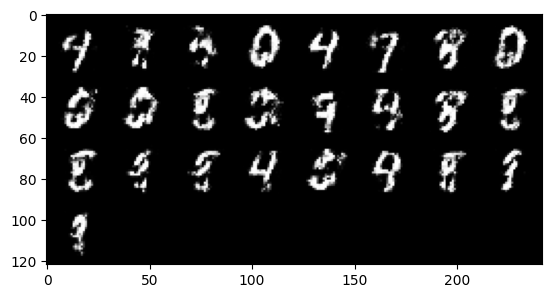

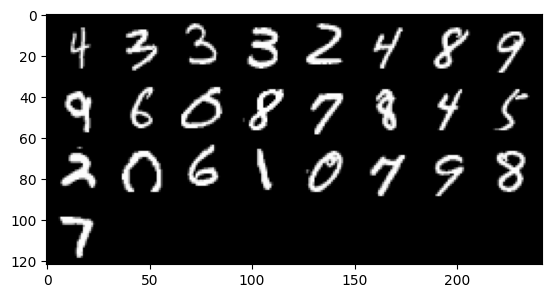

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 2.192594089269641, discriminator loss: 0.29369427827000594


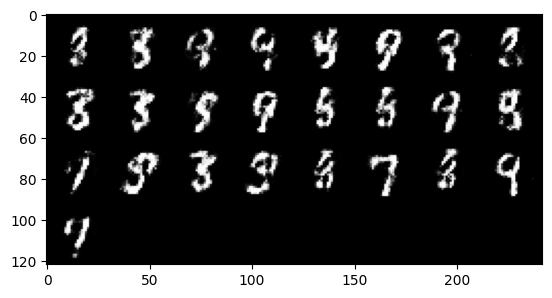

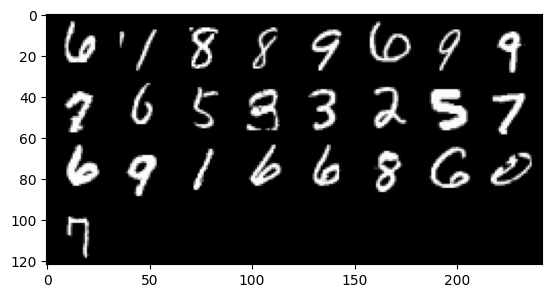

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 2.0920914521217333, discriminator loss: 0.3078822882473468


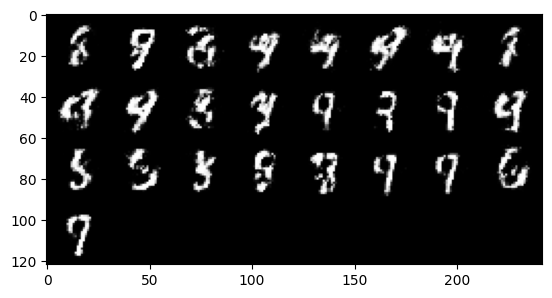

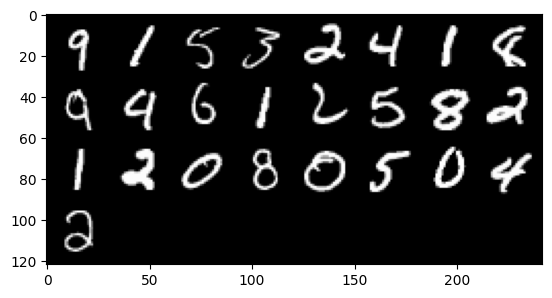

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 2.089165318012239, discriminator loss: 0.3049898764491082


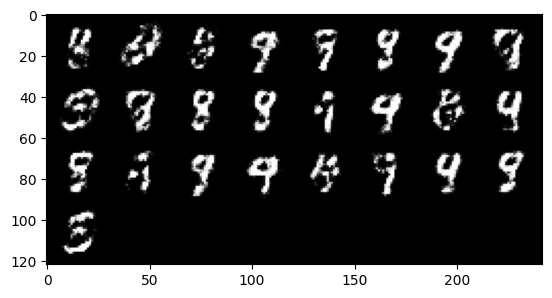

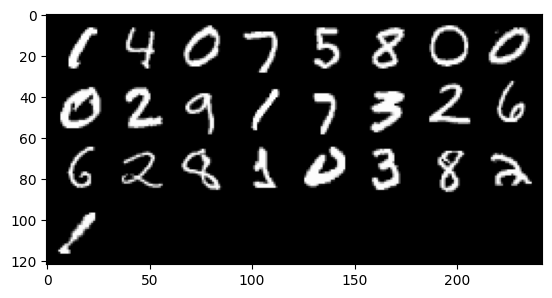

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 1.9833521108627308, discriminator loss: 0.3368667016327385


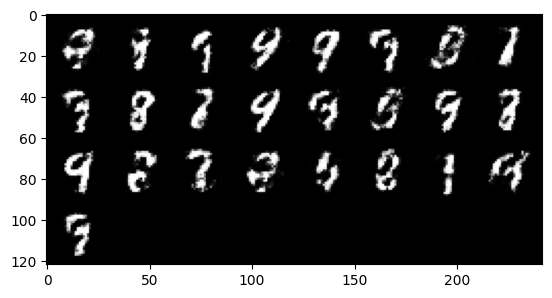

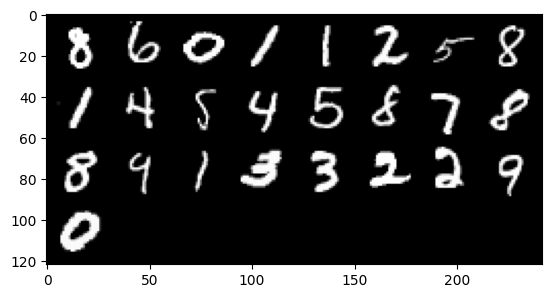

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48000: Generator loss: 2.009518475055697, discriminator loss: 0.31956821486353854


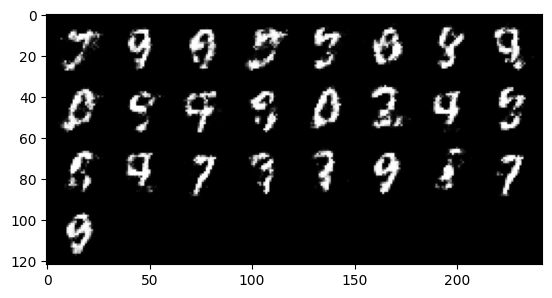

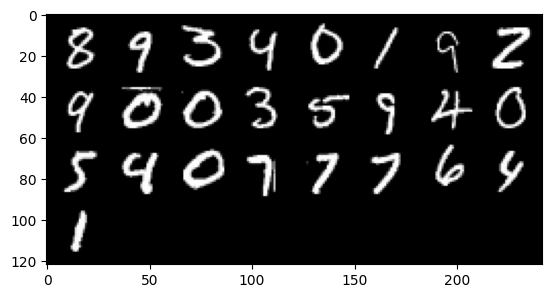

  0%|          | 0/469 [00:00<?, ?it/s]

Step 48500: Generator loss: 1.9930713505744928, discriminator loss: 0.32461879011988654


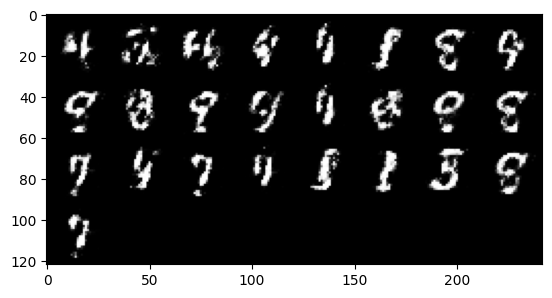

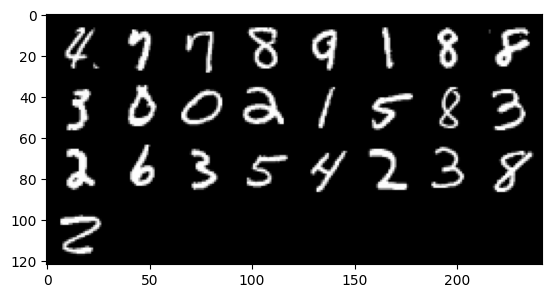

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49000: Generator loss: 1.938722499370575, discriminator loss: 0.3484291068315505


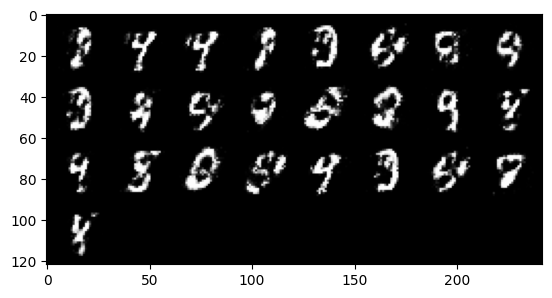

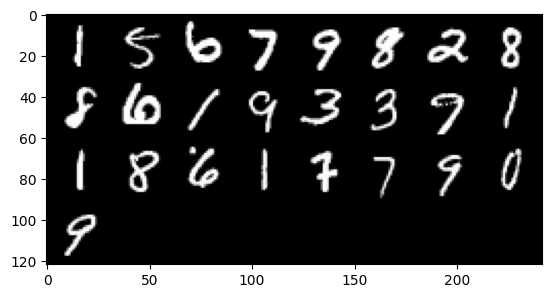

  0%|          | 0/469 [00:00<?, ?it/s]

Step 49500: Generator loss: 2.0606112532615657, discriminator loss: 0.3091382256448269


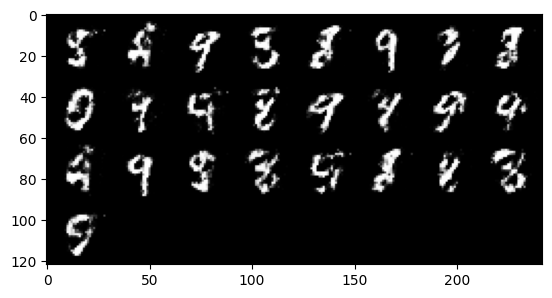

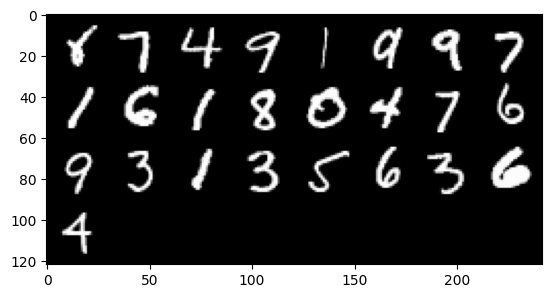

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50000: Generator loss: 1.998360564470291, discriminator loss: 0.32057489129900946


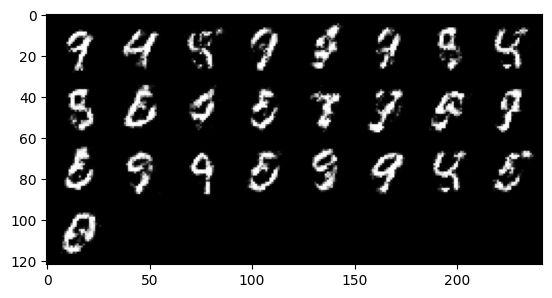

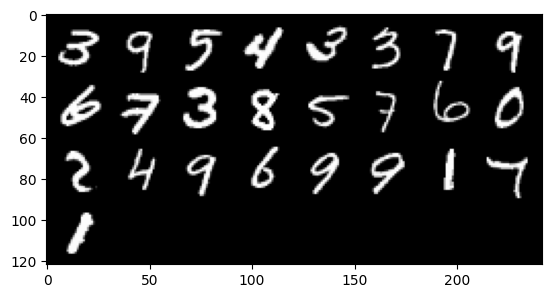

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50500: Generator loss: 1.8942678203582775, discriminator loss: 0.34620856416225443


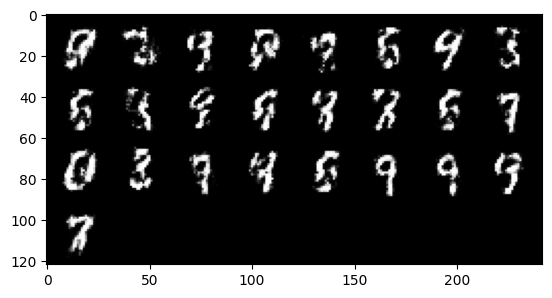

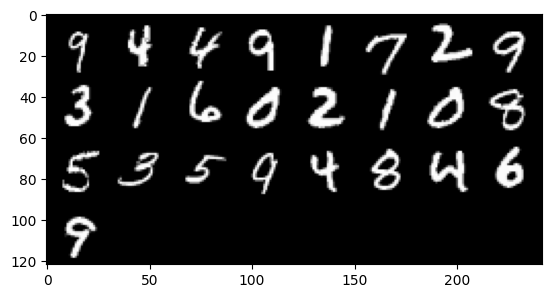

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51000: Generator loss: 1.8969073071479798, discriminator loss: 0.3402045148611072


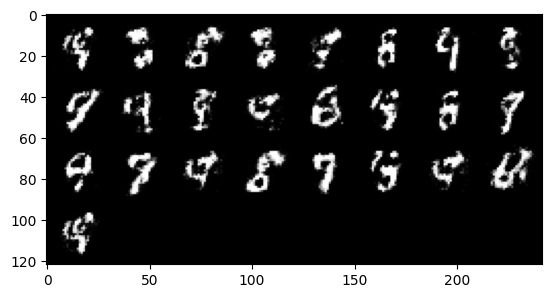

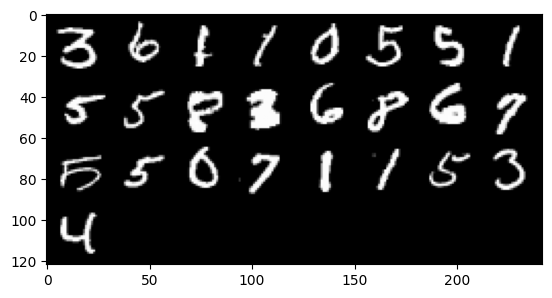

  0%|          | 0/469 [00:00<?, ?it/s]

Step 51500: Generator loss: 1.8543850197792058, discriminator loss: 0.35600650385022137


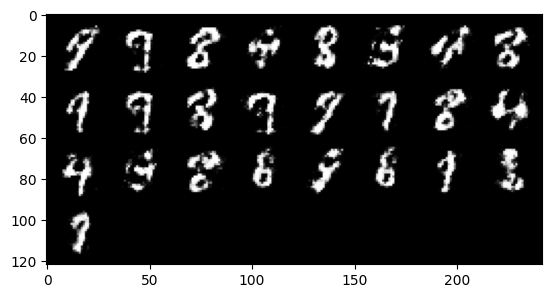

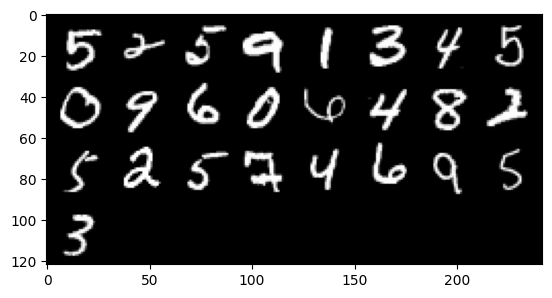

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52000: Generator loss: 1.7295640234947192, discriminator loss: 0.37777804240584406


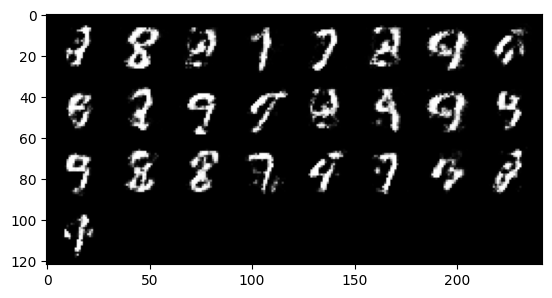

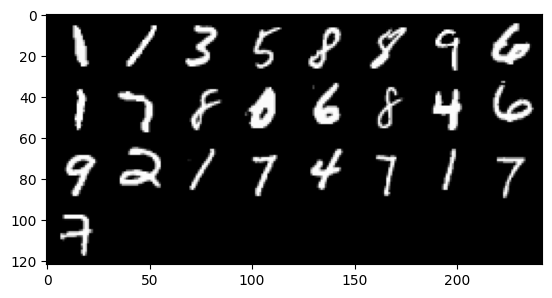

  0%|          | 0/469 [00:00<?, ?it/s]

Step 52500: Generator loss: 1.774241821050642, discriminator loss: 0.37295810145139685


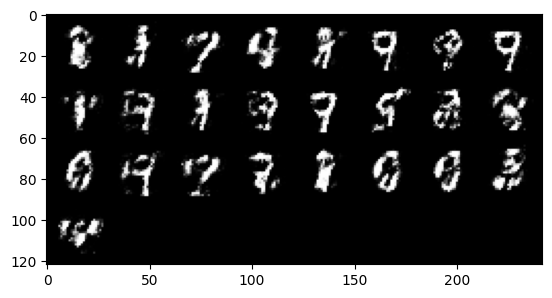

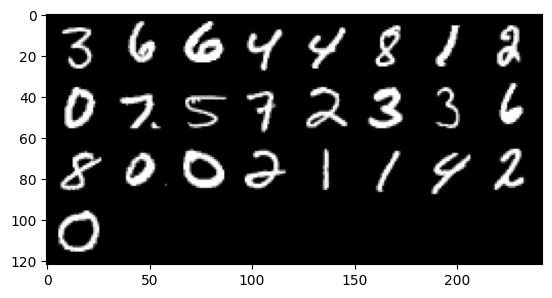

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53000: Generator loss: 1.7486417725086205, discriminator loss: 0.3642271684408189


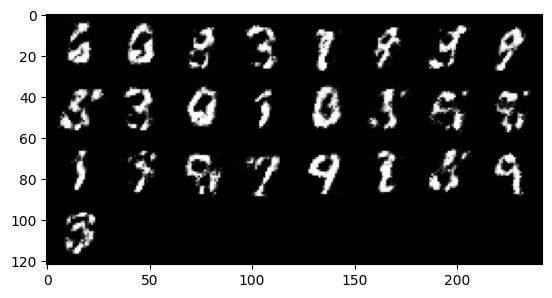

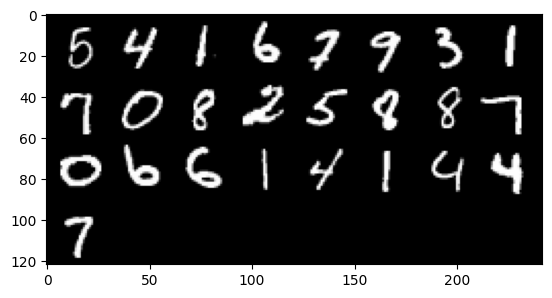

  0%|          | 0/469 [00:00<?, ?it/s]

Step 53500: Generator loss: 1.718483507633208, discriminator loss: 0.37777625674009324


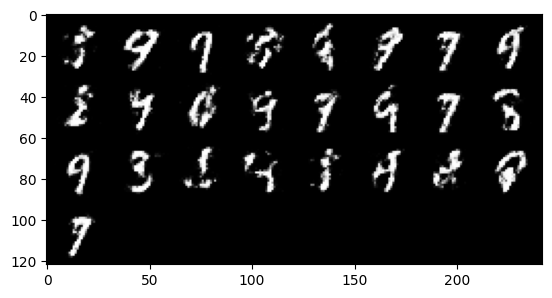

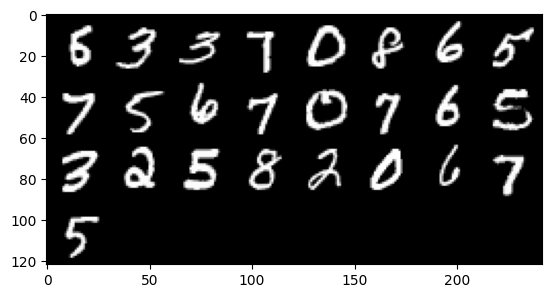

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54000: Generator loss: 1.7248513581752773, discriminator loss: 0.37504565858840966


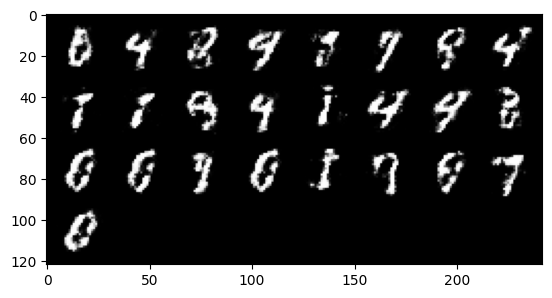

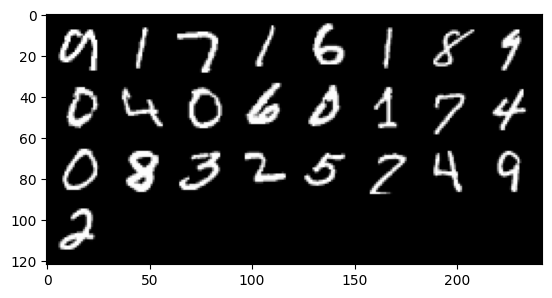

  0%|          | 0/469 [00:00<?, ?it/s]

Step 54500: Generator loss: 1.6884701640605926, discriminator loss: 0.3794555513262746


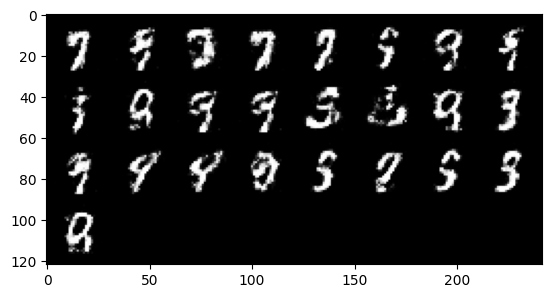

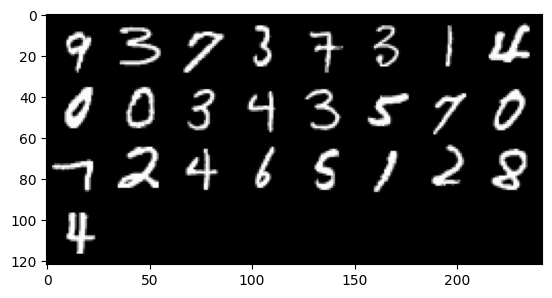

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55000: Generator loss: 1.6719003045558911, discriminator loss: 0.3886864882111552


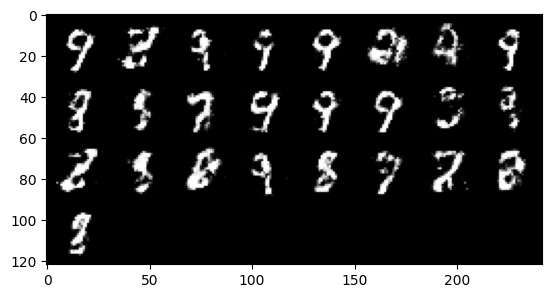

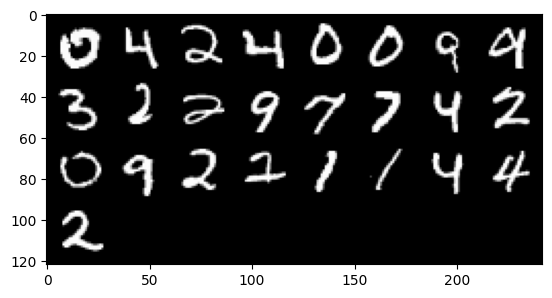

  0%|          | 0/469 [00:00<?, ?it/s]

Step 55500: Generator loss: 1.6263913285732279, discriminator loss: 0.40692048037052175


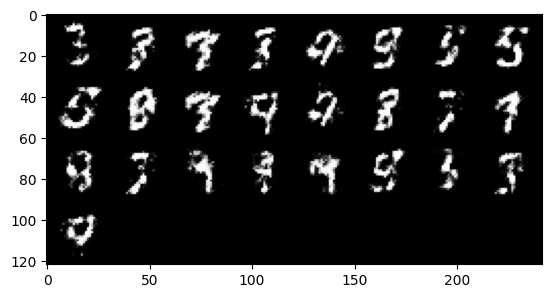

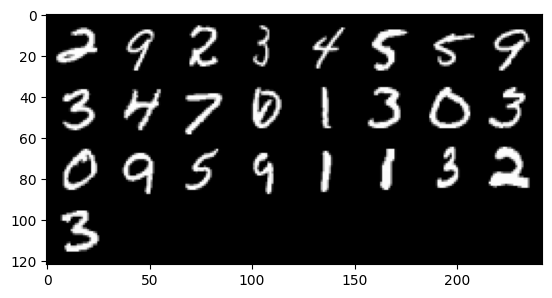

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56000: Generator loss: 1.6892615053653723, discriminator loss: 0.38348915189504623


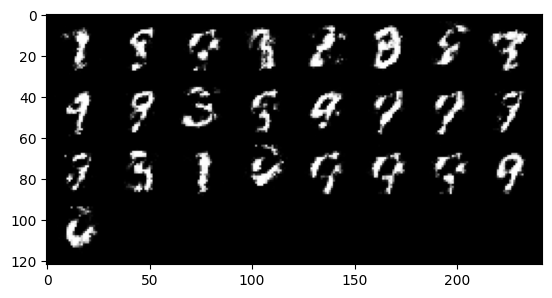

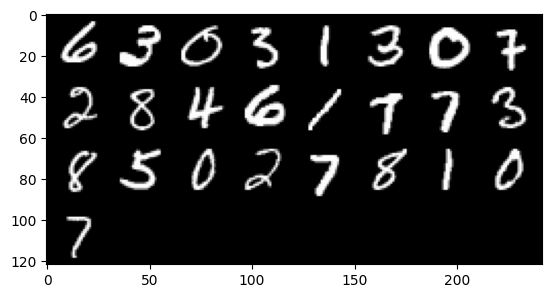

  0%|          | 0/469 [00:00<?, ?it/s]

Step 56500: Generator loss: 1.7221320202350618, discriminator loss: 0.376061107754707


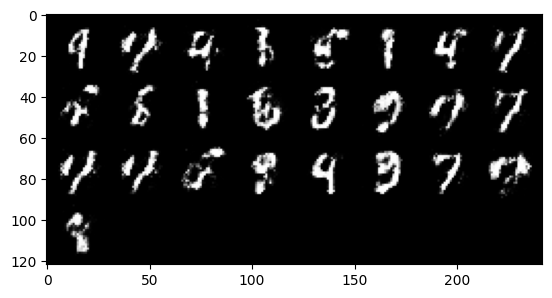

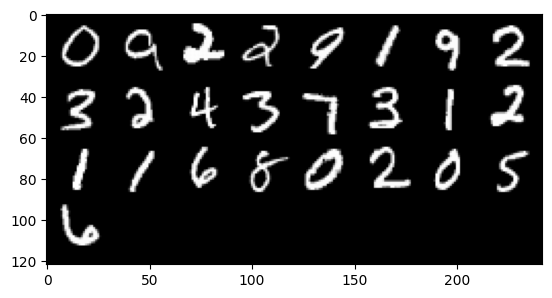

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57000: Generator loss: 1.696053606510162, discriminator loss: 0.3779132189750675


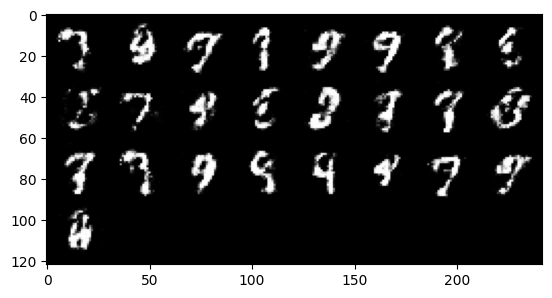

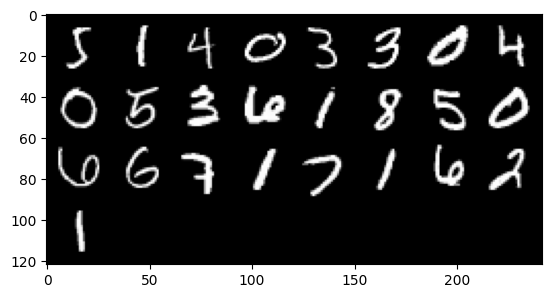

  0%|          | 0/469 [00:00<?, ?it/s]

Step 57500: Generator loss: 1.7838106985092166, discriminator loss: 0.35551021715998676


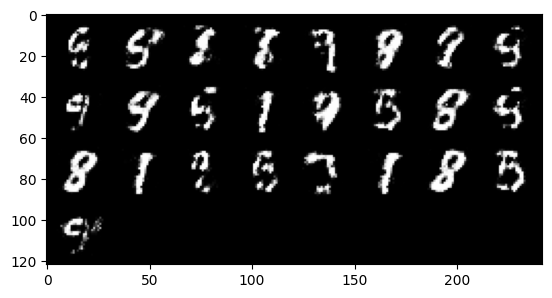

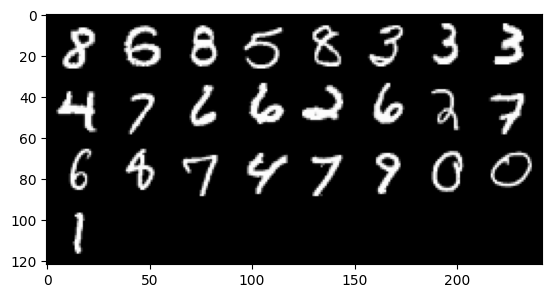

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58000: Generator loss: 1.8257708597183233, discriminator loss: 0.3427955253422254


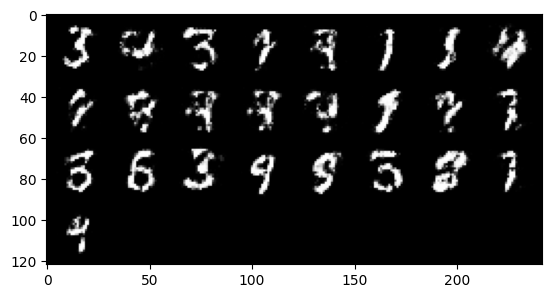

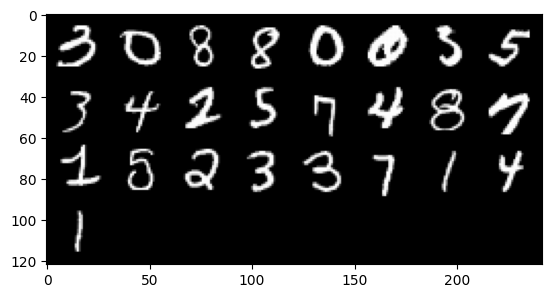

  0%|          | 0/469 [00:00<?, ?it/s]

Step 58500: Generator loss: 1.7796835057735454, discriminator loss: 0.3710083554983135


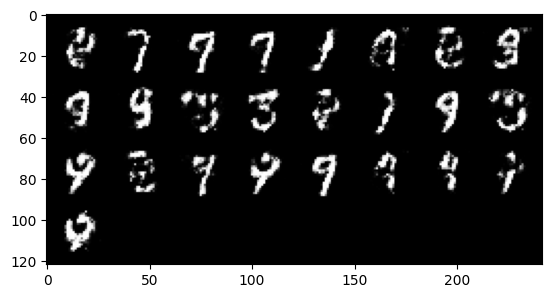

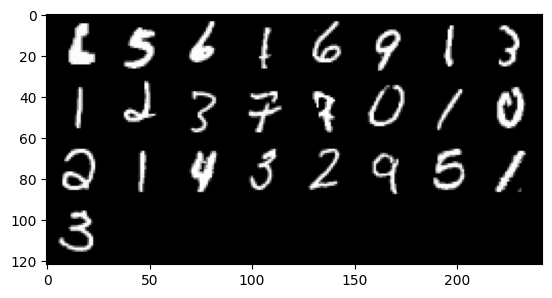

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59000: Generator loss: 1.7040109024047858, discriminator loss: 0.37717246159911105


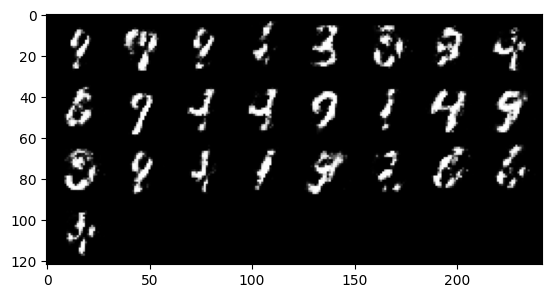

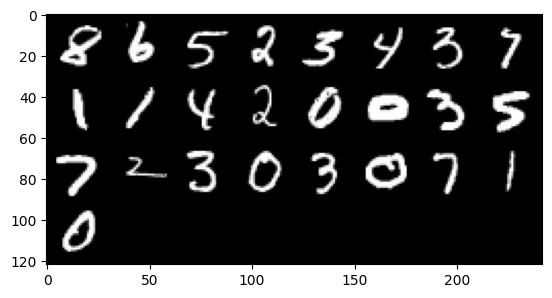

  0%|          | 0/469 [00:00<?, ?it/s]

Step 59500: Generator loss: 1.7869326798915843, discriminator loss: 0.3706313828229907


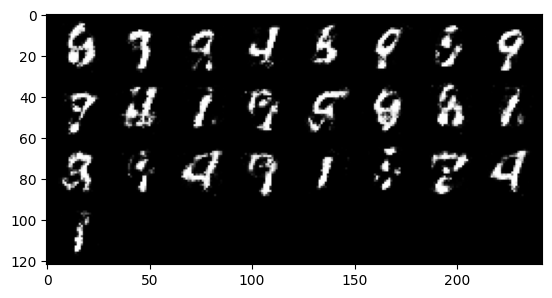

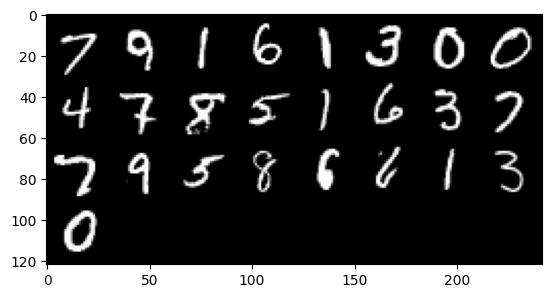

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60000: Generator loss: 1.6936360831260693, discriminator loss: 0.37310532671213126


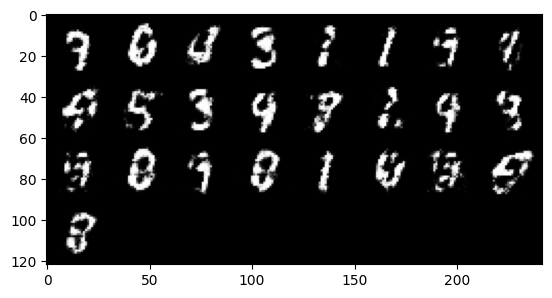

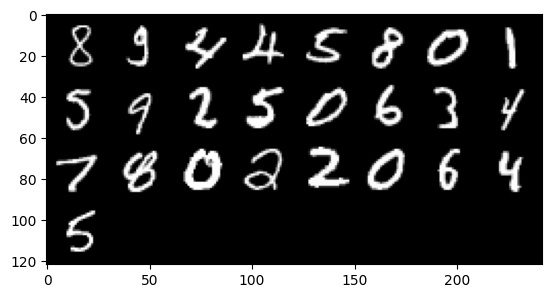

  0%|          | 0/469 [00:00<?, ?it/s]

Step 60500: Generator loss: 1.7240354895591734, discriminator loss: 0.37640476626157765


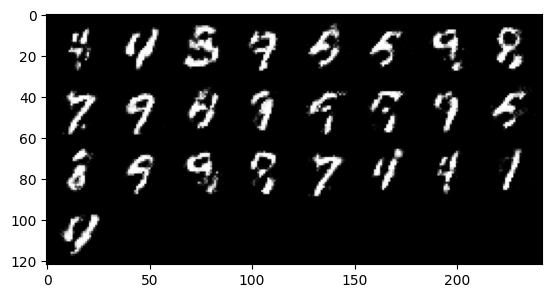

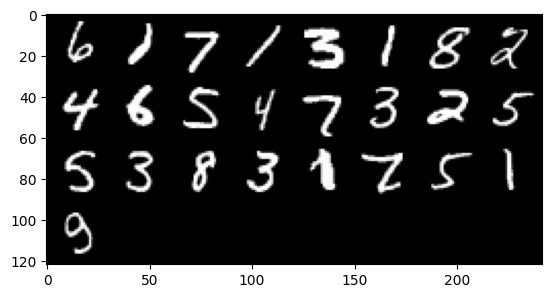

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61000: Generator loss: 1.6422443721294415, discriminator loss: 0.39553769099712355


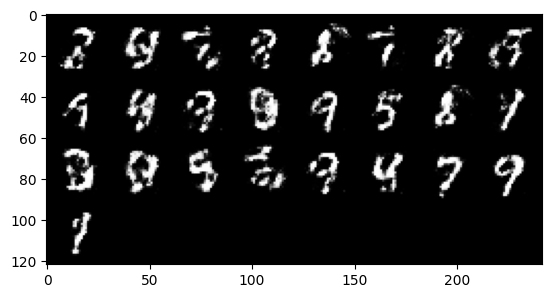

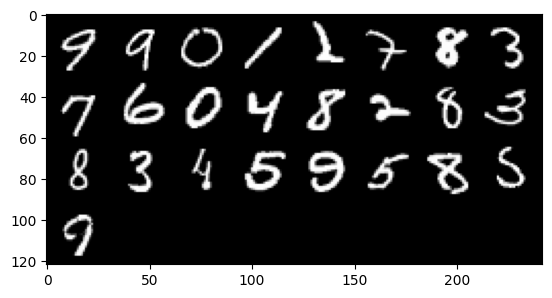

  0%|          | 0/469 [00:00<?, ?it/s]

Step 61500: Generator loss: 1.6594801859855643, discriminator loss: 0.386244735658169


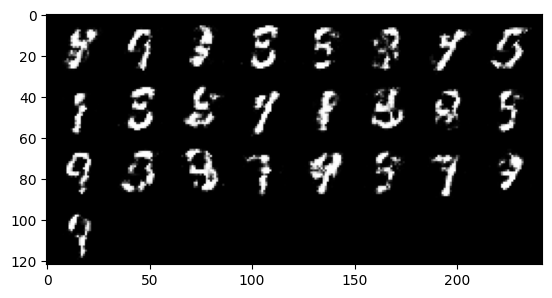

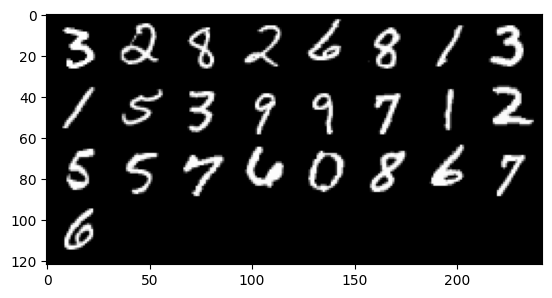

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62000: Generator loss: 1.6273070359230035, discriminator loss: 0.3987956151366234


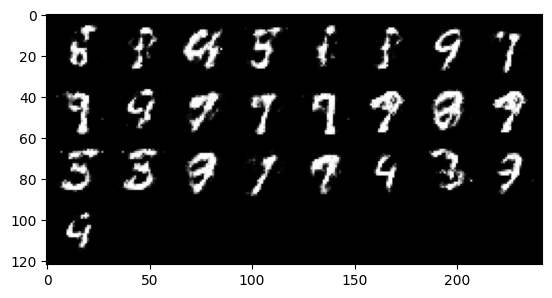

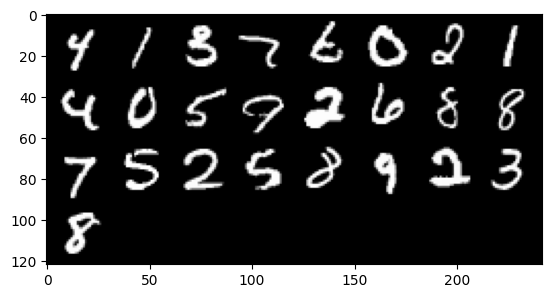

  0%|          | 0/469 [00:00<?, ?it/s]

Step 62500: Generator loss: 1.5706066527366622, discriminator loss: 0.41590256005525567


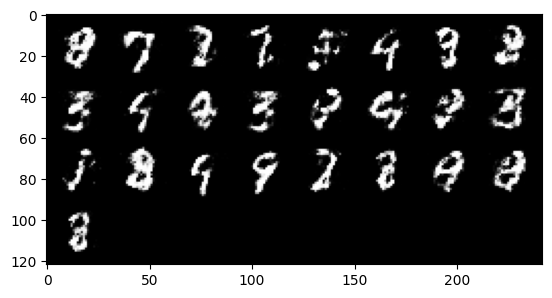

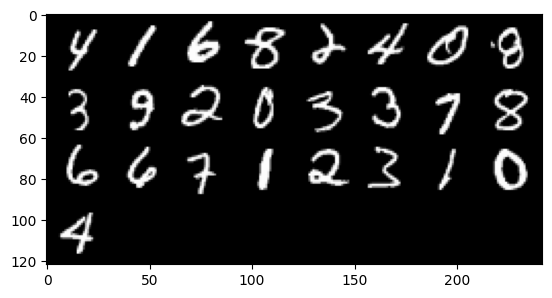

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63000: Generator loss: 1.5419656043052674, discriminator loss: 0.4154117905497554


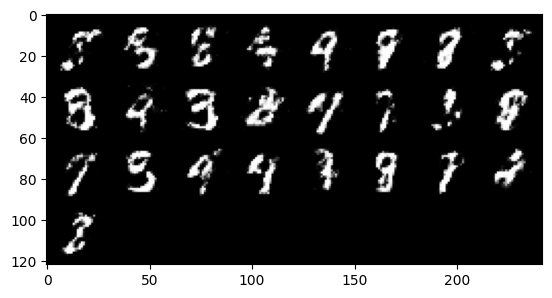

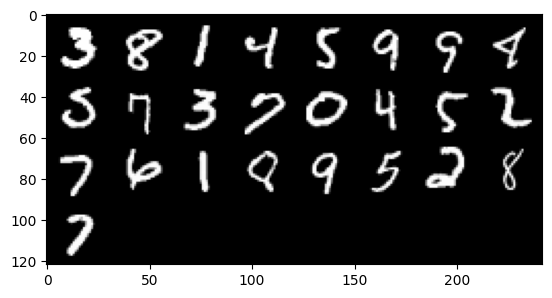

  0%|          | 0/469 [00:00<?, ?it/s]

Step 63500: Generator loss: 1.6120770583152777, discriminator loss: 0.399217198252678


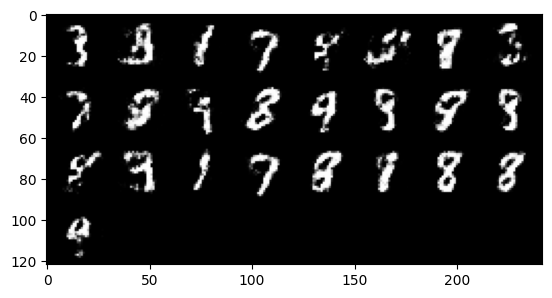

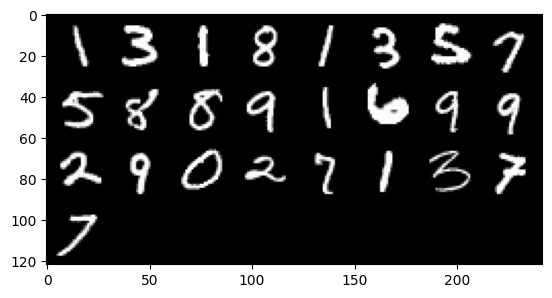

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64000: Generator loss: 1.5672785179615019, discriminator loss: 0.404924459636211


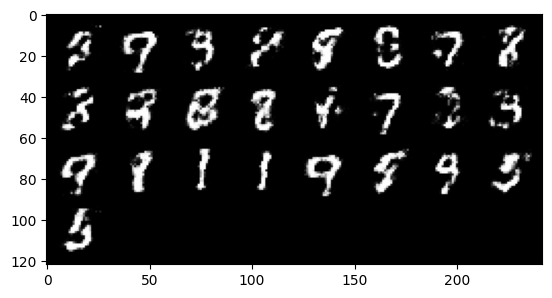

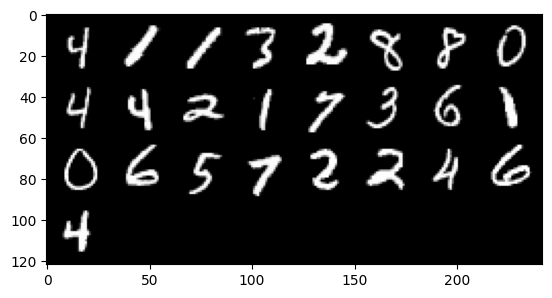

  0%|          | 0/469 [00:00<?, ?it/s]

Step 64500: Generator loss: 1.4517188146114337, discriminator loss: 0.44343470084667214


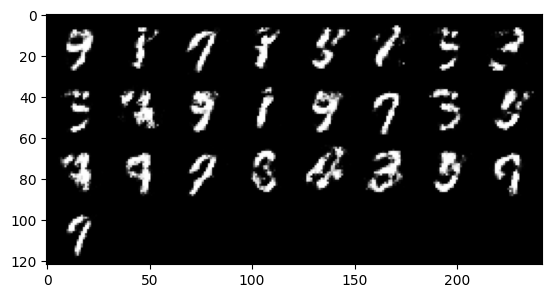

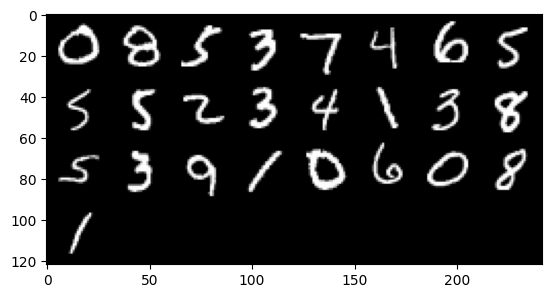

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65000: Generator loss: 1.4638697795867932, discriminator loss: 0.44055538654327386


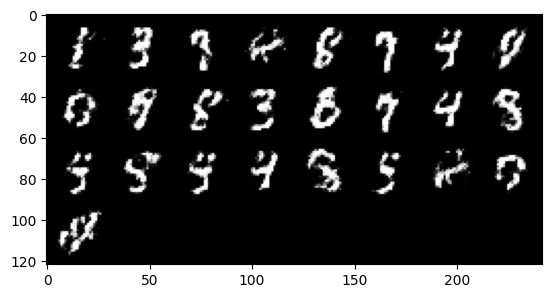

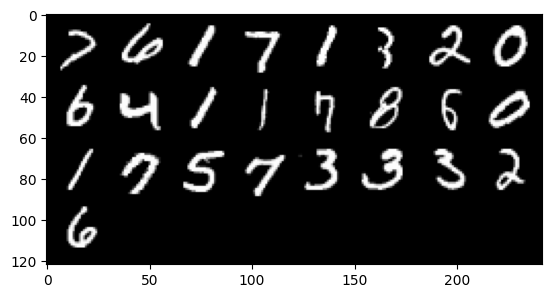

  0%|          | 0/469 [00:00<?, ?it/s]

Step 65500: Generator loss: 1.4776533401012415, discriminator loss: 0.4398989056348801


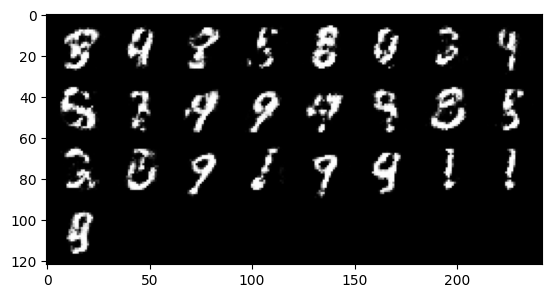

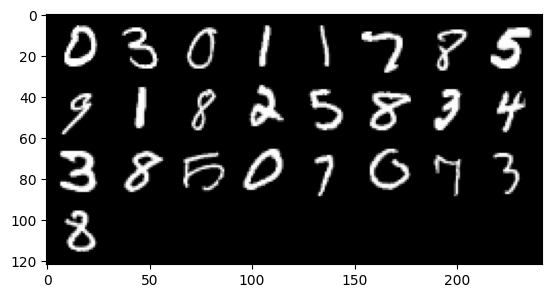

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66000: Generator loss: 1.4574719684123991, discriminator loss: 0.4461461625099183


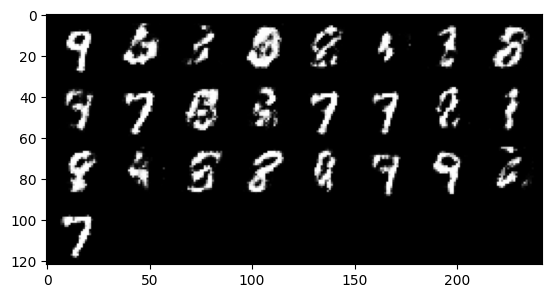

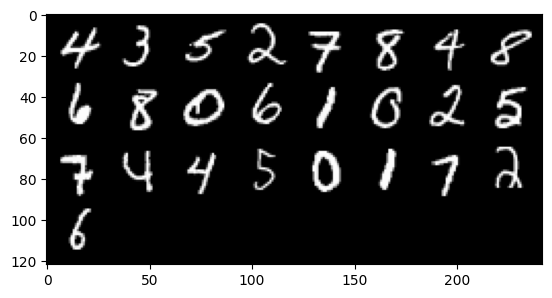

  0%|          | 0/469 [00:00<?, ?it/s]

Step 66500: Generator loss: 1.3868139324188247, discriminator loss: 0.4602953717112538


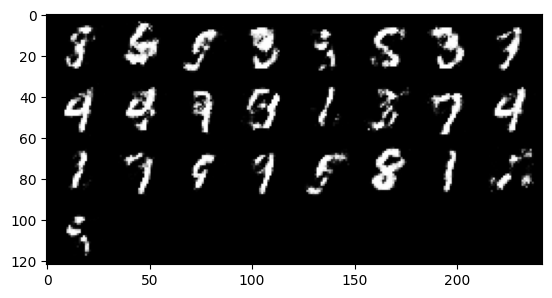

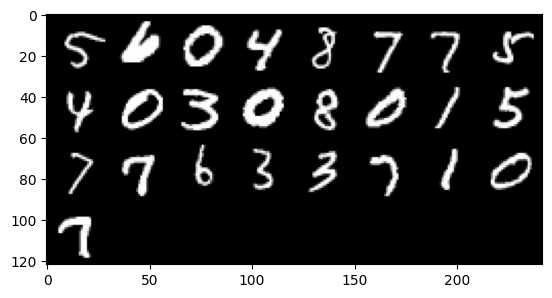

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67000: Generator loss: 1.4153193922042842, discriminator loss: 0.44866690683364824


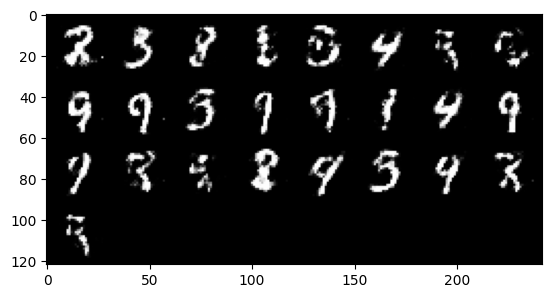

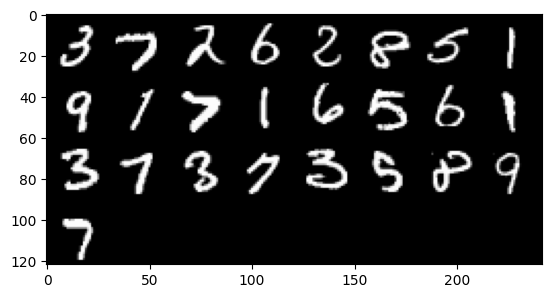

  0%|          | 0/469 [00:00<?, ?it/s]

Step 67500: Generator loss: 1.4046118001937844, discriminator loss: 0.45445714432001066


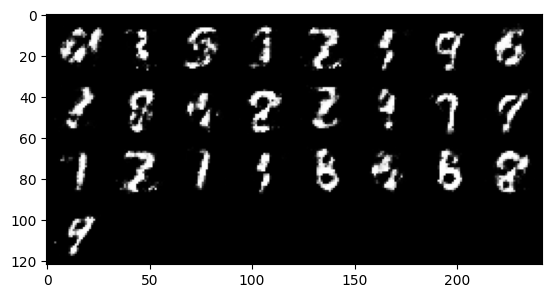

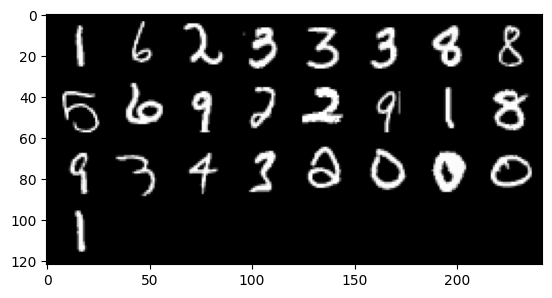

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68000: Generator loss: 1.433963318824769, discriminator loss: 0.4461070703864097


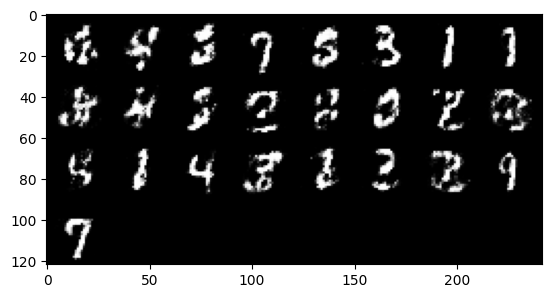

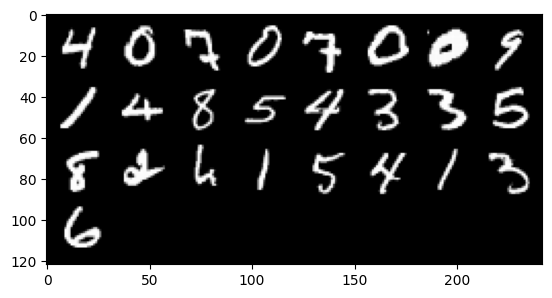

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 68500: Generator loss: 1.471860634326935, discriminator loss: 0.42714717048406603


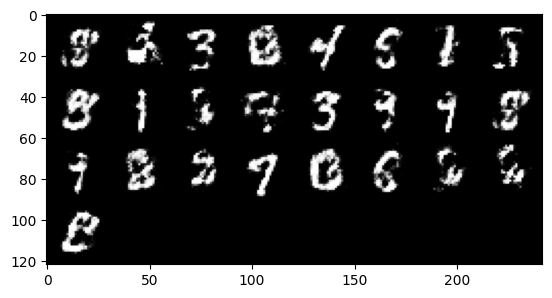

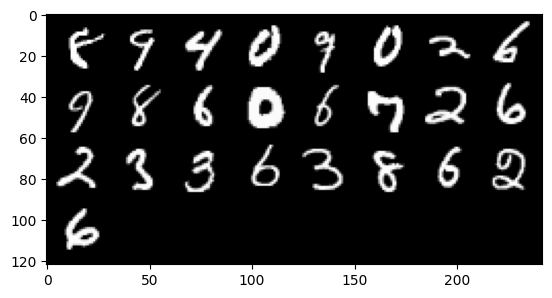

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69000: Generator loss: 1.4118469500541675, discriminator loss: 0.456132236421108


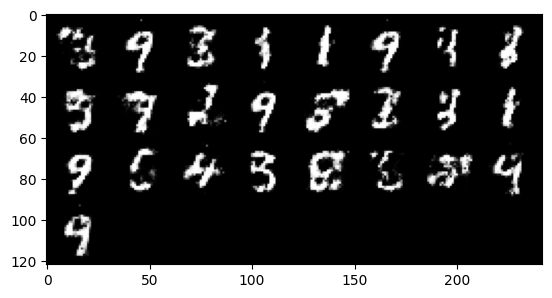

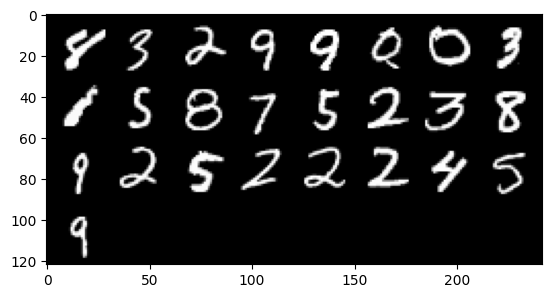

  0%|          | 0/469 [00:00<?, ?it/s]

Step 69500: Generator loss: 1.47504774618149, discriminator loss: 0.42539861100912096


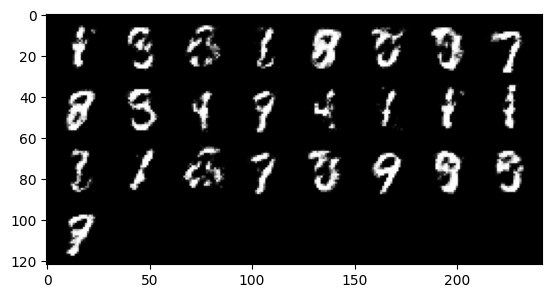

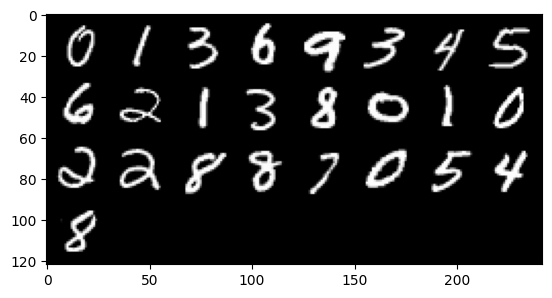

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70000: Generator loss: 1.4026061143875126, discriminator loss: 0.44997151809930763


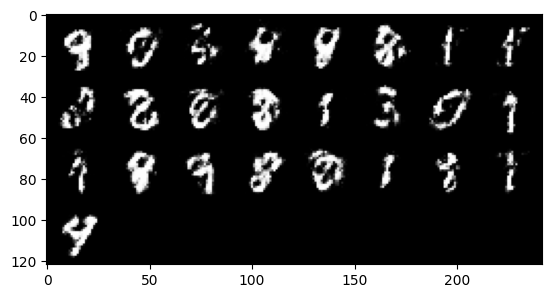

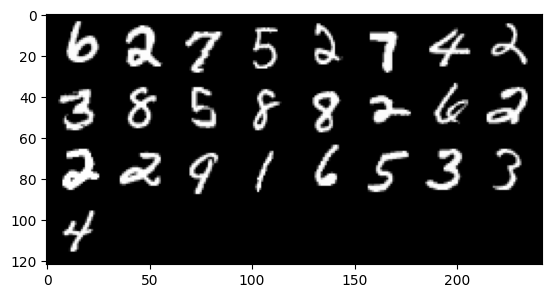

  0%|          | 0/469 [00:00<?, ?it/s]

Step 70500: Generator loss: 1.3867170712947836, discriminator loss: 0.45792857468128245


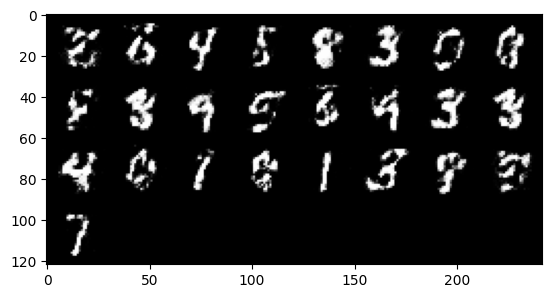

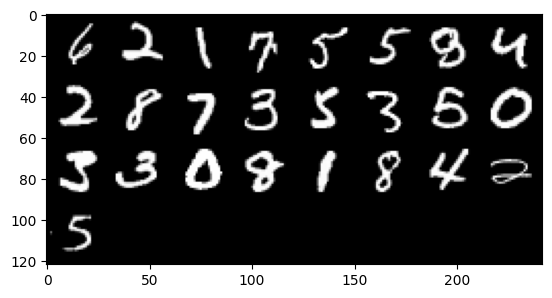

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71000: Generator loss: 1.4422177071571343, discriminator loss: 0.44153535532951343


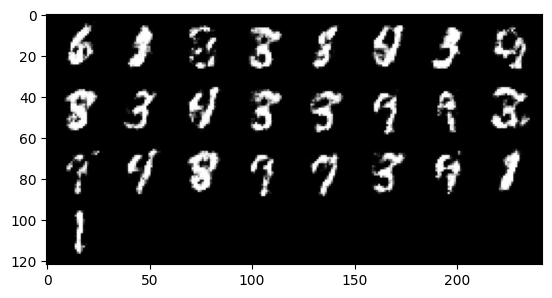

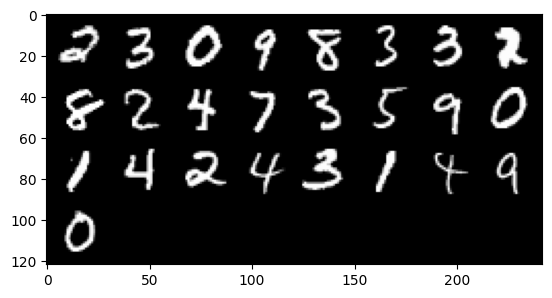

  0%|          | 0/469 [00:00<?, ?it/s]

Step 71500: Generator loss: 1.406024380207062, discriminator loss: 0.4405156870484346


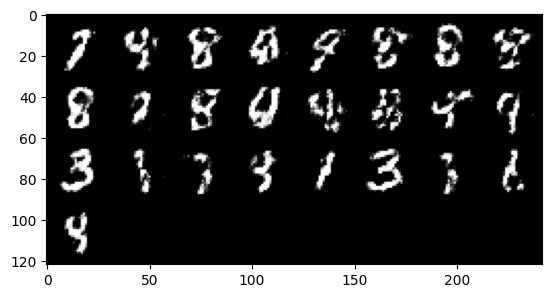

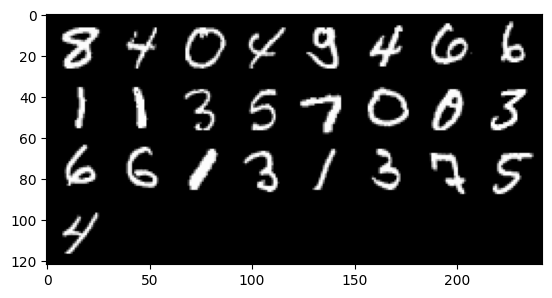

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72000: Generator loss: 1.4112951562404628, discriminator loss: 0.44580261671543125


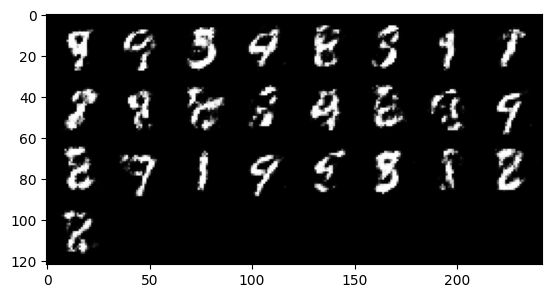

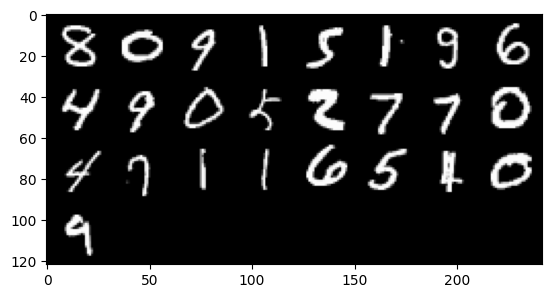

  0%|          | 0/469 [00:00<?, ?it/s]

Step 72500: Generator loss: 1.3418264689445505, discriminator loss: 0.46771375977993


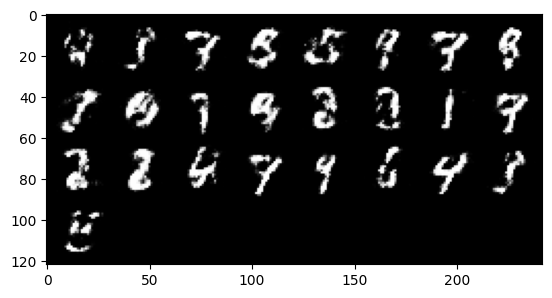

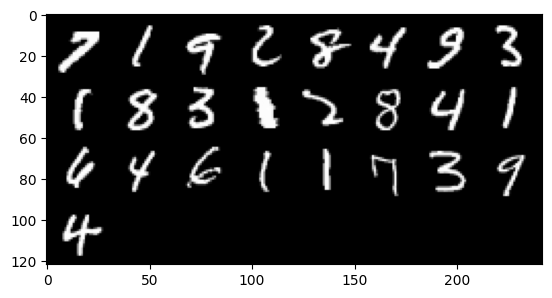

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73000: Generator loss: 1.2936202387809752, discriminator loss: 0.47639753794670087


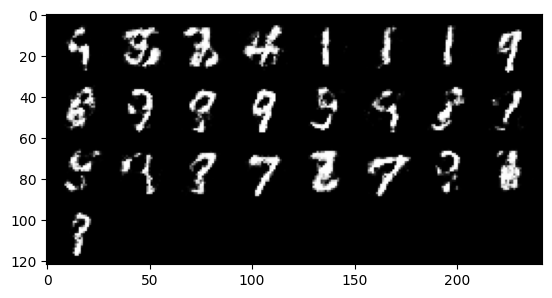

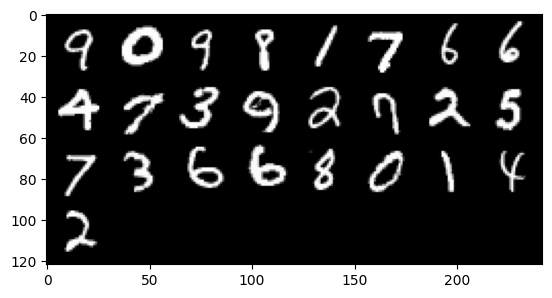

  0%|          | 0/469 [00:00<?, ?it/s]

Step 73500: Generator loss: 1.2783005135059347, discriminator loss: 0.4811582741141316


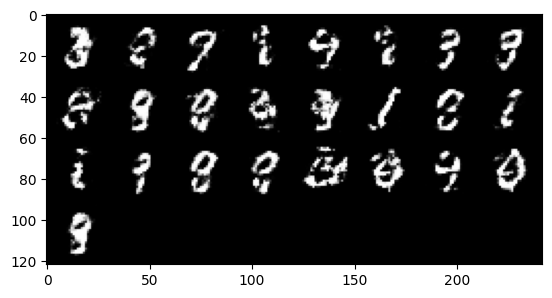

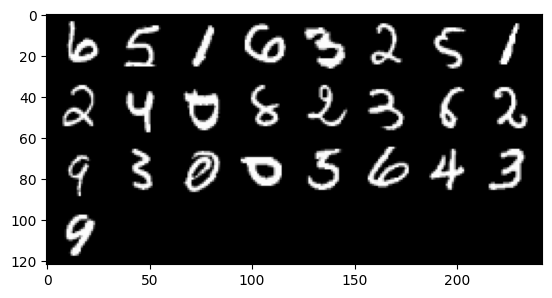

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74000: Generator loss: 1.3447147235870367, discriminator loss: 0.449019027113915


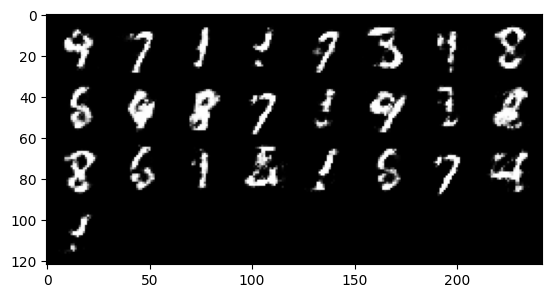

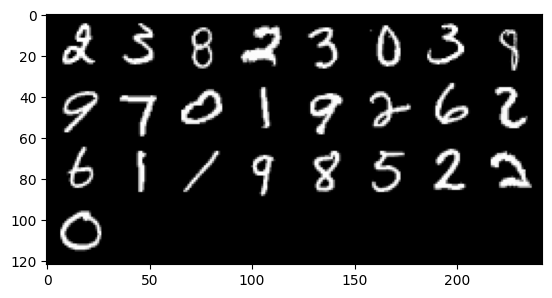

  0%|          | 0/469 [00:00<?, ?it/s]

Step 74500: Generator loss: 1.3547613511085483, discriminator loss: 0.4463715854287147


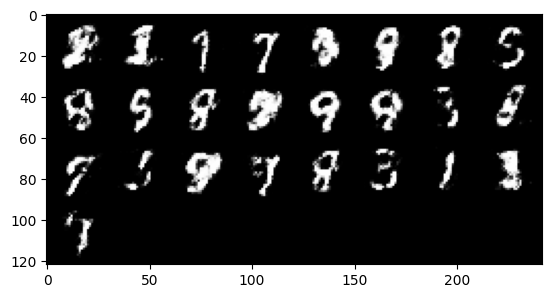

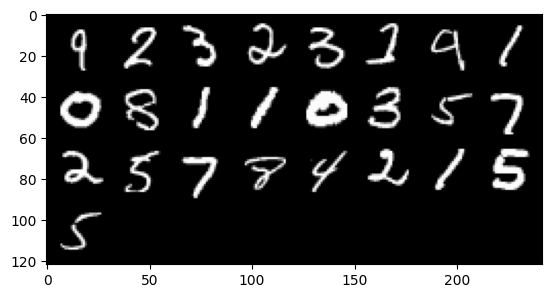

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75000: Generator loss: 1.311169728040695, discriminator loss: 0.47055935883522076


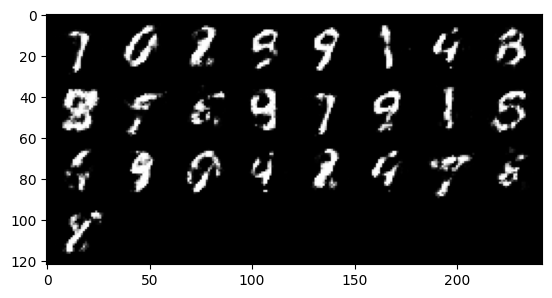

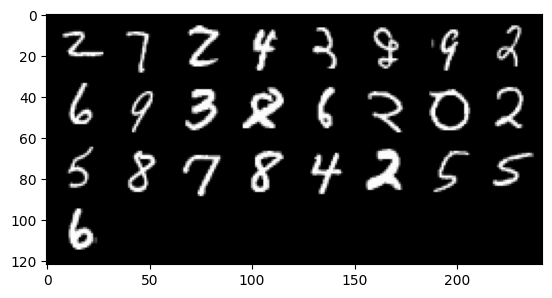

  0%|          | 0/469 [00:00<?, ?it/s]

Step 75500: Generator loss: 1.2747197837829585, discriminator loss: 0.49054753500223147


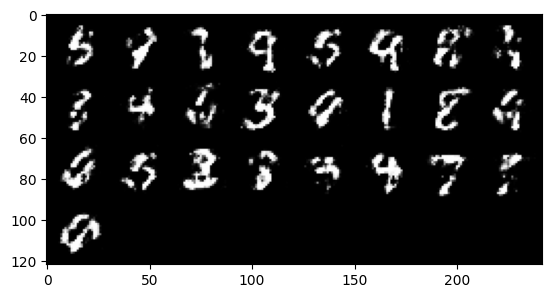

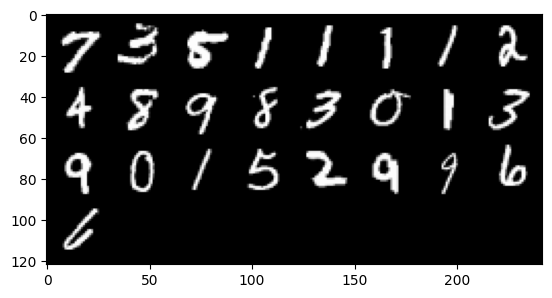

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76000: Generator loss: 1.2620324507951741, discriminator loss: 0.5141392780542374


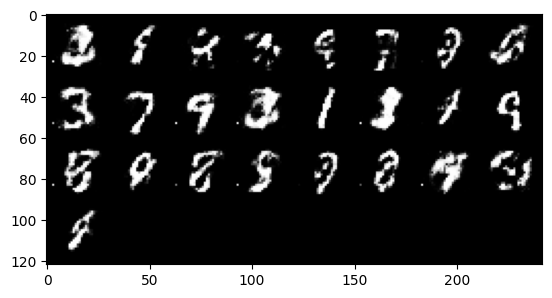

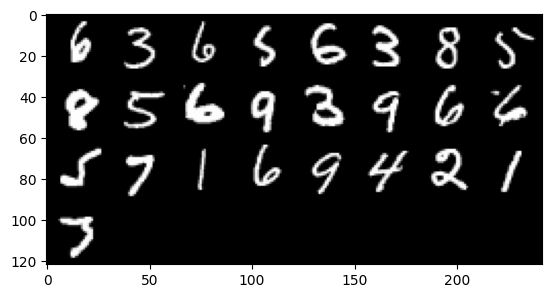

  0%|          | 0/469 [00:00<?, ?it/s]

Step 76500: Generator loss: 1.124627399086952, discriminator loss: 0.534513140082359


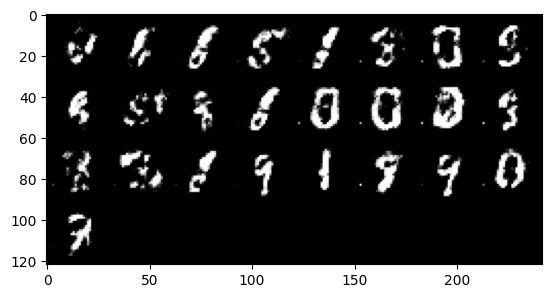

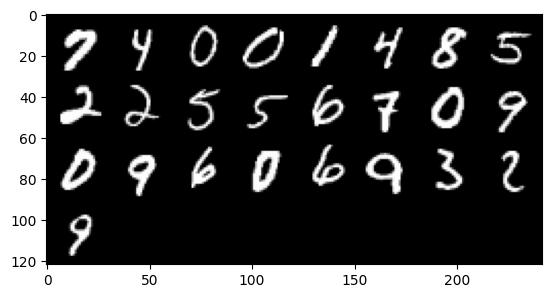

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77000: Generator loss: 1.3089128522872928, discriminator loss: 0.48070098459720595


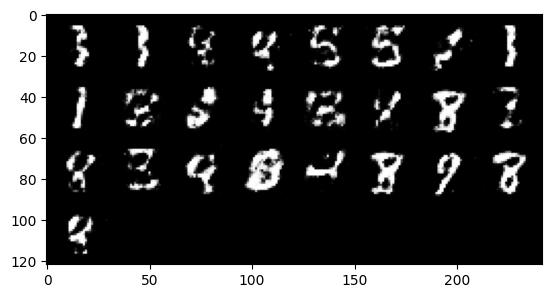

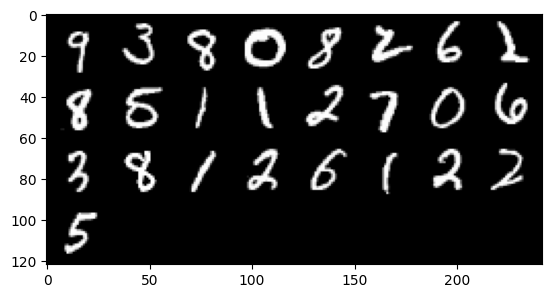

  0%|          | 0/469 [00:00<?, ?it/s]

Step 77500: Generator loss: 1.2702398622035995, discriminator loss: 0.48453961145877794


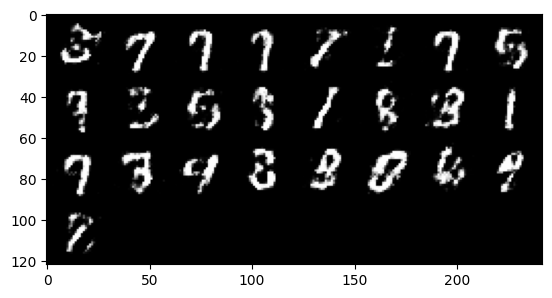

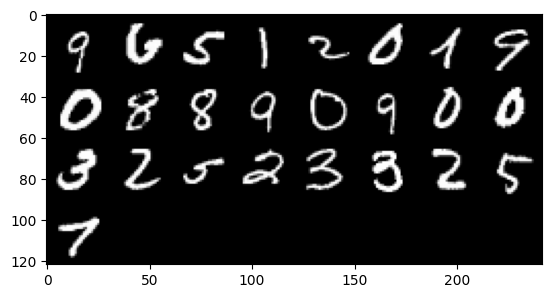

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78000: Generator loss: 1.3182016773223888, discriminator loss: 0.47821233141422276


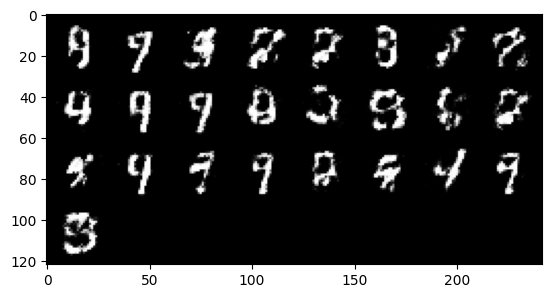

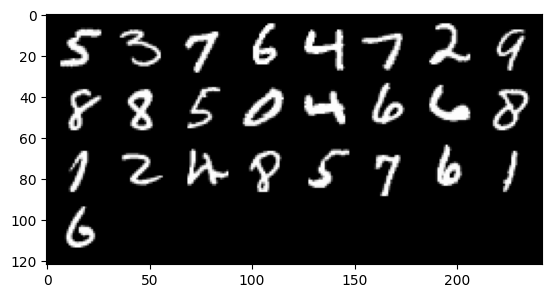

  0%|          | 0/469 [00:00<?, ?it/s]

Step 78500: Generator loss: 1.295149376869201, discriminator loss: 0.48026701569557195


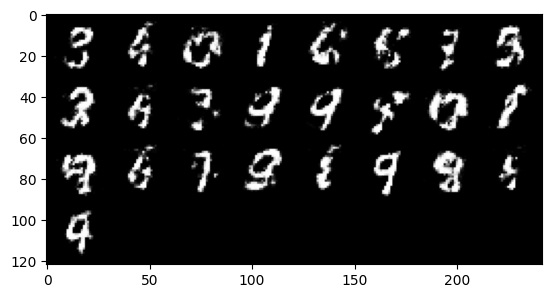

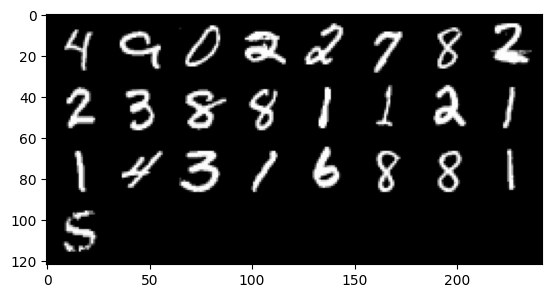

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79000: Generator loss: 1.2615524852275846, discriminator loss: 0.48878236556053145


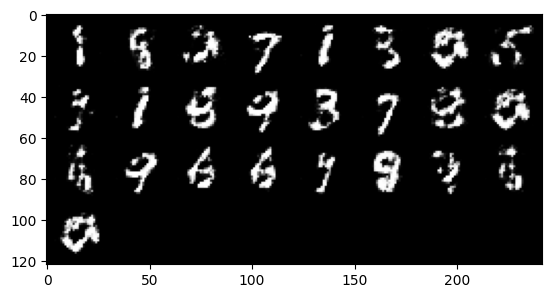

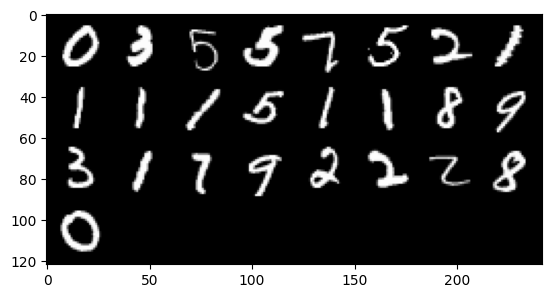

  0%|          | 0/469 [00:00<?, ?it/s]

Step 79500: Generator loss: 1.305957179546357, discriminator loss: 0.4740898896455766


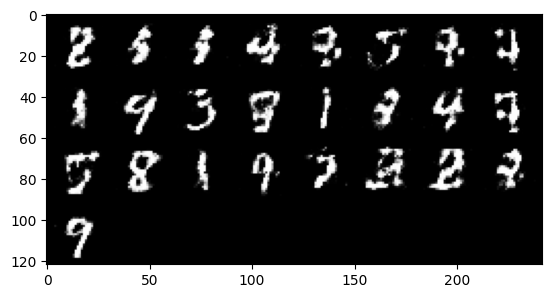

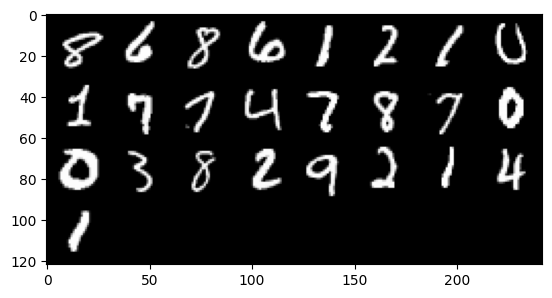

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80000: Generator loss: 1.2541192445754998, discriminator loss: 0.49559706515073726


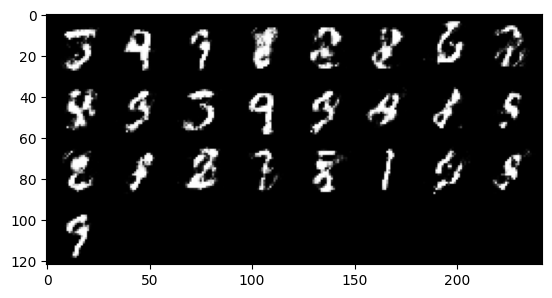

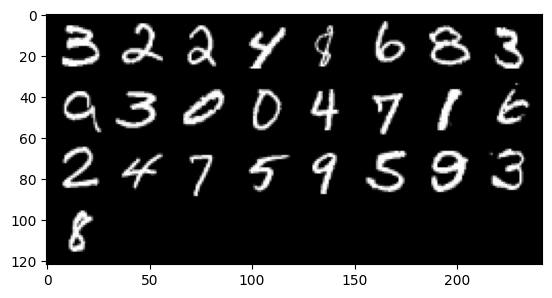

  0%|          | 0/469 [00:00<?, ?it/s]

Step 80500: Generator loss: 1.2825902587175362, discriminator loss: 0.4772138760089879


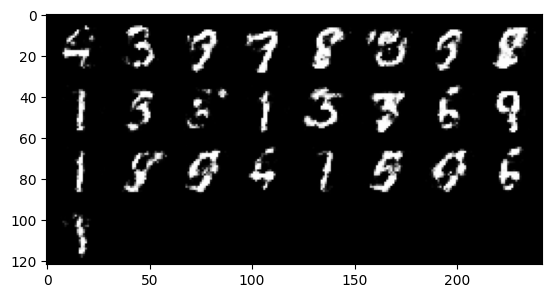

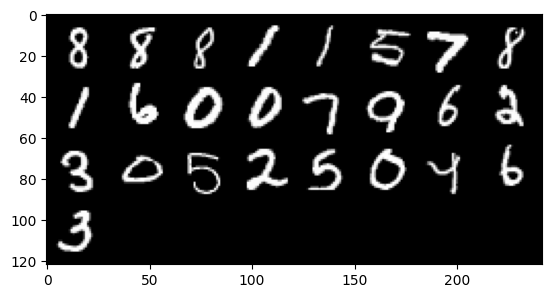

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81000: Generator loss: 1.2400298223495494, discriminator loss: 0.48889917337894473


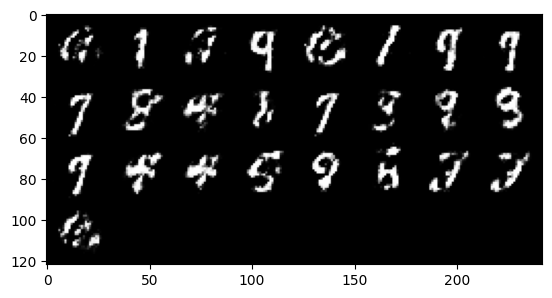

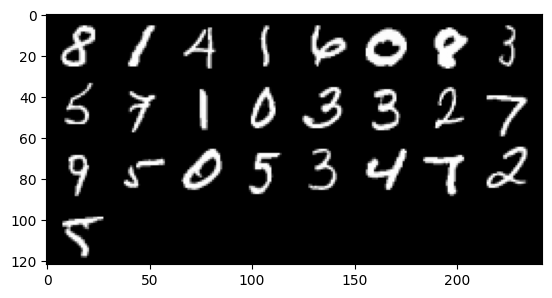

  0%|          | 0/469 [00:00<?, ?it/s]

Step 81500: Generator loss: 1.2621140642166127, discriminator loss: 0.4870949825644491


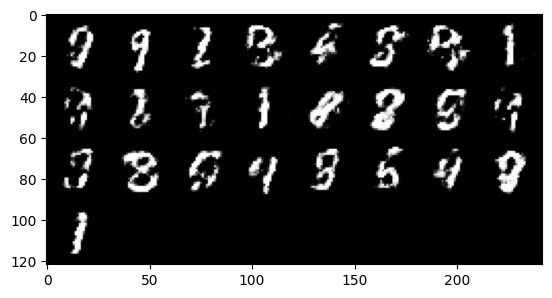

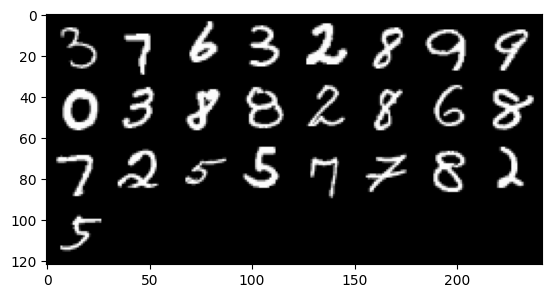

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82000: Generator loss: 1.2103126237392428, discriminator loss: 0.5029332571029661


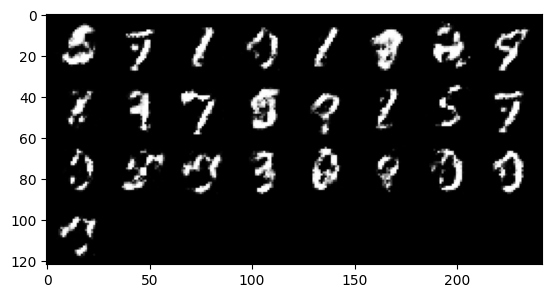

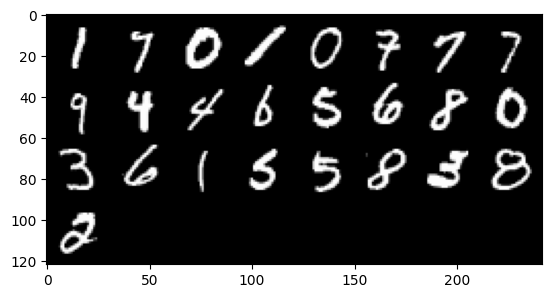

  0%|          | 0/469 [00:00<?, ?it/s]

Step 82500: Generator loss: 1.185844775915147, discriminator loss: 0.5086947737336156


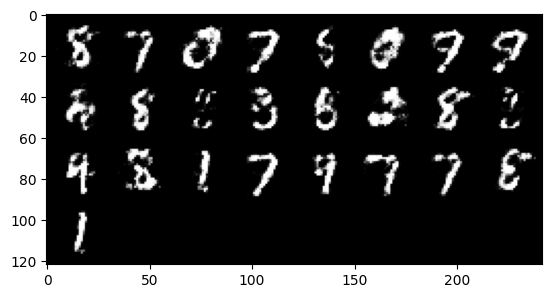

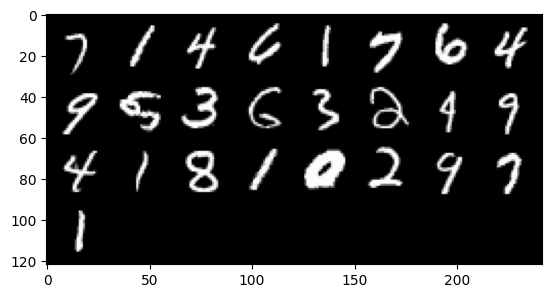

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83000: Generator loss: 1.1671903164386737, discriminator loss: 0.5040210270881654


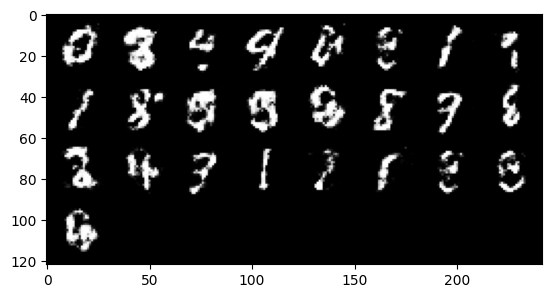

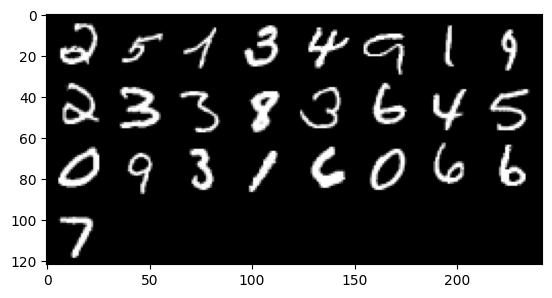

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 83500: Generator loss: 1.1493134868144983, discriminator loss: 0.5175133593082422


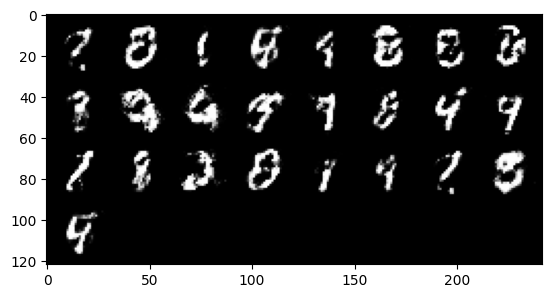

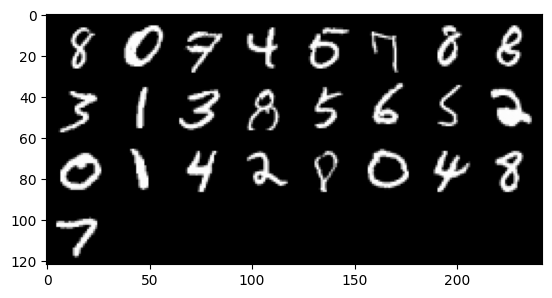

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84000: Generator loss: 1.1897915897369375, discriminator loss: 0.5067566252350805


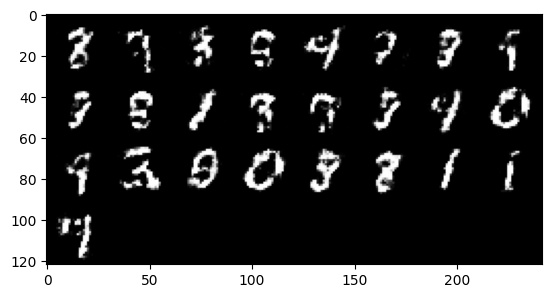

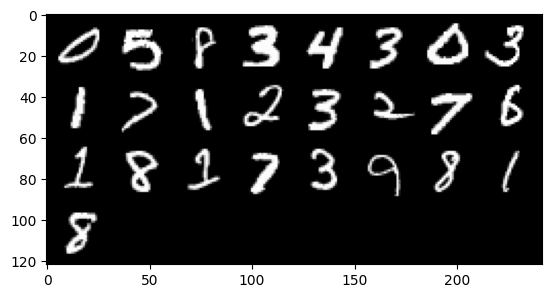

  0%|          | 0/469 [00:00<?, ?it/s]

Step 84500: Generator loss: 1.2065632287263863, discriminator loss: 0.504344140946865


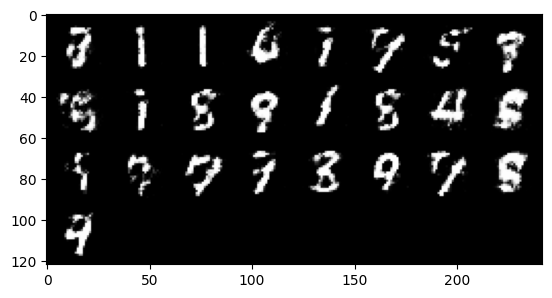

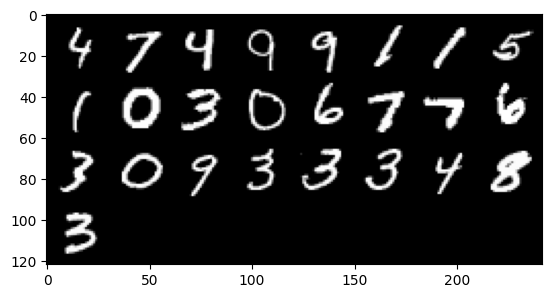

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85000: Generator loss: 1.205120406031608, discriminator loss: 0.5075142928957939


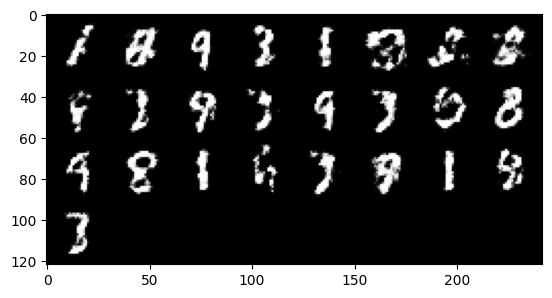

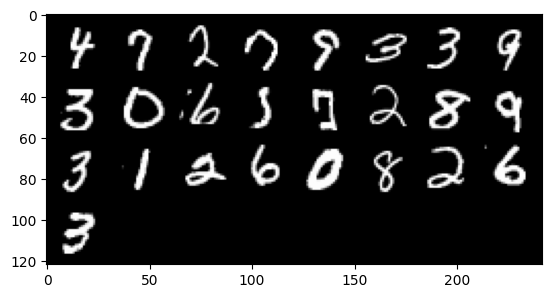

  0%|          | 0/469 [00:00<?, ?it/s]

Step 85500: Generator loss: 1.2842795298099523, discriminator loss: 0.46584068518877014


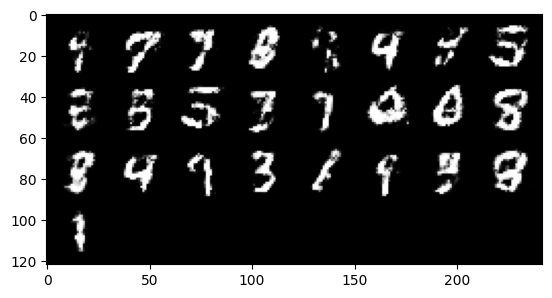

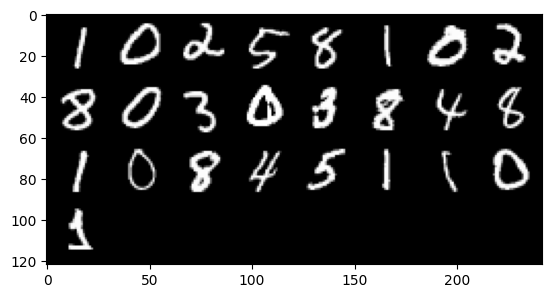

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86000: Generator loss: 1.142286580324174, discriminator loss: 0.5248424292206767


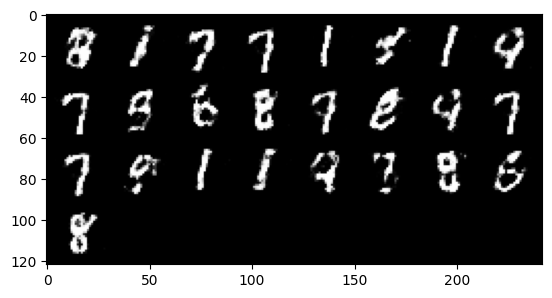

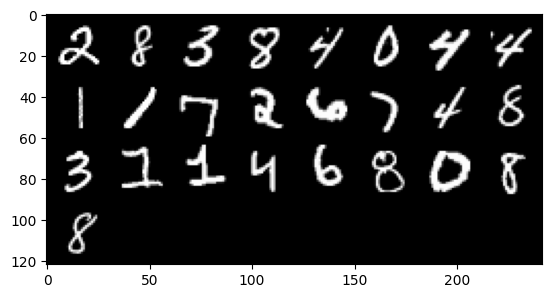

  0%|          | 0/469 [00:00<?, ?it/s]

Step 86500: Generator loss: 1.1189909791946406, discriminator loss: 0.5290657450556755


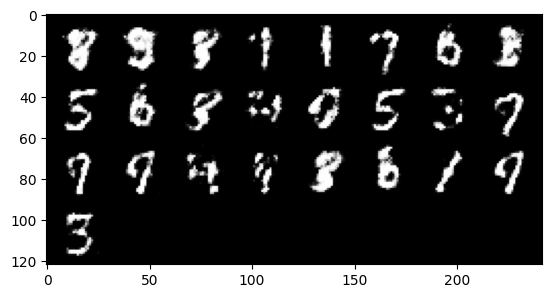

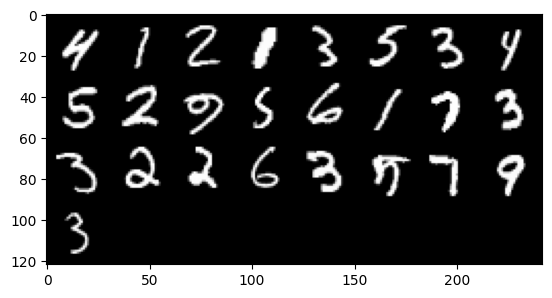

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87000: Generator loss: 1.0892126932144175, discriminator loss: 0.5346994620561597


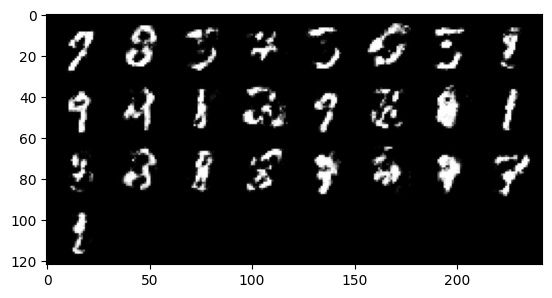

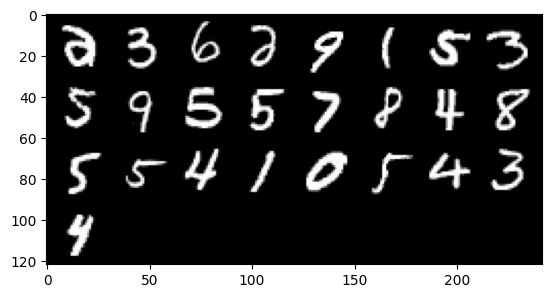

  0%|          | 0/469 [00:00<?, ?it/s]

Step 87500: Generator loss: 1.1415724748373024, discriminator loss: 0.5224400321841237


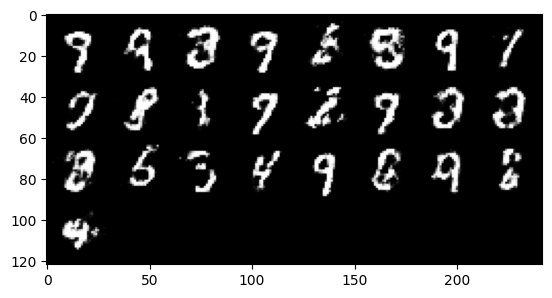

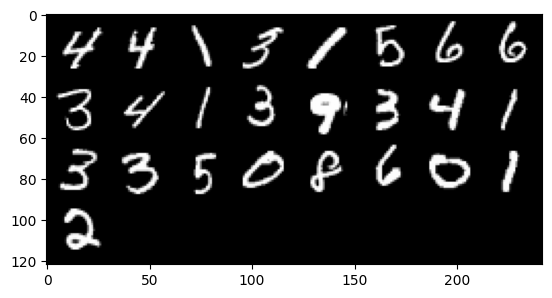

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88000: Generator loss: 1.1576017613410956, discriminator loss: 0.5186553341746327


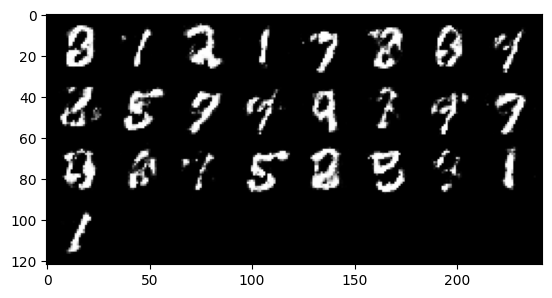

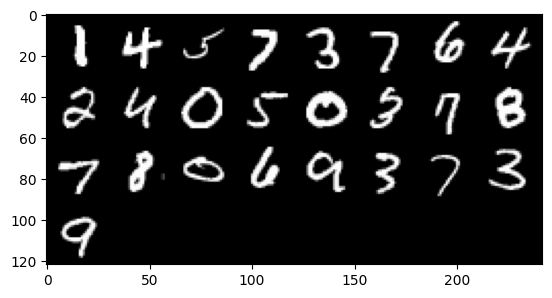

  0%|          | 0/469 [00:00<?, ?it/s]

Step 88500: Generator loss: 1.147643725514412, discriminator loss: 0.5183110354542735


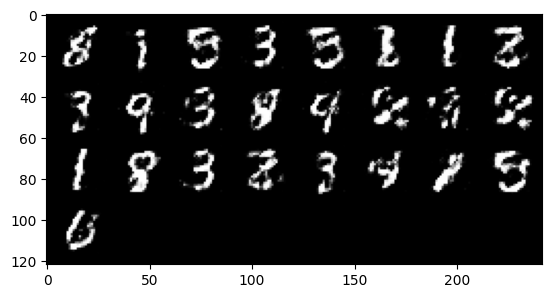

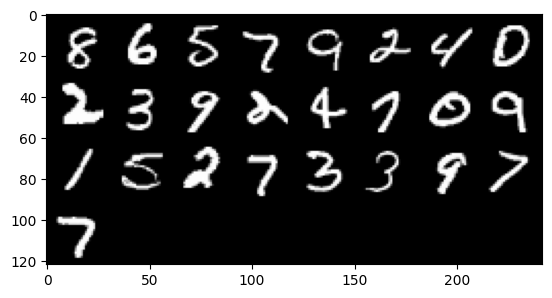

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89000: Generator loss: 1.1873408682346336, discriminator loss: 0.5059755089879037


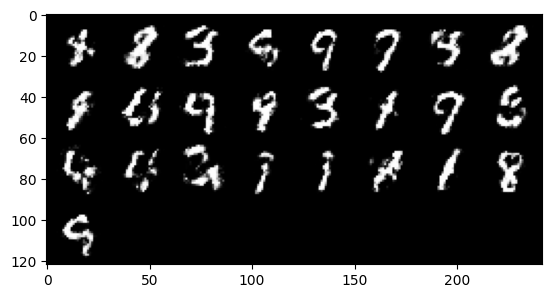

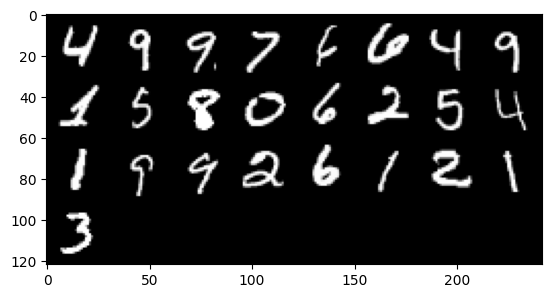

  0%|          | 0/469 [00:00<?, ?it/s]

Step 89500: Generator loss: 1.1571561592817297, discriminator loss: 0.5183504735827446


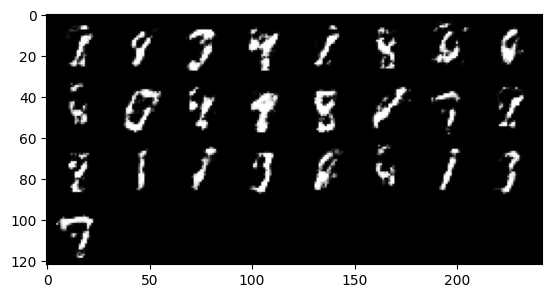

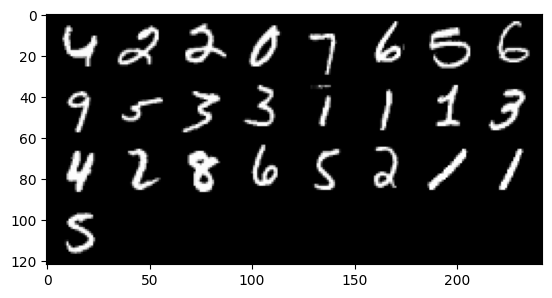

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90000: Generator loss: 1.096178260207175, discriminator loss: 0.5349195266962057


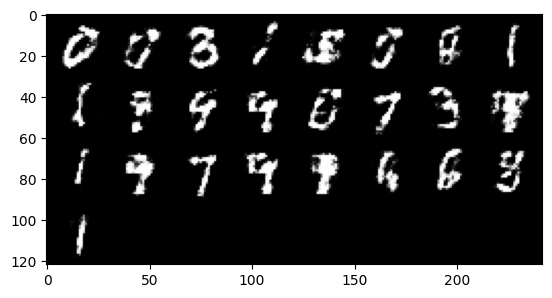

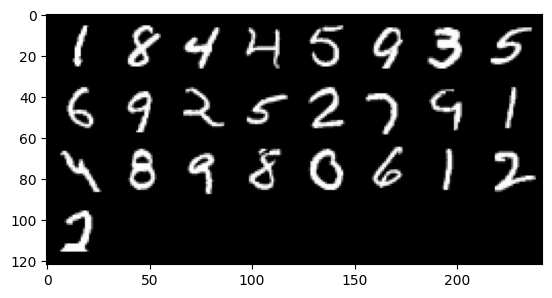

  0%|          | 0/469 [00:00<?, ?it/s]

Step 90500: Generator loss: 1.0604337654113771, discriminator loss: 0.5391997719407081


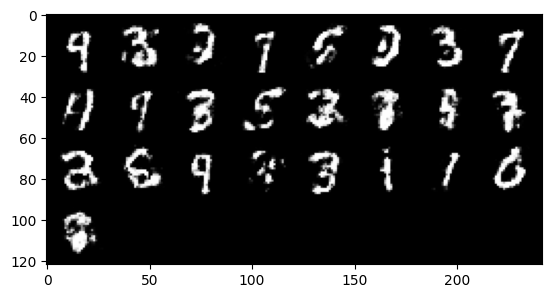

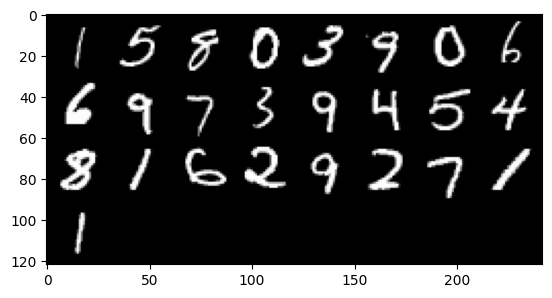

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91000: Generator loss: 1.1052847625017155, discriminator loss: 0.5340002222657202


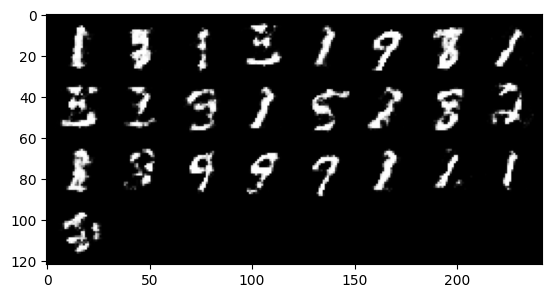

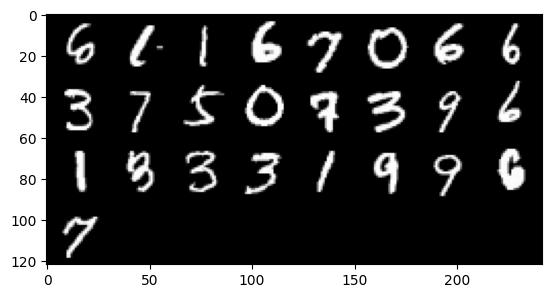

  0%|          | 0/469 [00:00<?, ?it/s]

Step 91500: Generator loss: 1.0723993407487862, discriminator loss: 0.54486501955986


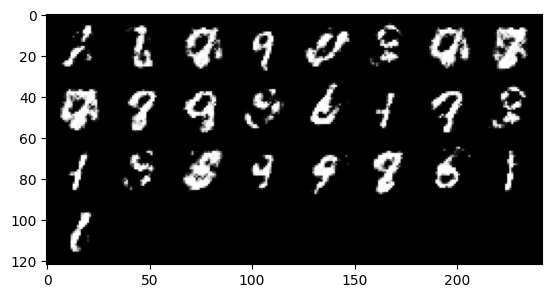

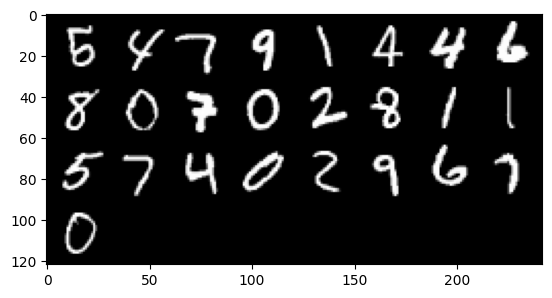

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92000: Generator loss: 1.082398280739784, discriminator loss: 0.5284741240143777


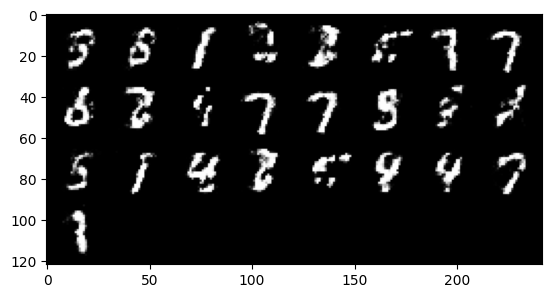

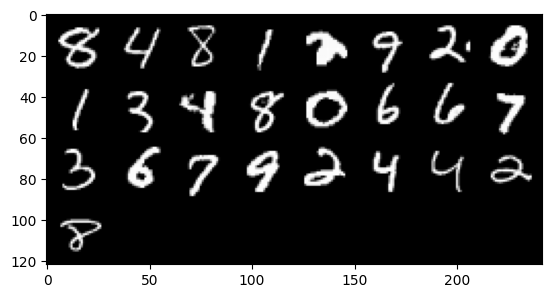

  0%|          | 0/469 [00:00<?, ?it/s]

Step 92500: Generator loss: 1.1033126798868167, discriminator loss: 0.5315575821399688


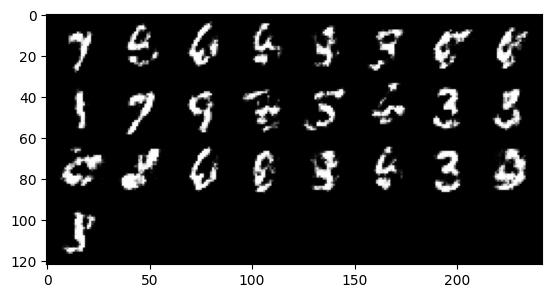

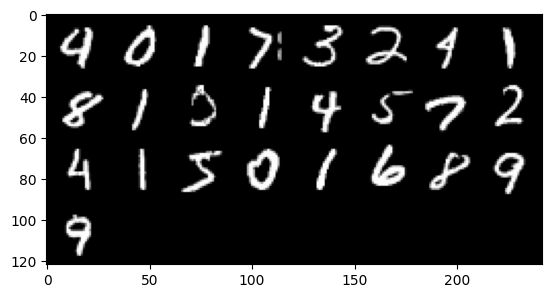

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93000: Generator loss: 1.1342976891994465, discriminator loss: 0.5197658551931383


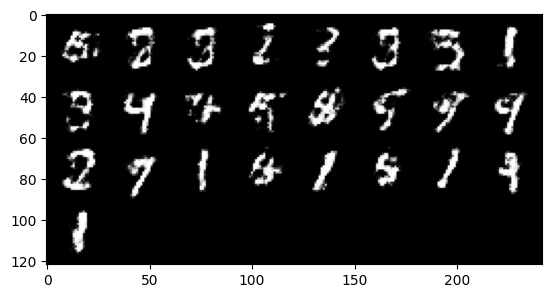

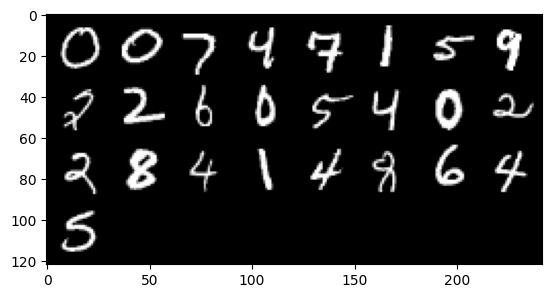

  0%|          | 0/469 [00:00<?, ?it/s]

Step 93500: Generator loss: 1.0776796479225155, discriminator loss: 0.5324390589594841


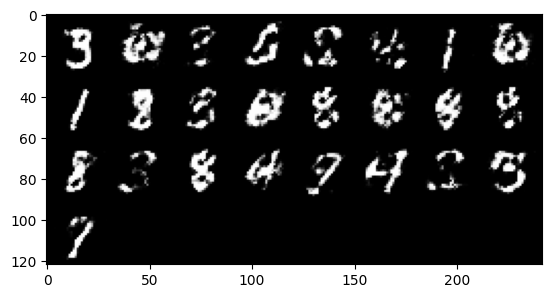

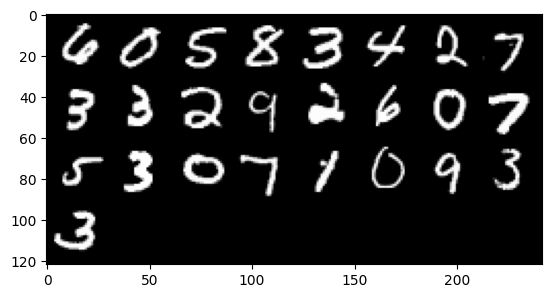

In [121]:
# OPTIONAL PART

cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
test_generator = True # Whether the generator should be tested
gen_loss = False
error = False
for epoch in range(n_epochs):
  
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        # For testing purposes, to keep track of the generator weights
        if test_generator:
            old_generator_weights = gen.gen[0][0].weight.detach().clone()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # For testing purposes, to check that your code changes the generator weights
        if test_generator:
            try:
                assert lr > 0.0000002 or (gen.gen[0][0].weight.grad.abs().max() < 0.0005 and epoch == 0)
                assert torch.any(gen.gen[0][0].weight.detach().clone() != old_generator_weights)
            except:
                error = True
                print("Runtime tests have failed")

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1


In [124]:
# z1 = get_noise(1, z_dim, device)
# z2 = get_noise(1, z_dim, device)

# # Interpolate between them
# num_steps = 10
# for i in range(num_steps + 1):
#     alpha = i / num_steps
#     z = z1 * (1 - alpha) + z2 * alpha
#     with torch.no_grad():
#         img = gen(z)
#     plt.imshow(img.cpu().view(28, 28).squeeze(), cmap='gray')
#     plt.axis('off')
#     plt.show()

# model.eval()